In [1]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Load the video file
video_path = r"C:\Users\kabir\Downloads\videoplayback.mp4"
cap = cv2.VideoCapture(video_path)

In [3]:
# Directory where extracted frames will be saved
output_dir = 'extracted_frames'
os.makedirs(output_dir, exist_ok=True)

# Frame extraction
frame_idx = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Save each frame as an image file
    frame_filename = os.path.join(output_dir, f'frame_{frame_idx:04d}.jpg')
    cv2.imwrite(frame_filename, frame)
    frame_idx += 1

# Release the video capture object
cap.release()
cv2.destroyAllWindows()

print(f"Extraction complete! {frame_idx} frames saved to '{output_dir}'")

Extraction complete! 266 frames saved to 'extracted_frames'


In [5]:
import cv2
import numpy as np
import os

cap = cv2.VideoCapture(video_path)

# Define the color range in HSV for segmentation
lower_color = np.array([10, 50, 50])   # Adjust lower bound for more precision
upper_color = np.array([240, 255, 255]) # Adjust upper bound for more precision

frame_idx = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert the frame to HSV color space
    hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    
    # Apply Gaussian Blur to reduce noise before color thresholding
    blurred_hsv_frame = cv2.GaussianBlur(hsv_frame, (11, 11), 0)
    
    # Apply color thresholding on the blurred frame
    mask = cv2.inRange(blurred_hsv_frame, lower_color, upper_color)
    
    # Improve mask using morphological operations
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    
    # Use the mask to extract the color-segmented image
    color_segmented_frame = cv2.bitwise_and(frame, frame, mask=mask)
    
    # Apply Sobel Edge Detection as in the previous example
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    sobel_x = cv2.Sobel(gray_frame, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_frame, cv2.CV_64F, 0, 1, ksize=3)
    sobel_edges = cv2.magnitude(sobel_x, sobel_y)
    sobel_edges = cv2.convertScaleAbs(sobel_edges)
    
    # Save the processed frames
    color_segmented_filename = os.path.join(output_dir, f'color_segmented_{frame_idx:04d}.jpg')
    edges_filename = os.path.join(output_dir, f'edges_{frame_idx:04d}.jpg')

    cv2.imwrite(color_segmented_filename, color_segmented_frame)
    cv2.imwrite(edges_filename, sobel_edges)
    
    # Display the results for verification 
    cv2.imshow('Optimized Color Segmentation', color_segmented_frame)
    cv2.imshow('Sobel Edge Detection', sobel_edges)
    
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Segmentation complete! {frame_idx} frames processed and saved in '{output_dir}'")


Segmentation complete! 266 frames processed and saved in 'extracted_frames'


In [7]:
# Load the video
cap = cv2.VideoCapture(video_path)

# Function to calculate the centroid of contours
def calculate_centroid(contour):
    M = cv2.moments(contour)
    if M["m00"] != 0:
        cX = int(M["m10"] / M["m00"])
        cY = int(M["m01"] / M["m00"])
        return (cX, cY)
    else:
        return None

# Variables to store previous frame's centroids
previous_centroids = []

frame_idx = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert the frame to HSV for color thresholding
    hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    
    # Apply color thresholding
    mask = cv2.inRange(hsv_frame, lower_color, upper_color)
    
    # Find contours from the masked image
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Initialize an empty list to store current frame's centroids
    current_centroids = []

    # Draw contours and calculate centroids
    for contour in contours:
        if cv2.contourArea(contour) > 500:  # Filter small objects by area
            # Draw the contour
            cv2.drawContours(frame, [contour], -1, (0, 255, 0), 2)
            
            # Calculate and draw the centroid
            centroid = calculate_centroid(contour)
            if centroid:
                current_centroids.append(centroid)
                cv2.circle(frame, centroid, 5, (0, 0, 255), -1)

    # Track motion by drawing lines between previous and current centroids
    for i, current_centroid in enumerate(current_centroids):
        if i < len(previous_centroids):
            cv2.line(frame, previous_centroids[i], current_centroid, (255, 0, 0), 2)

    # Display the tracking result
    cv2.imshow('Object Tracking', frame)

    # Store the current centroids for the next frame
    previous_centroids = current_centroids.copy()

    # Break loop if 'q' is pressed
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Tracking complete! Processed {frame_idx} frames.")


Tracking complete! Processed 266 frames.


In [9]:
# Load the video
cap = cv2.VideoCapture(video_path)

# Create Background Subtractor object (MOG2 algorithm)
background_subtractor = cv2.createBackgroundSubtractorMOG2(history=500, varThreshold=16, detectShadows=True)

# Parameters
frame_idx = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Apply the background subtractor to get the foreground mask
    foreground_mask = background_subtractor.apply(frame)

    # Optional: Remove shadows (MOG2 marks shadows with lower intensity values, you can threshold to remove them)
    _, foreground_mask_no_shadows = cv2.threshold(foreground_mask, 200, 255, cv2.THRESH_BINARY)

    # Apply the mask to the frame to extract the foreground objects
    foreground = cv2.bitwise_and(frame, frame, mask=foreground_mask_no_shadows)

    # Display the original frame, foreground mask, and the extracted foreground
    cv2.imshow('Original Frame', frame)
    cv2.imshow('Foreground Mask', foreground_mask)
    cv2.imshow('Foreground (No Shadows)', foreground)

    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Segmentation complete! Processed {frame_idx} frames.")


Segmentation complete! Processed 266 frames.


In [11]:
cap = cv2.VideoCapture(video_path)

# Thresholds for soft transition and hard cut detection
soft_transition_threshold_low = 0.60
soft_transition_threshold_high = 0.70
hard_cut_threshold = 0.40

frame_idx = 0
previous_frame_gray = None
previous_hist = None

# Histogram calculation function
def calculate_histogram(frame):
    hist = cv2.calcHist([frame], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
    return cv2.normalize(hist, hist).flatten()

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convert to grayscale
    current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    if previous_frame_gray is not None:
        # Pixel-based comparison
        pixel_diff = cv2.absdiff(previous_frame_gray, current_frame_gray)
        pixel_diff_sum = np.sum(pixel_diff)

        # Check if pixel difference suggests a scene change
        if pixel_diff_sum > 5000:
            # Calculate color histograms for further verification
            if previous_hist is None:
                previous_hist = calculate_histogram(previous_frame_color)
            current_hist = calculate_histogram(frame)
            
            # Histogram comparison
            hist_diff = cv2.compareHist(previous_hist, current_hist, cv2.HISTCMP_CORREL)
            
            # Hard cut detection
            if hist_diff <= hard_cut_threshold:
                print(f"Hard cut detected at frame {frame_idx} (Histogram-based)")
            # Soft transition detection
            elif soft_transition_threshold_low <= hist_diff <= soft_transition_threshold_high:
                print(f"Soft transition detected at frame {frame_idx} (Histogram-based)")
            
            # Update histogram for the next iteration
            previous_hist = current_hist

    # Show frame (optional)
    cv2.imshow('Frame', frame)

    # Update previous frames
    previous_frame_gray = current_frame_gray
    previous_frame_color = frame.copy()

    # Press 'q' to quit
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

# Release video capture object and close windows
cap.release()
cv2.destroyAllWindows()

print(f"Scene transition detection complete! Processed {frame_idx} frames.")


Hard cut detected at frame 251 (Histogram-based)
Scene transition detection complete! Processed 266 frames.


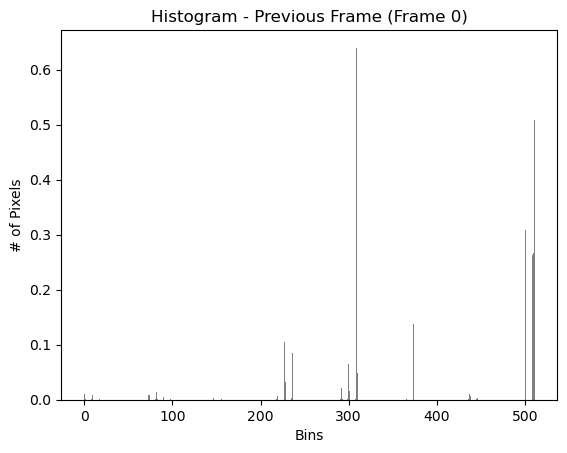

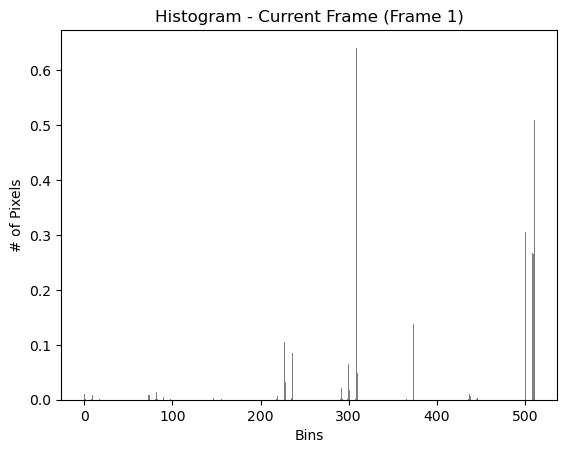

Hard cut detected at frame 2 (Pixel-based)


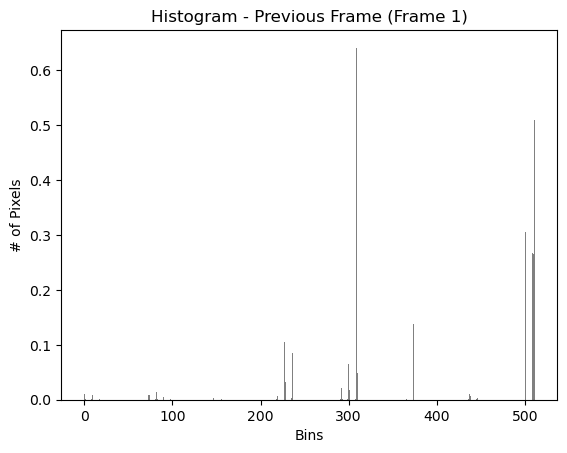

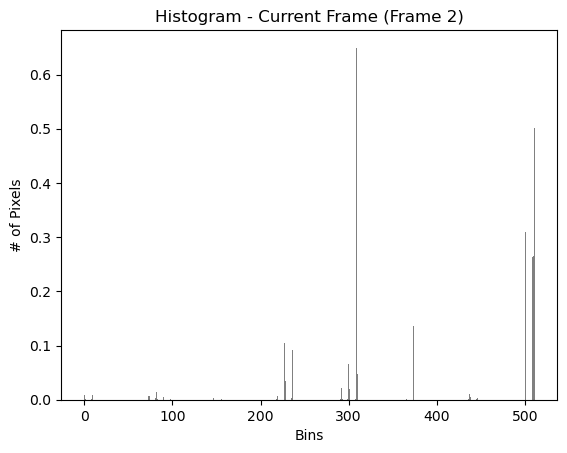

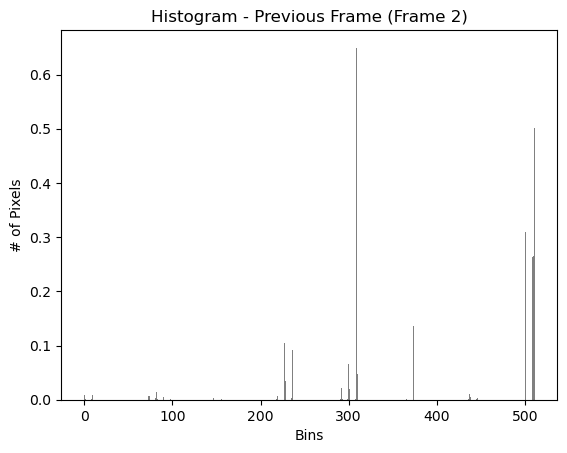

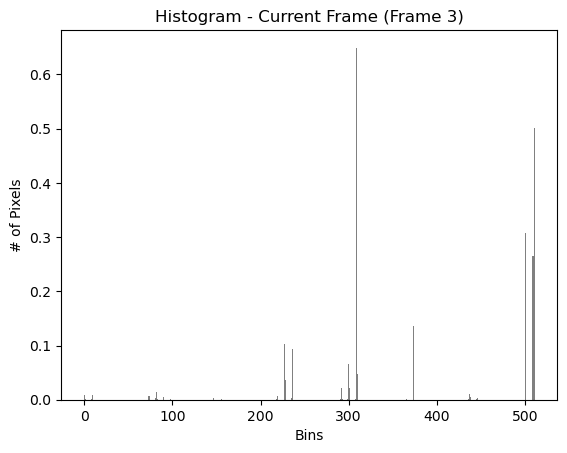

Hard cut detected at frame 4 (Pixel-based)


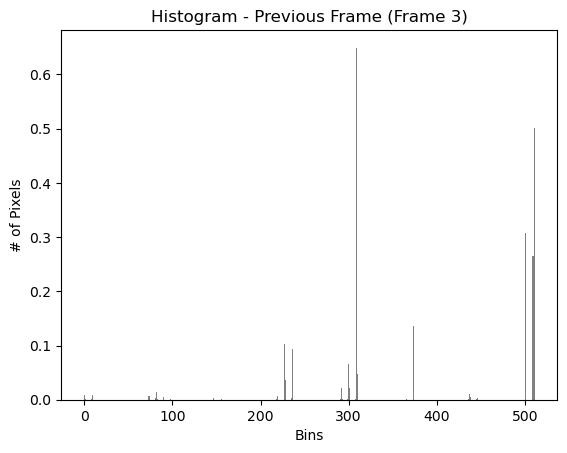

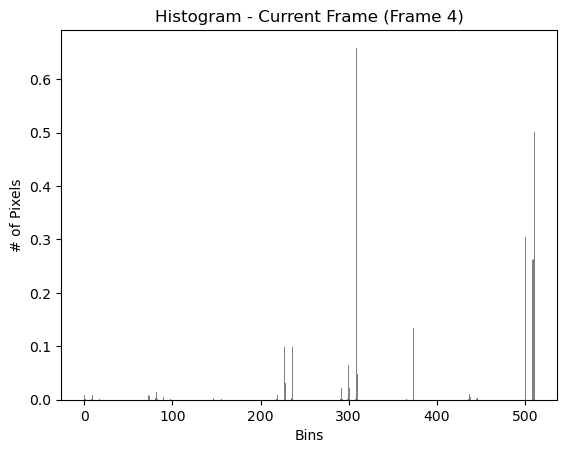

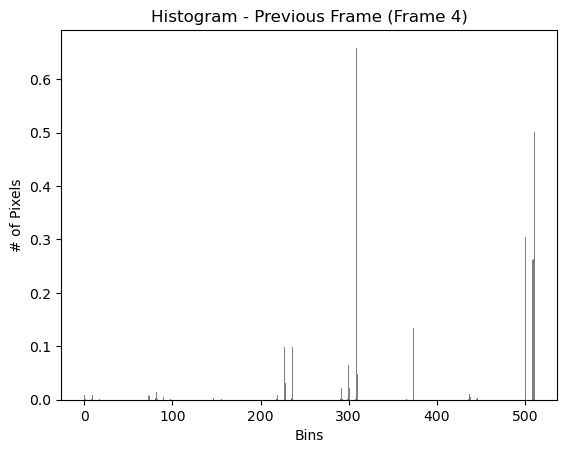

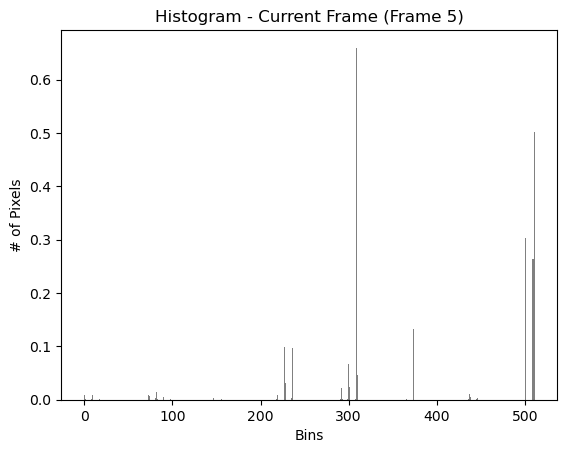

Hard cut detected at frame 6 (Pixel-based)


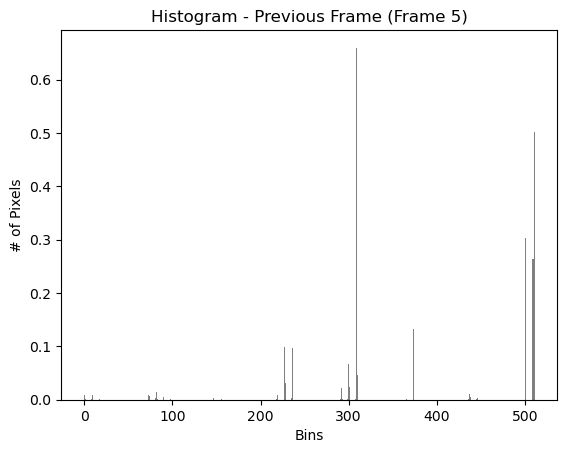

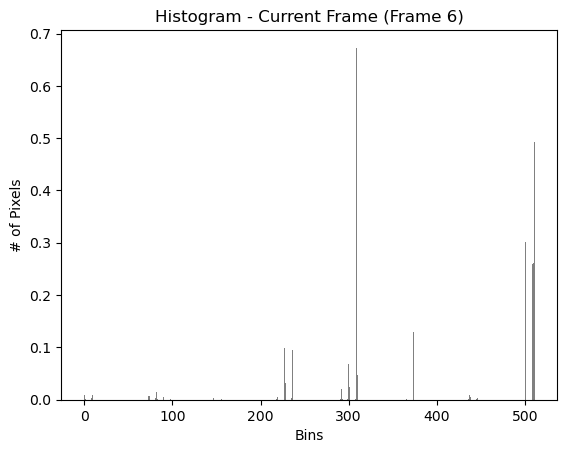

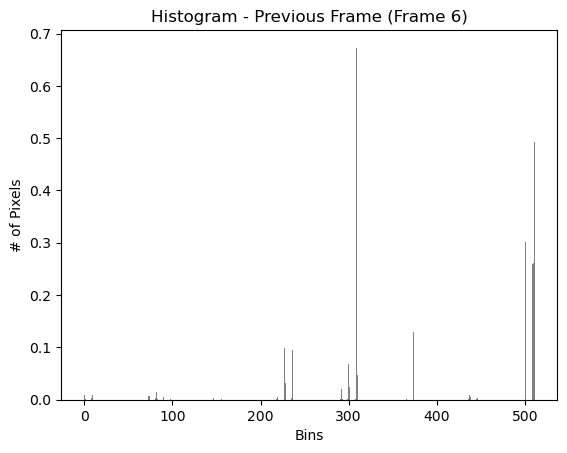

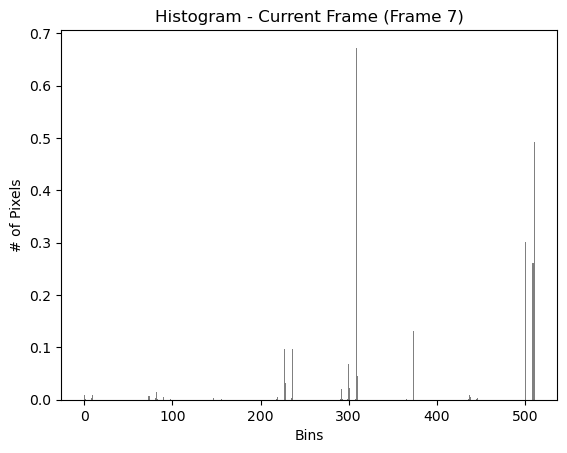

Hard cut detected at frame 8 (Pixel-based)


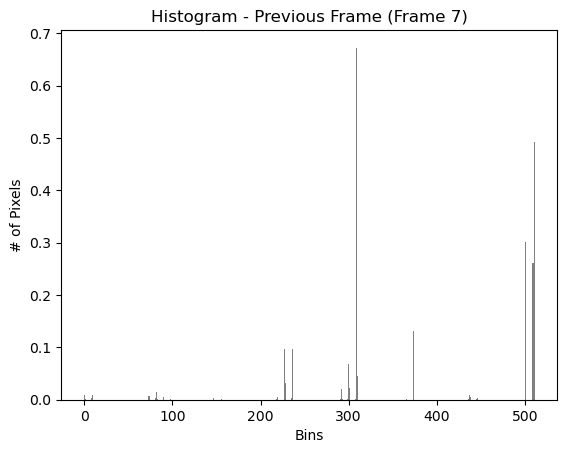

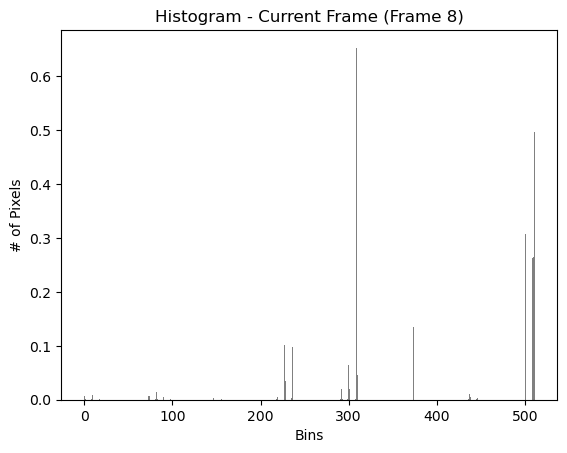

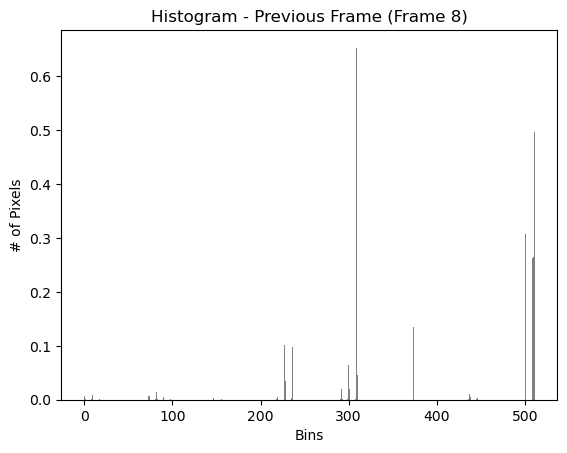

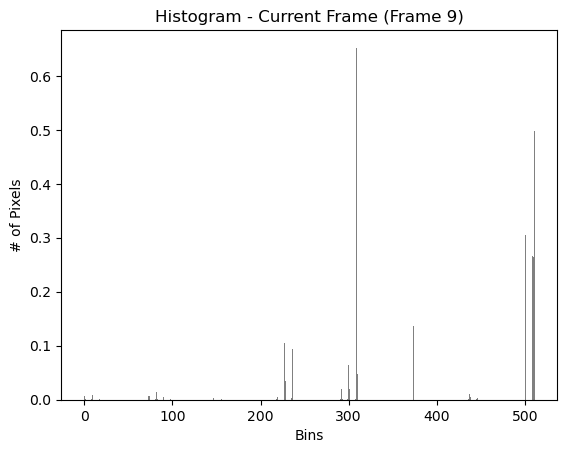

Hard cut detected at frame 10 (Pixel-based)


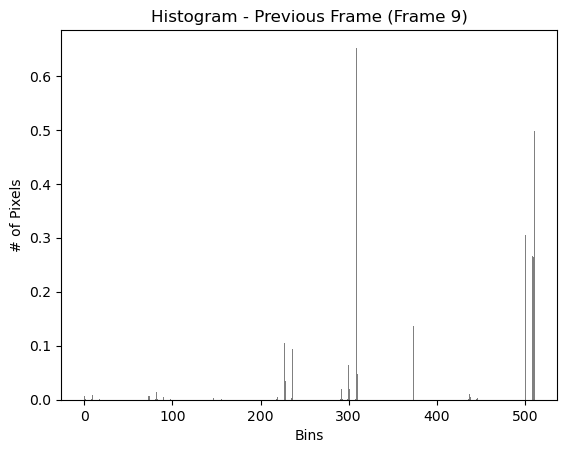

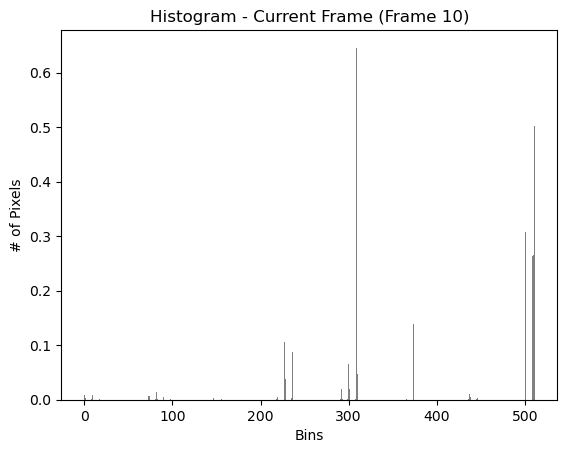

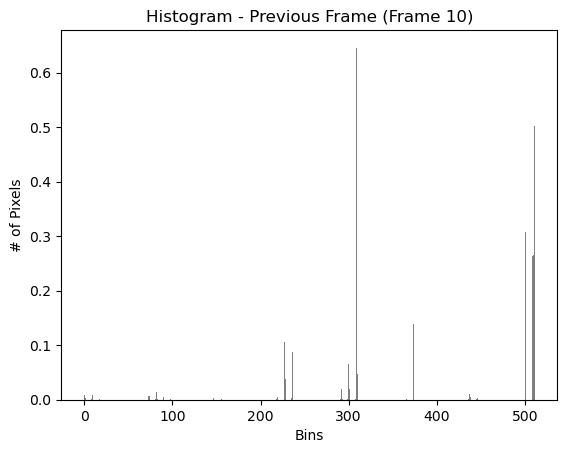

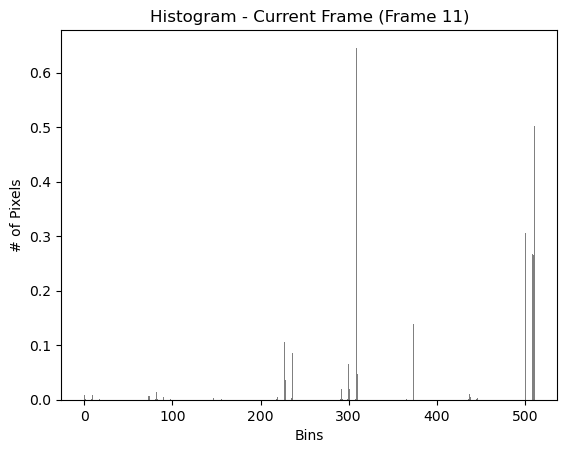

Hard cut detected at frame 12 (Pixel-based)


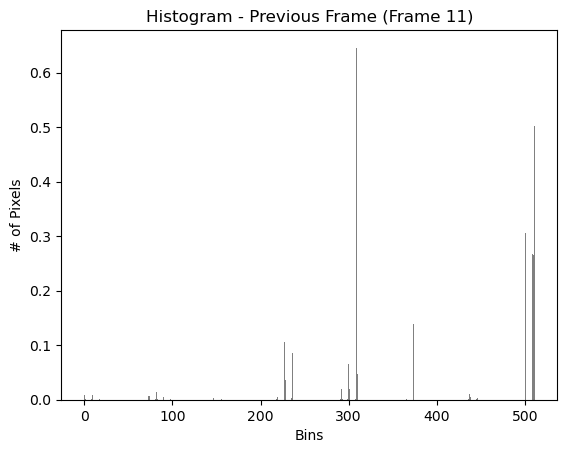

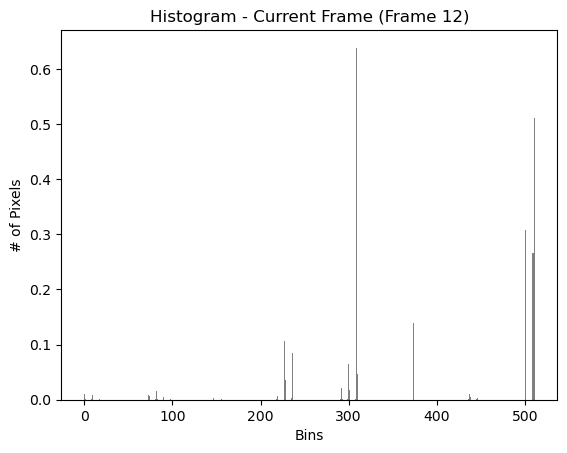

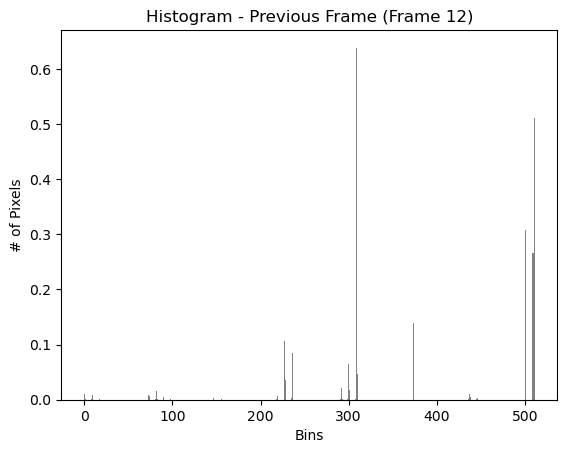

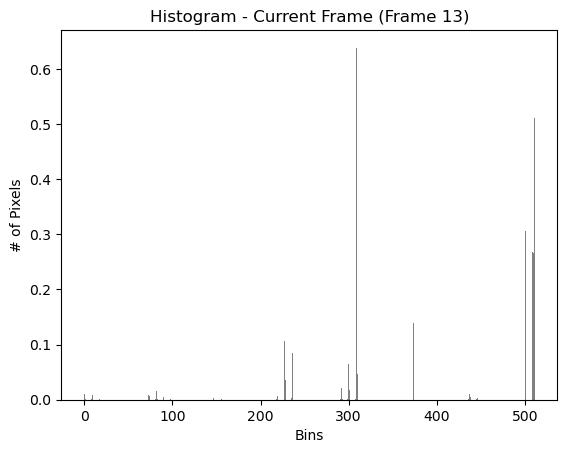

Hard cut detected at frame 14 (Pixel-based)


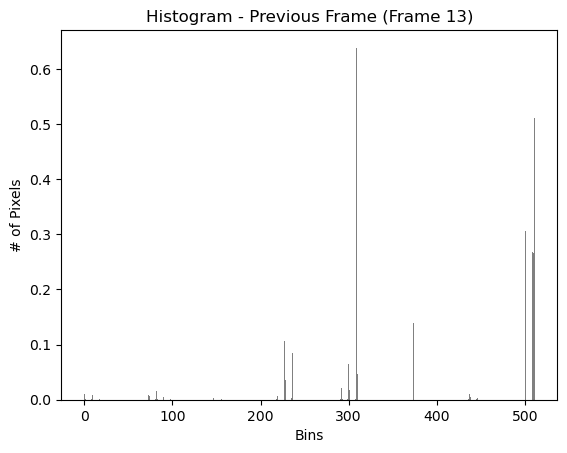

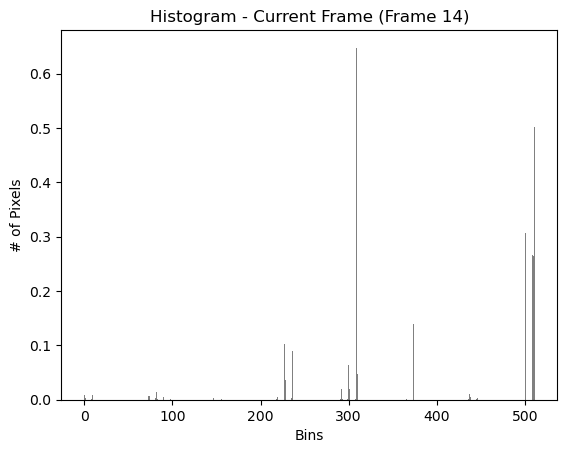

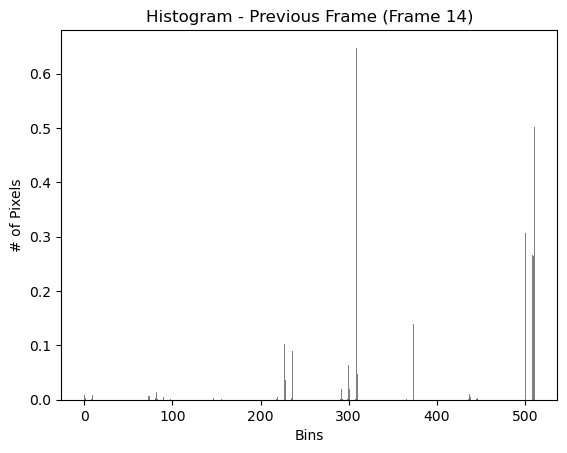

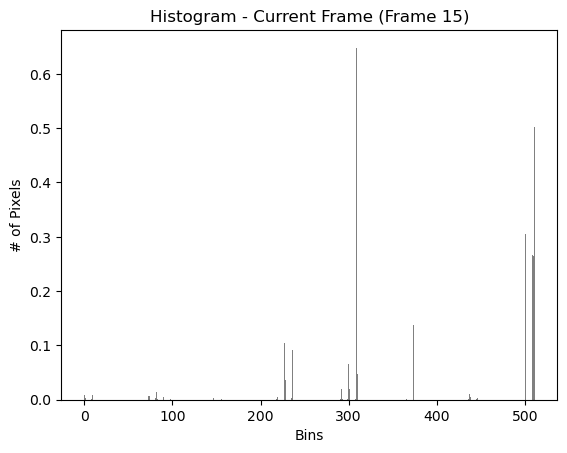

Hard cut detected at frame 16 (Pixel-based)


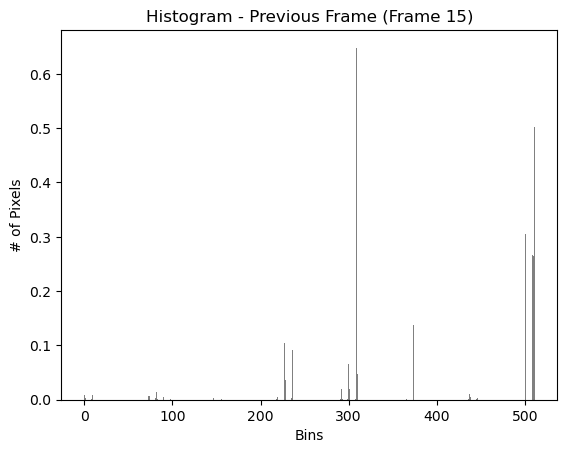

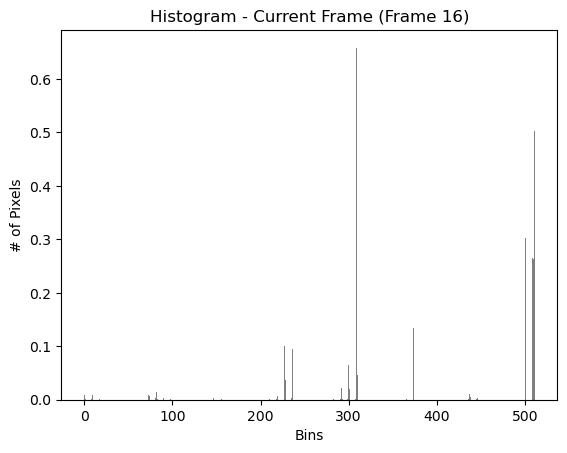

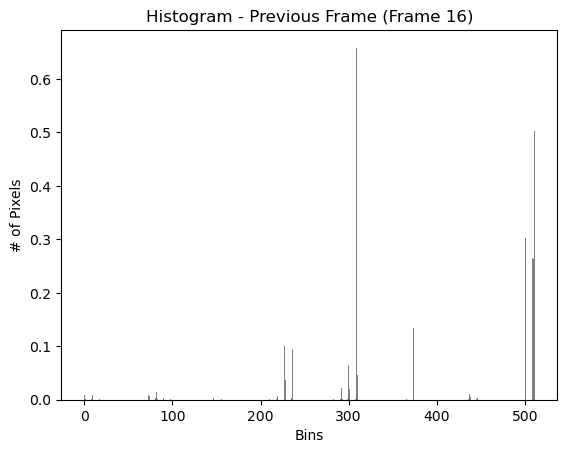

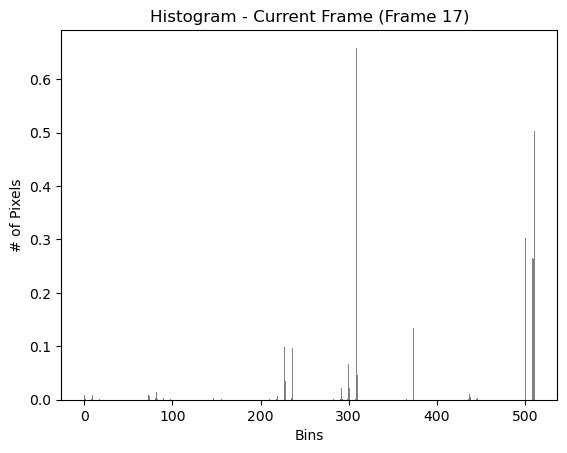

Hard cut detected at frame 18 (Pixel-based)


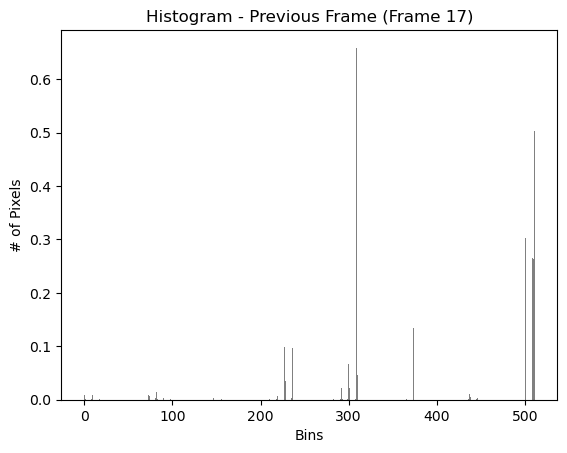

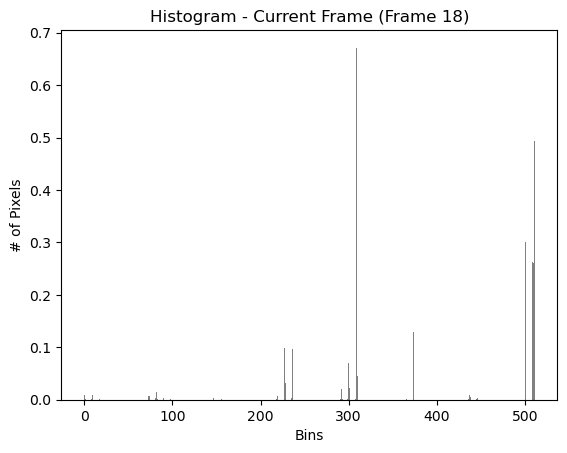

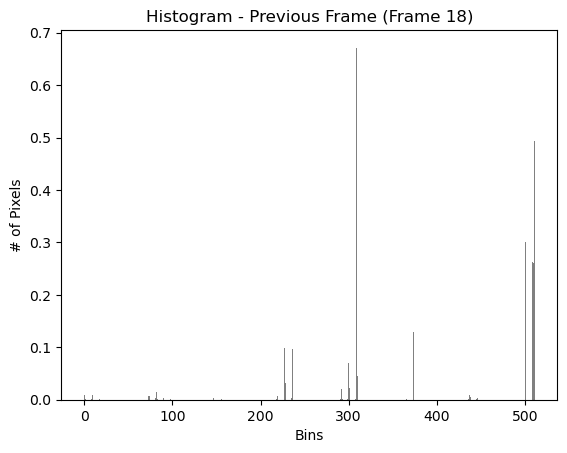

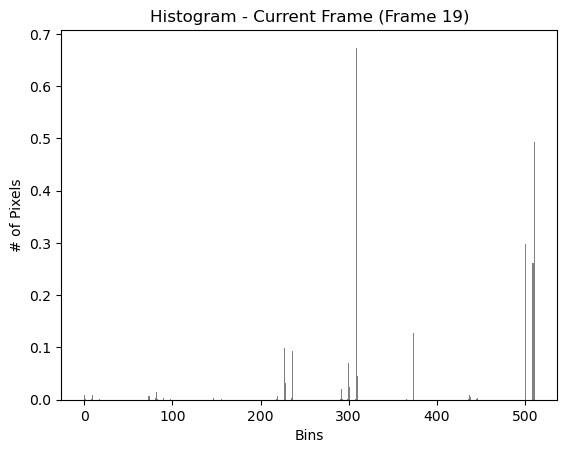

Hard cut detected at frame 20 (Pixel-based)


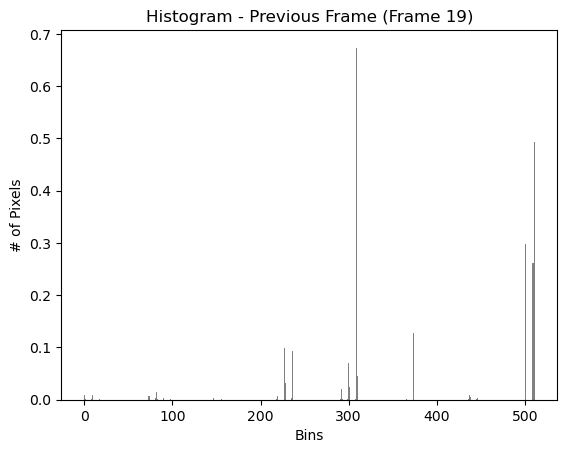

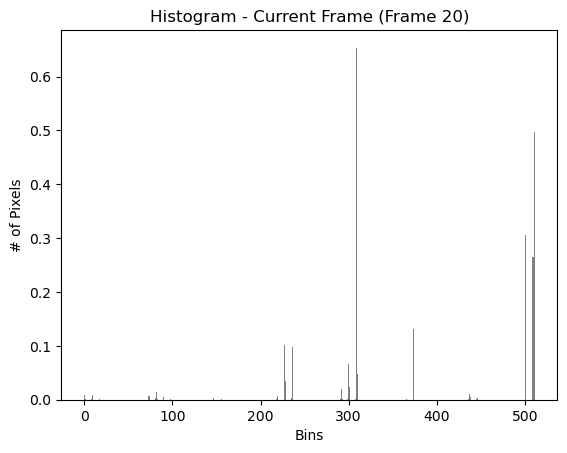

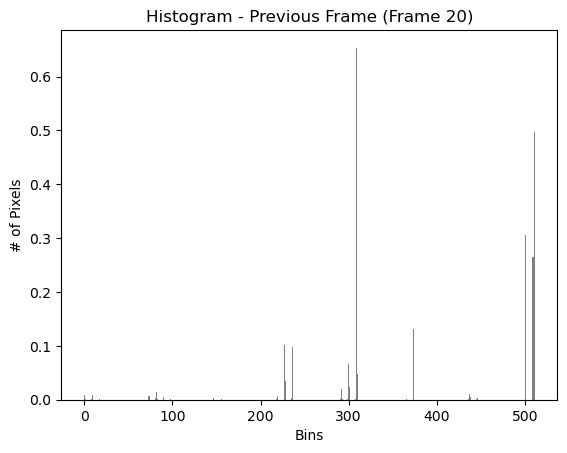

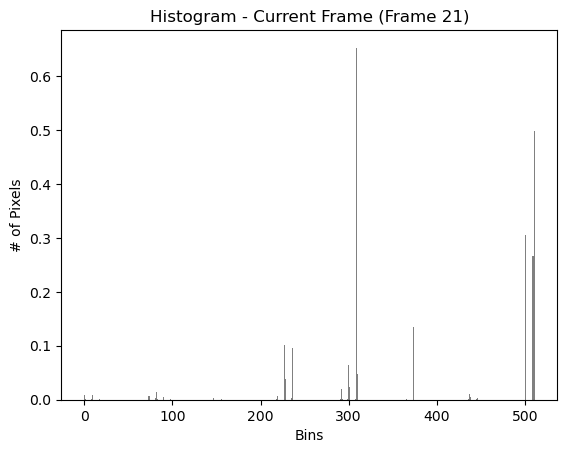

Hard cut detected at frame 22 (Pixel-based)


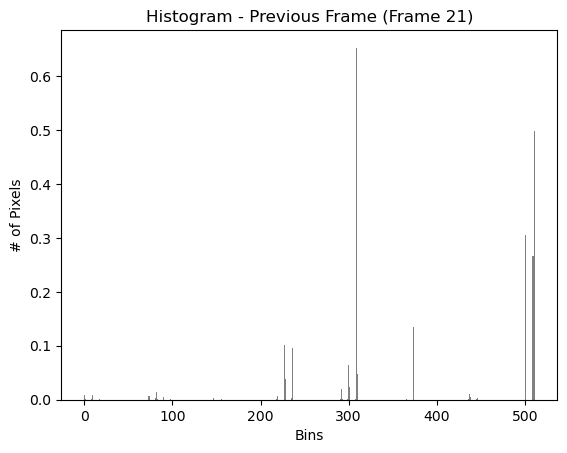

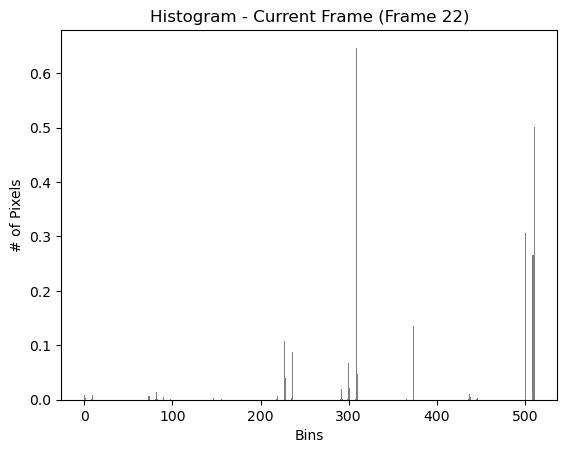

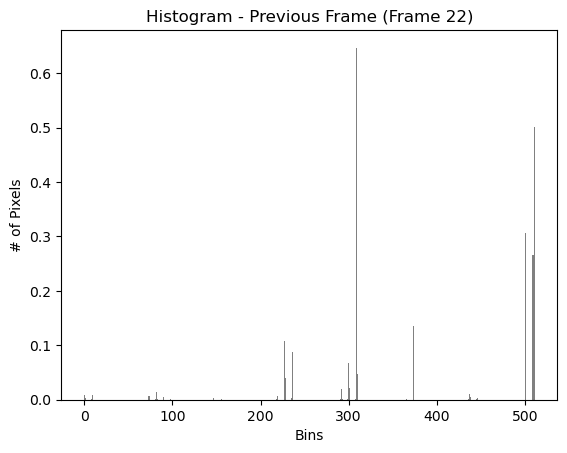

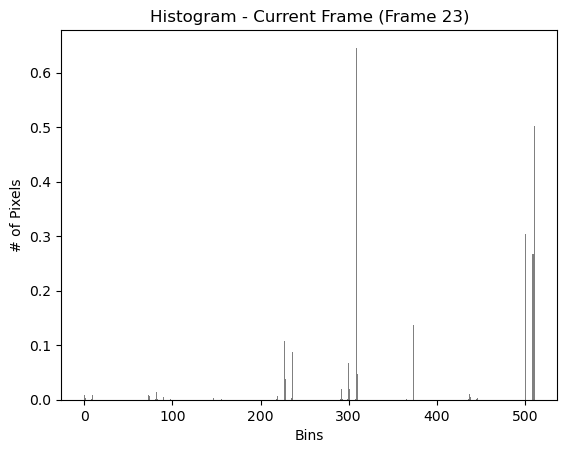

Hard cut detected at frame 24 (Pixel-based)


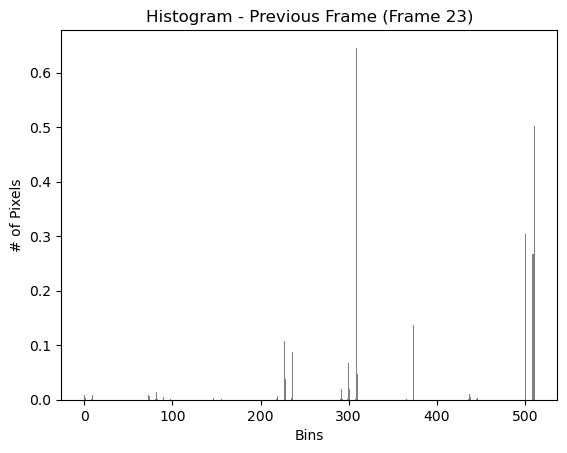

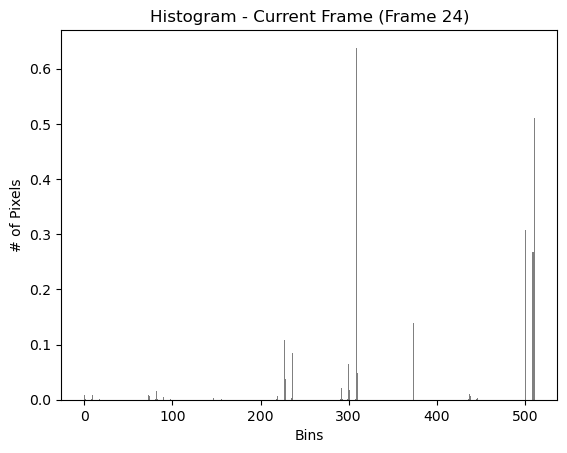

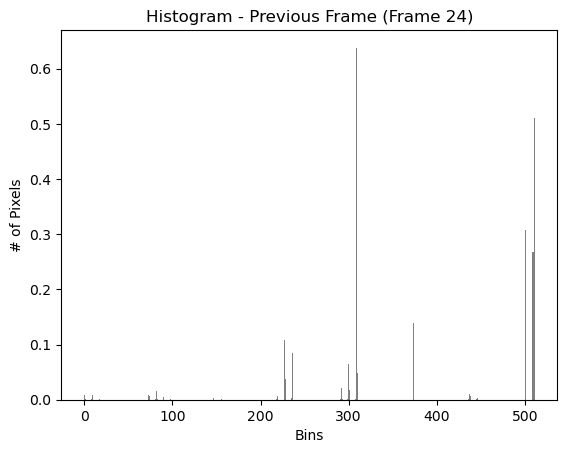

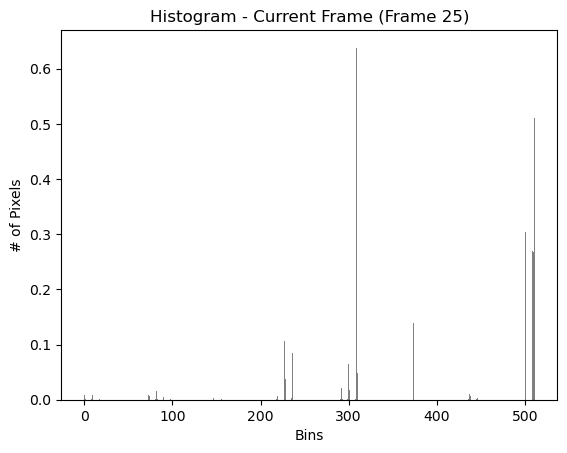

Hard cut detected at frame 26 (Pixel-based)


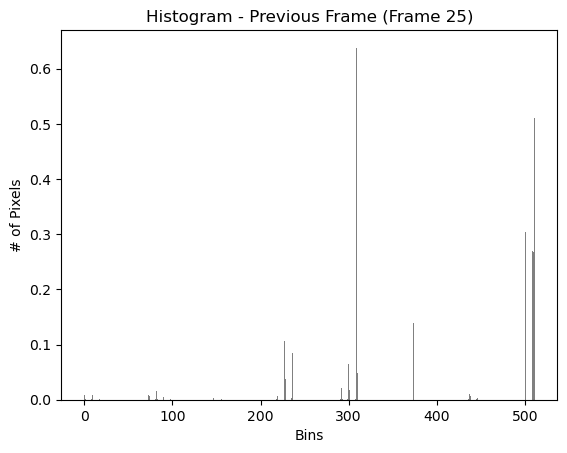

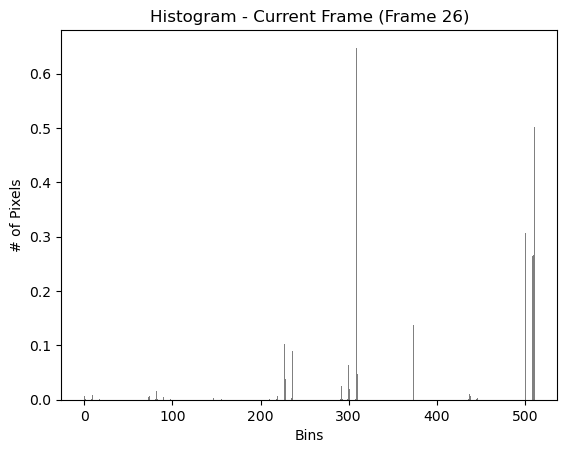

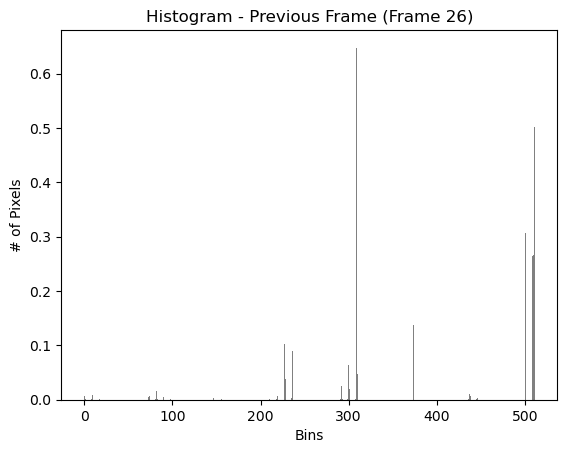

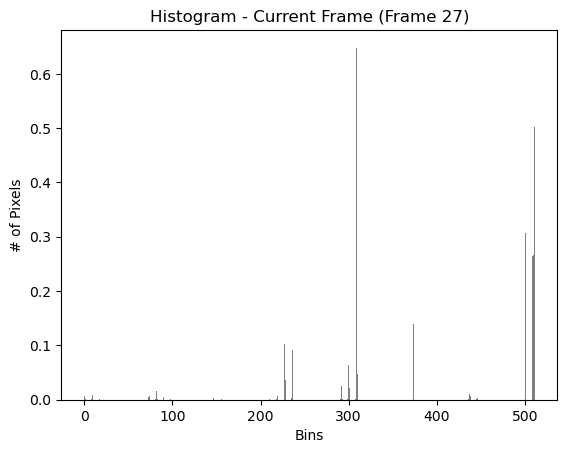

Hard cut detected at frame 28 (Pixel-based)


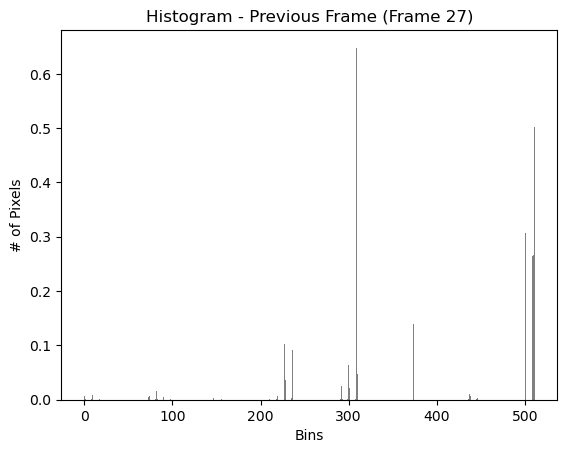

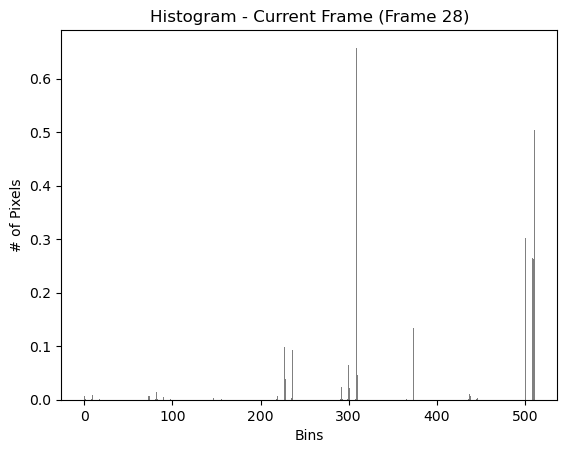

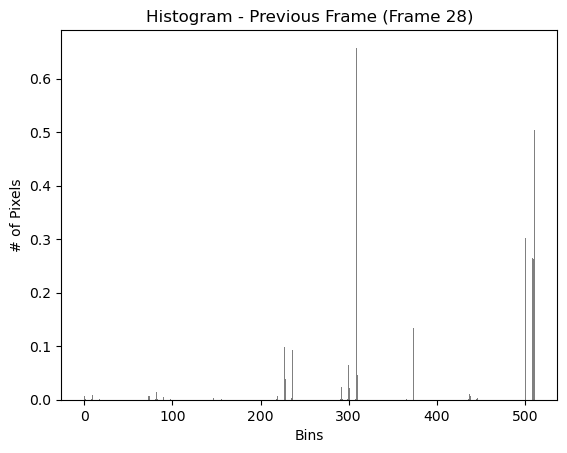

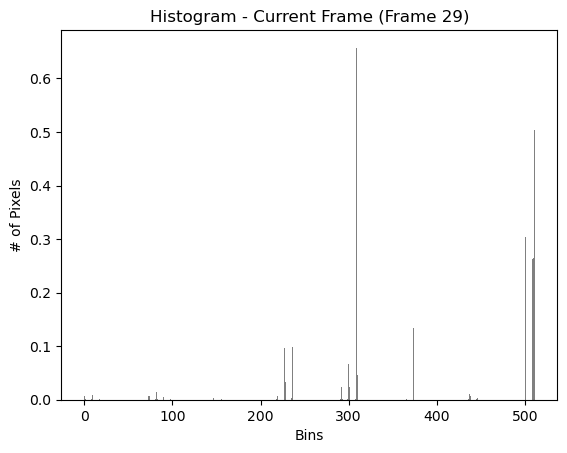

Hard cut detected at frame 30 (Pixel-based)


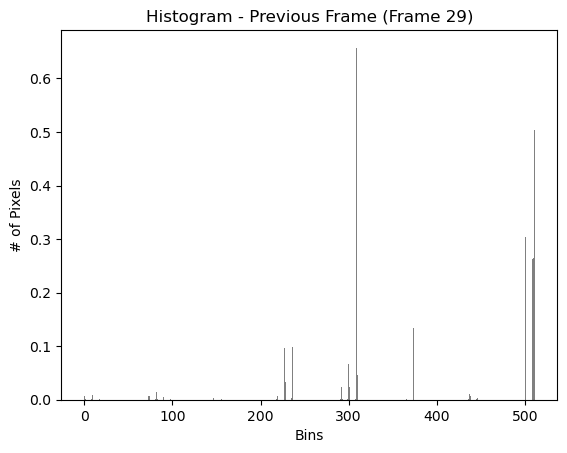

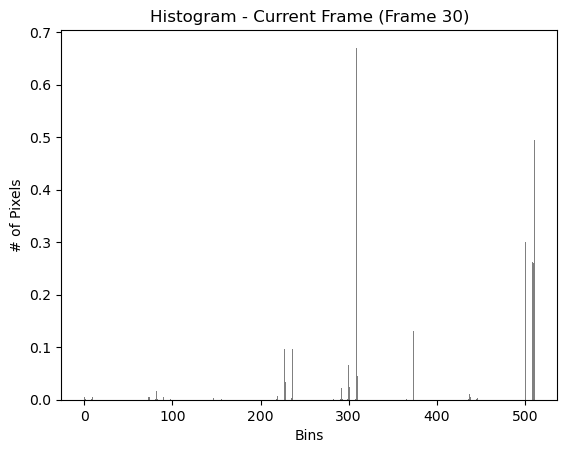

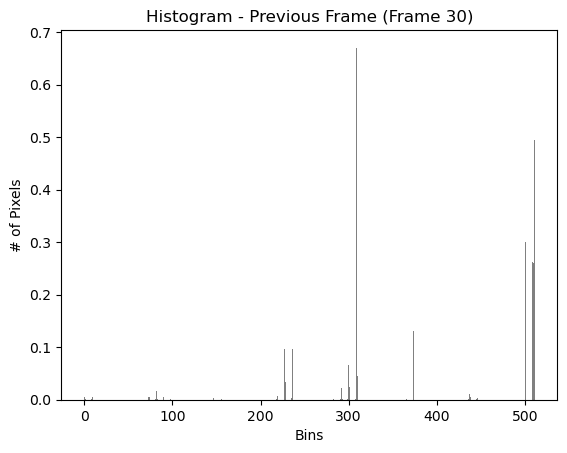

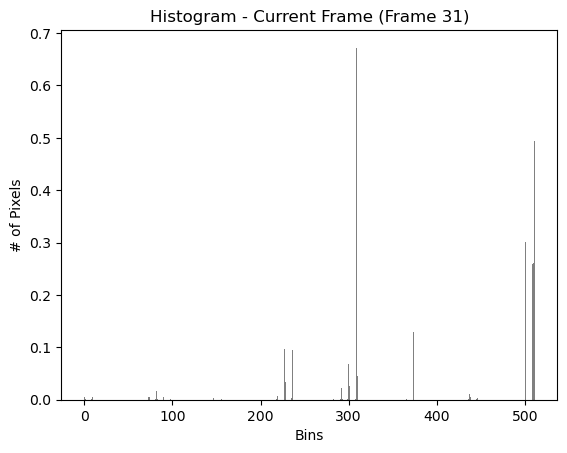

Hard cut detected at frame 32 (Pixel-based)


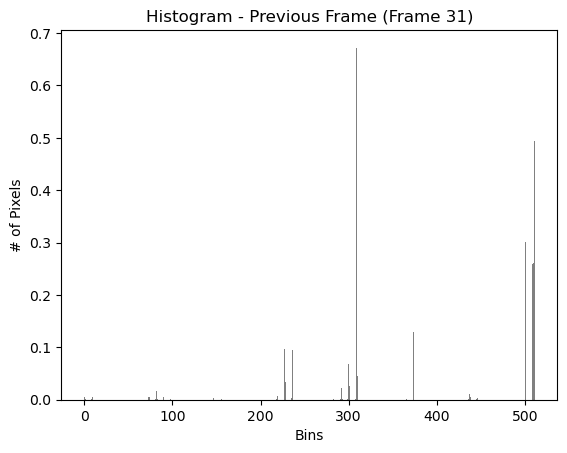

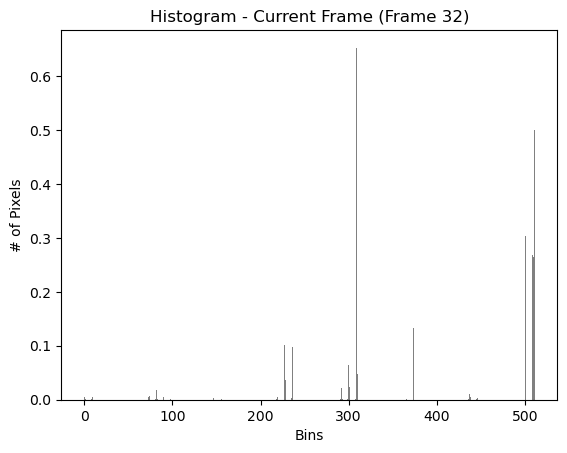

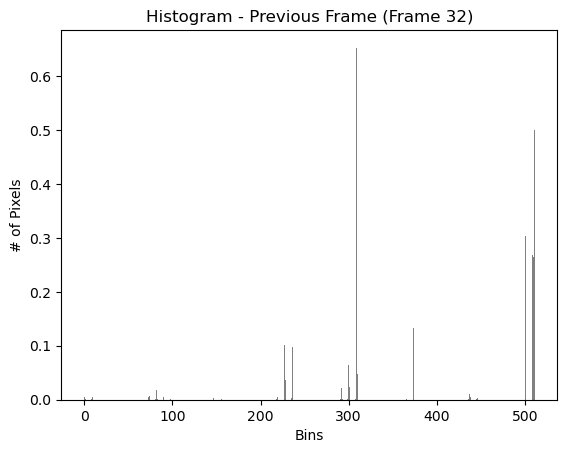

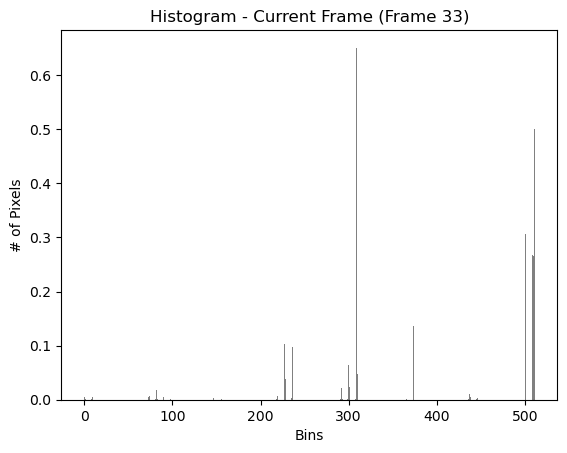

Hard cut detected at frame 34 (Pixel-based)


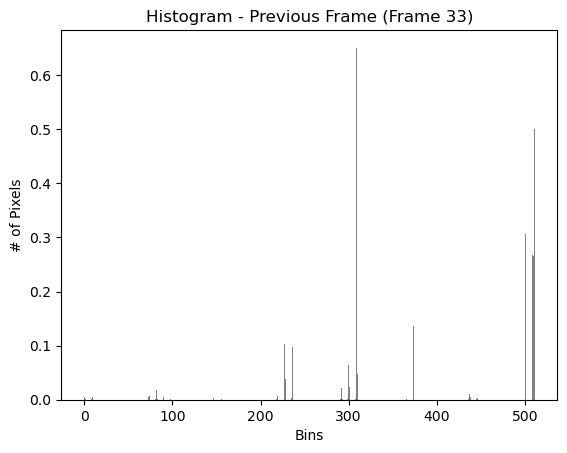

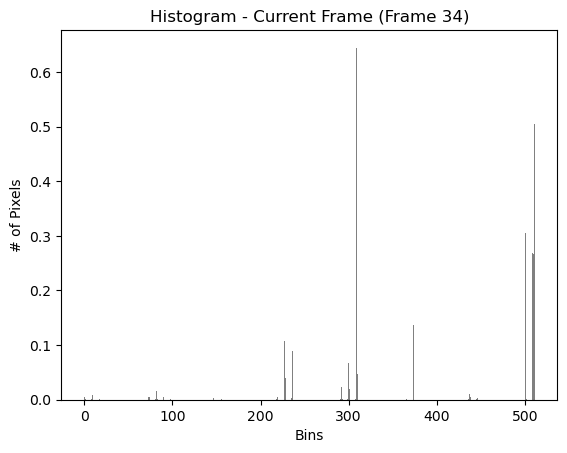

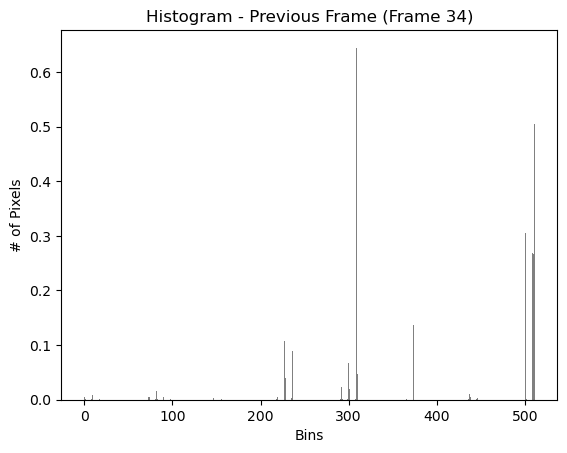

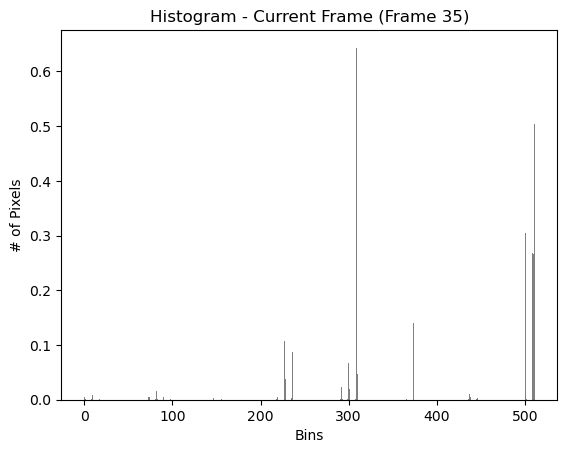

Hard cut detected at frame 36 (Pixel-based)


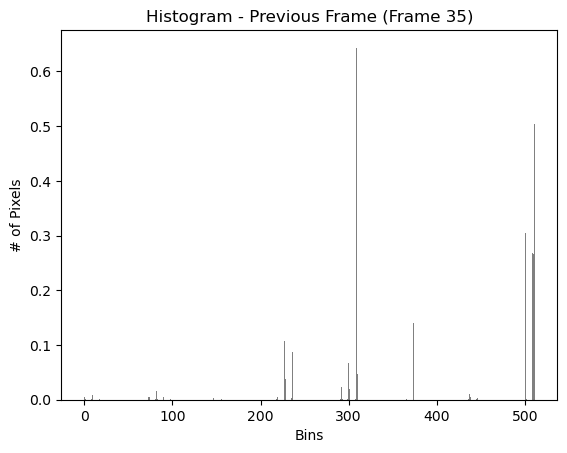

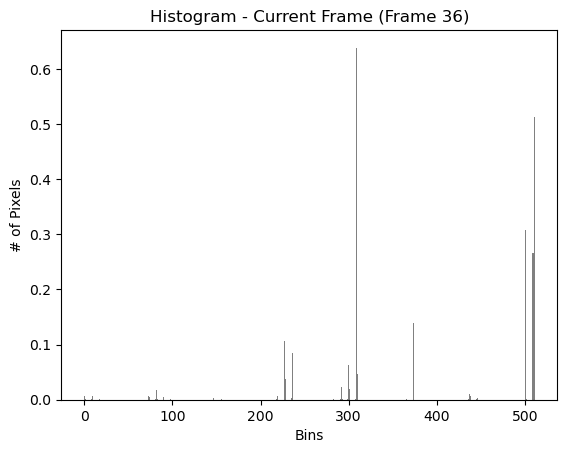

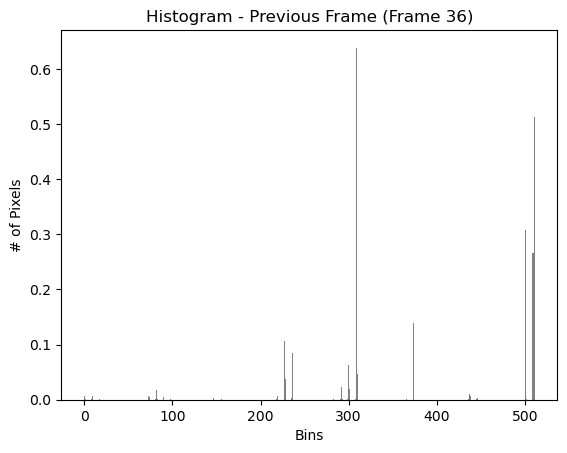

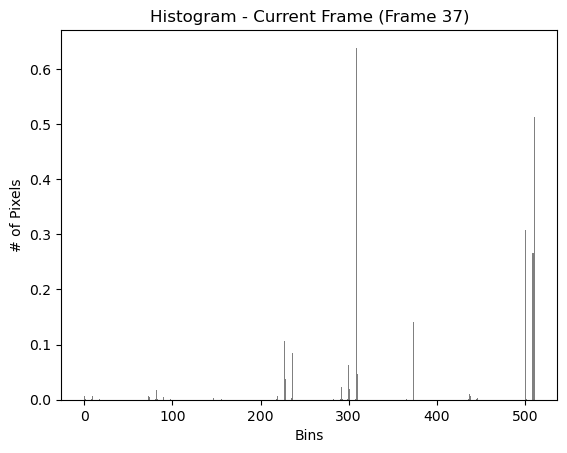

Hard cut detected at frame 38 (Pixel-based)


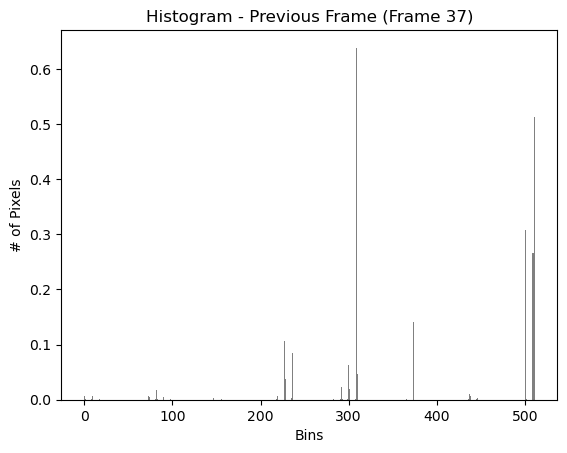

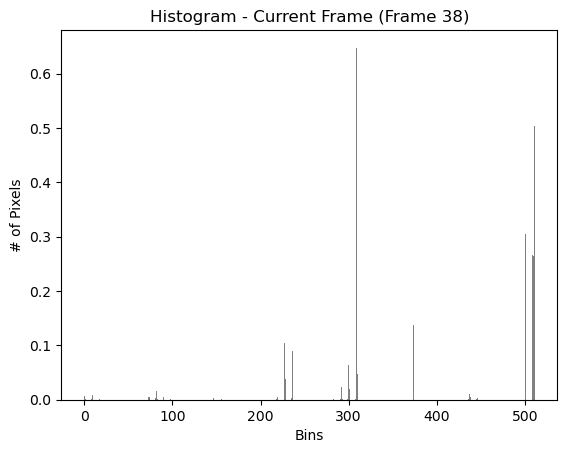

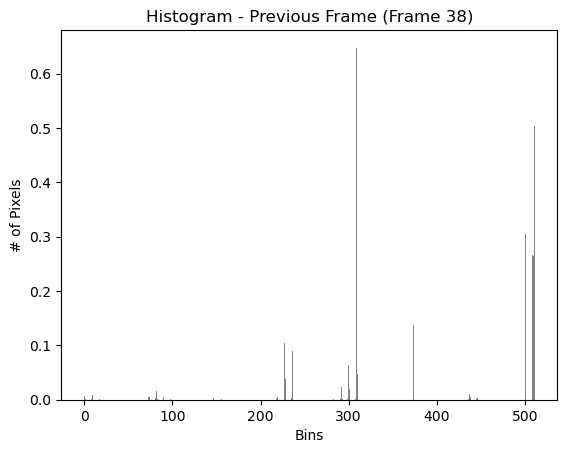

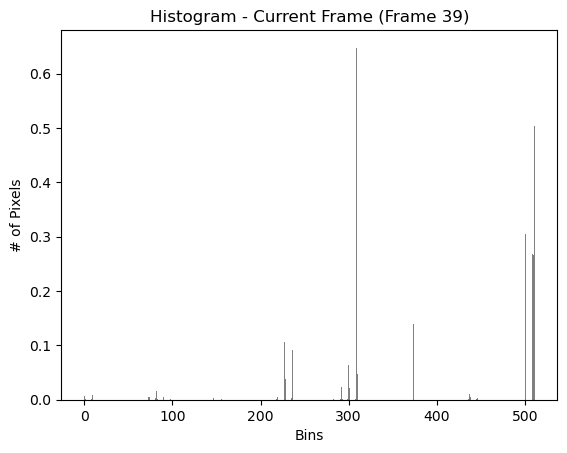

Hard cut detected at frame 40 (Pixel-based)


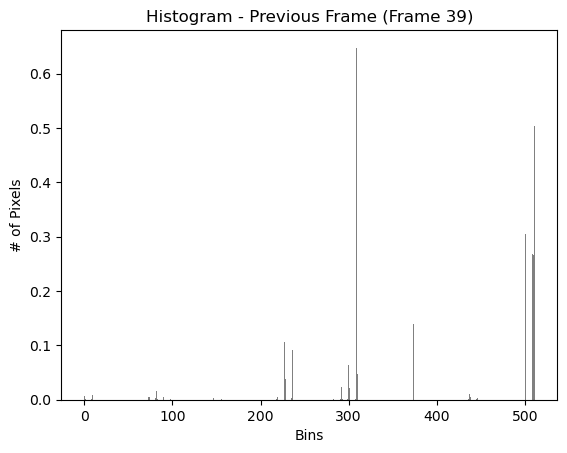

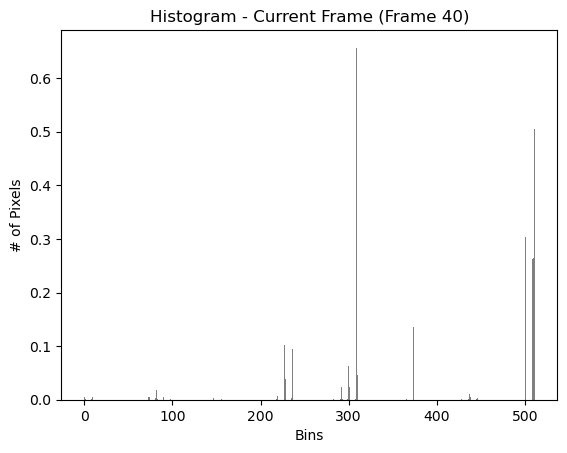

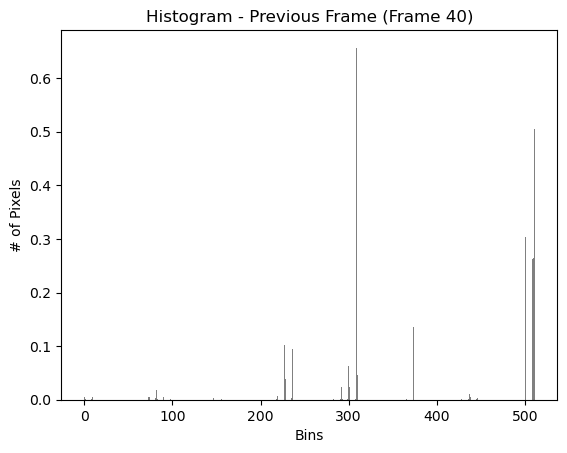

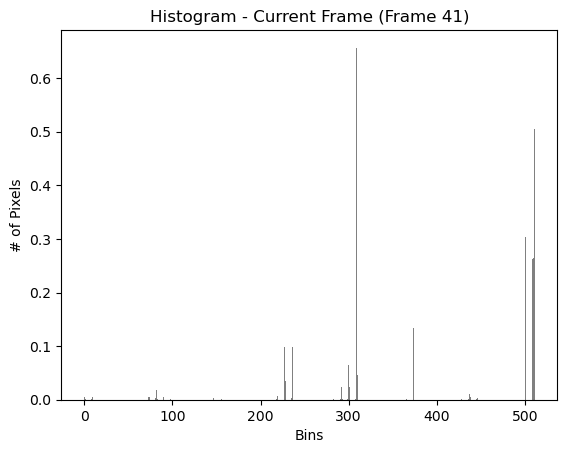

Hard cut detected at frame 42 (Pixel-based)


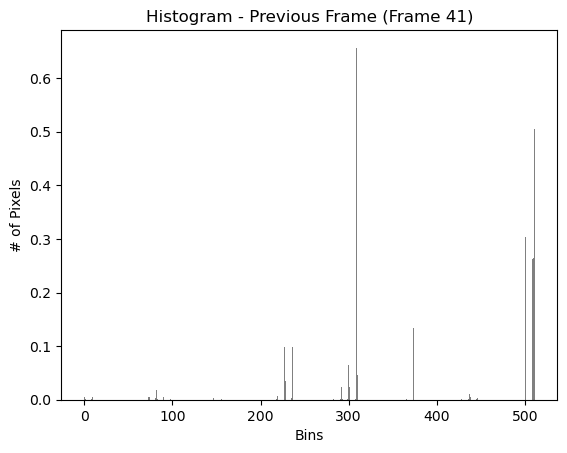

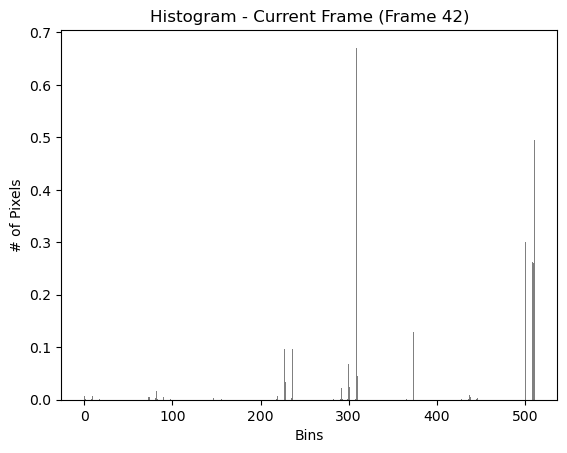

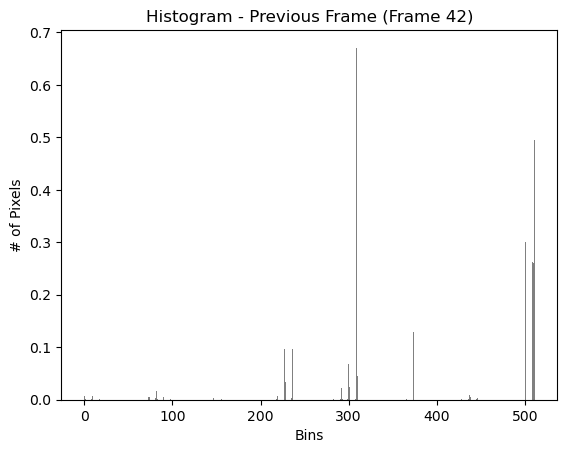

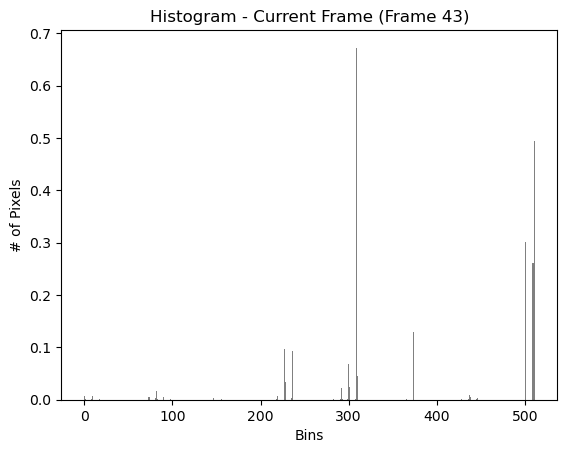

Hard cut detected at frame 44 (Pixel-based)


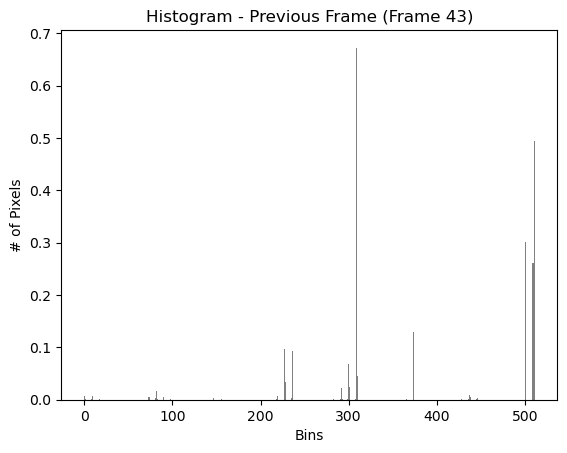

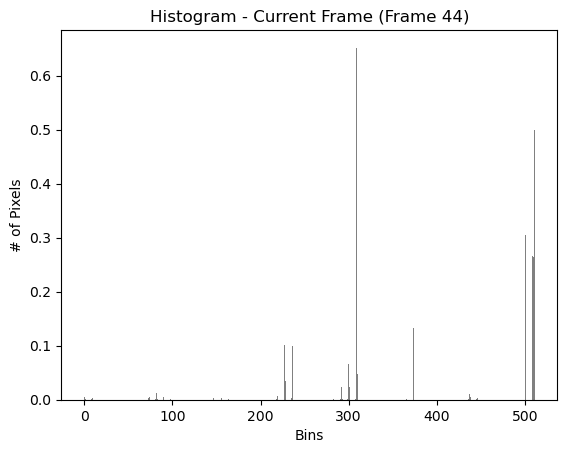

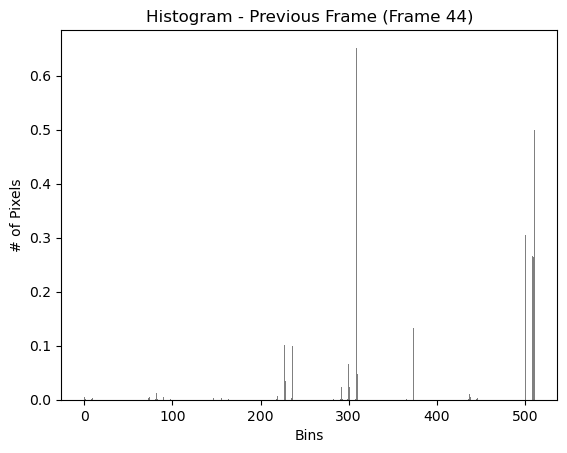

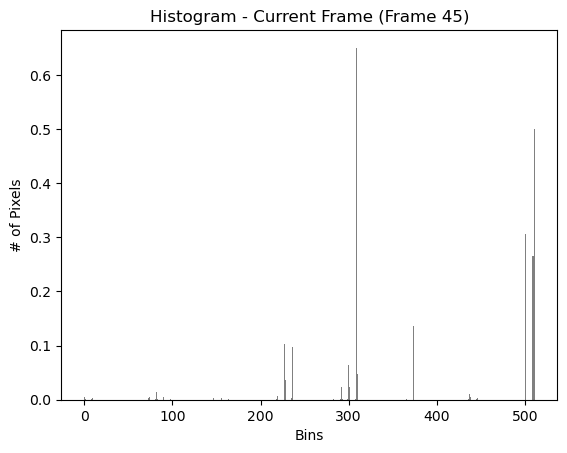

Hard cut detected at frame 46 (Pixel-based)


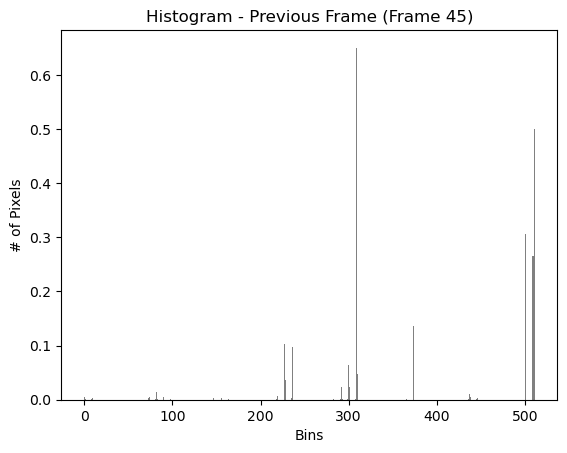

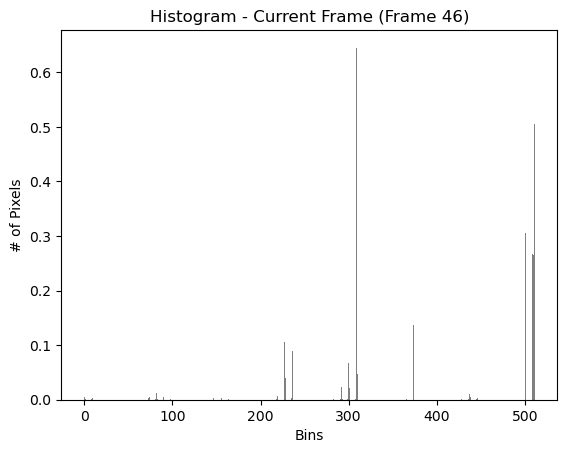

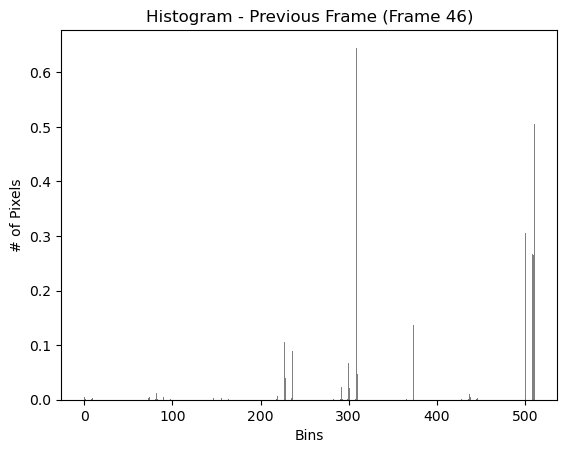

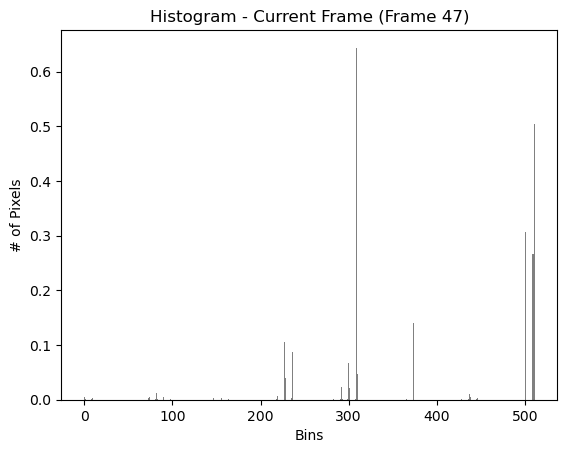

Hard cut detected at frame 48 (Pixel-based)


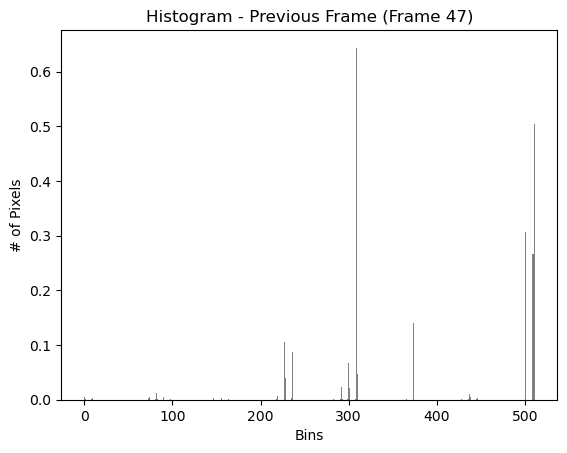

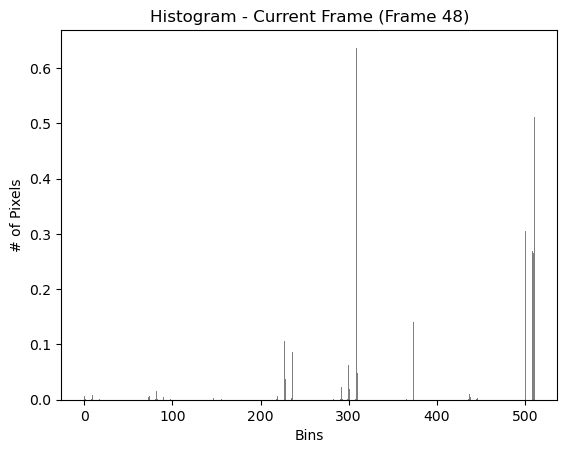

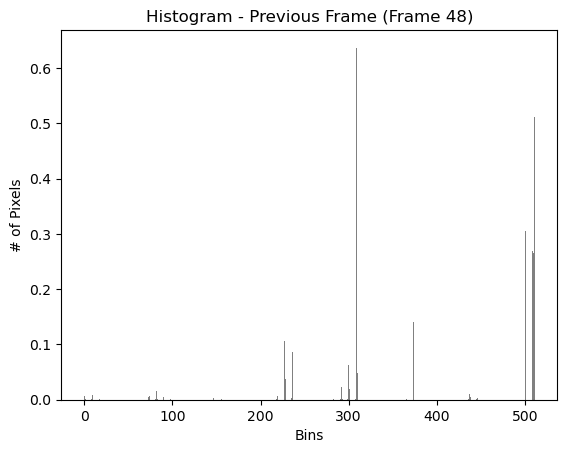

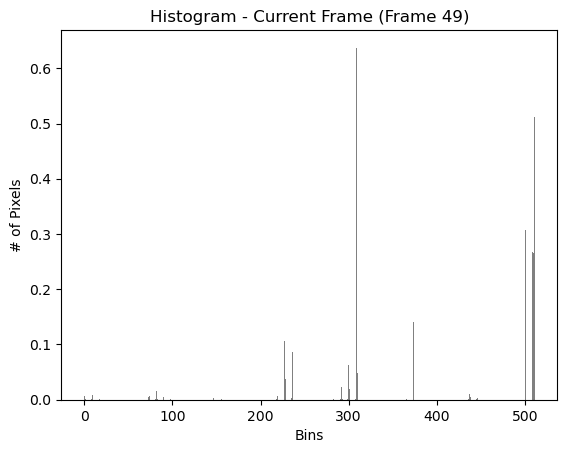

Hard cut detected at frame 50 (Pixel-based)


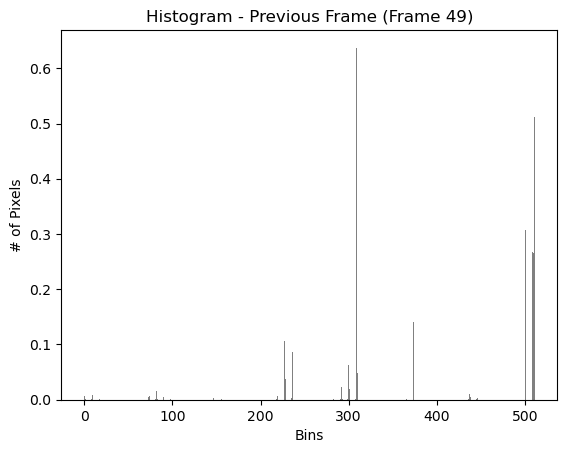

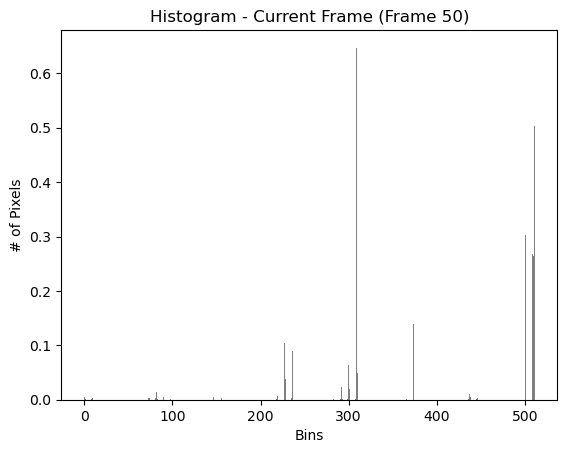

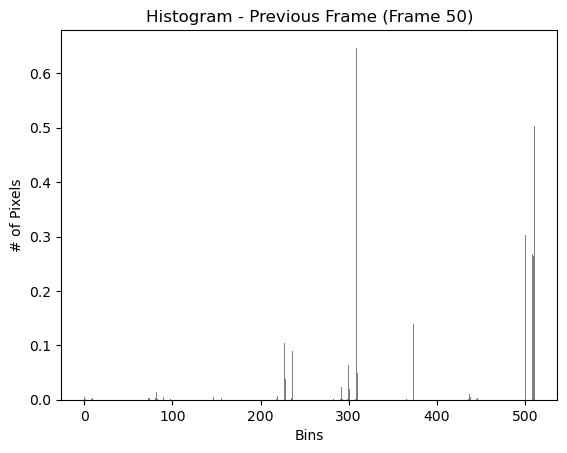

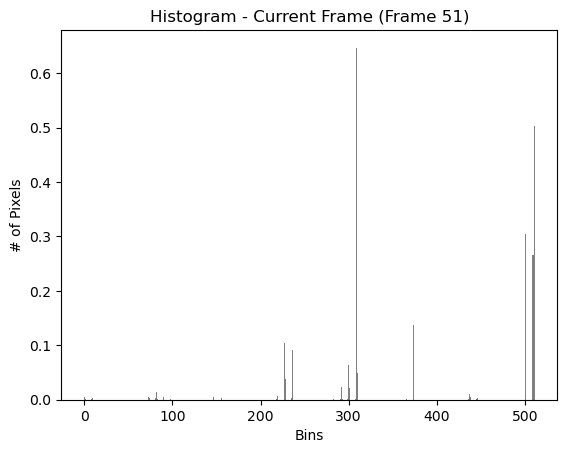

Hard cut detected at frame 52 (Pixel-based)


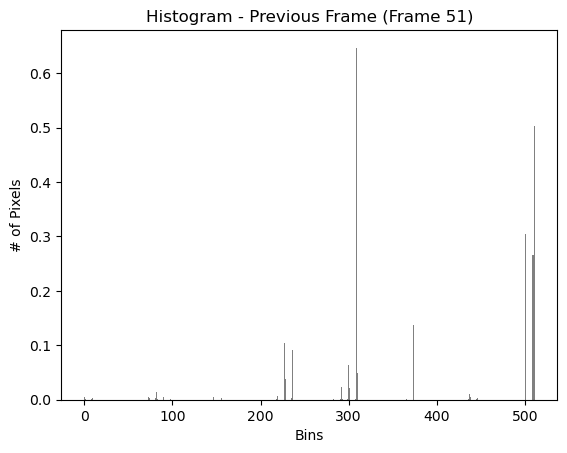

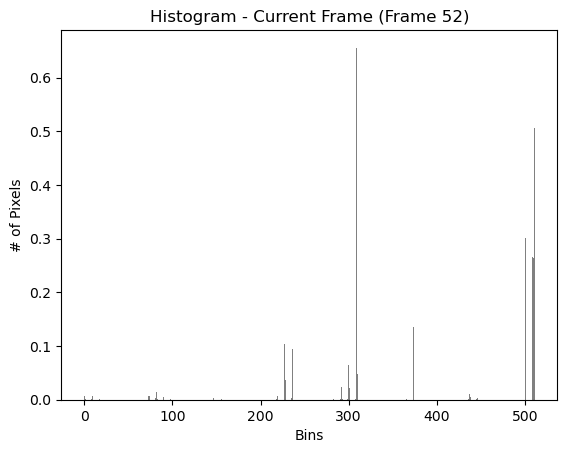

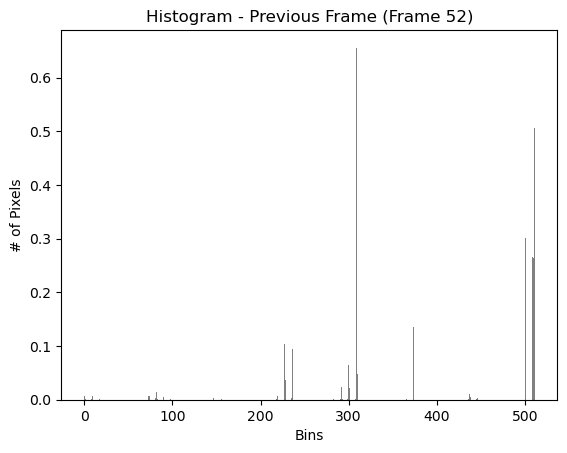

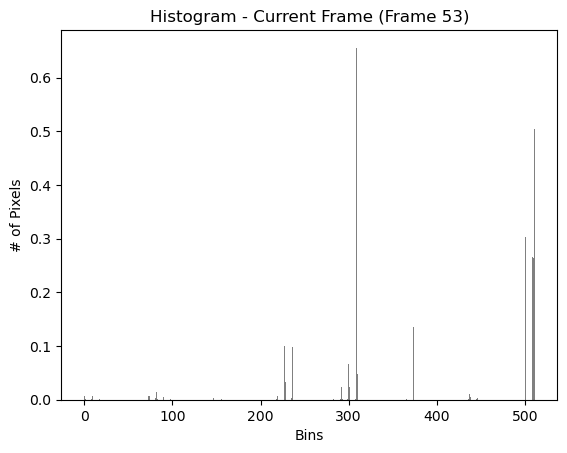

Hard cut detected at frame 54 (Pixel-based)


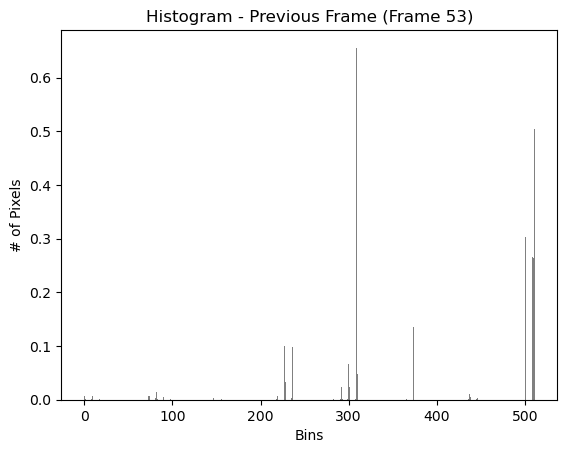

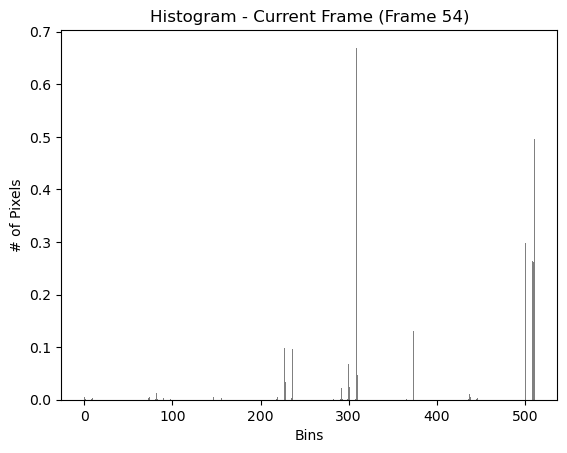

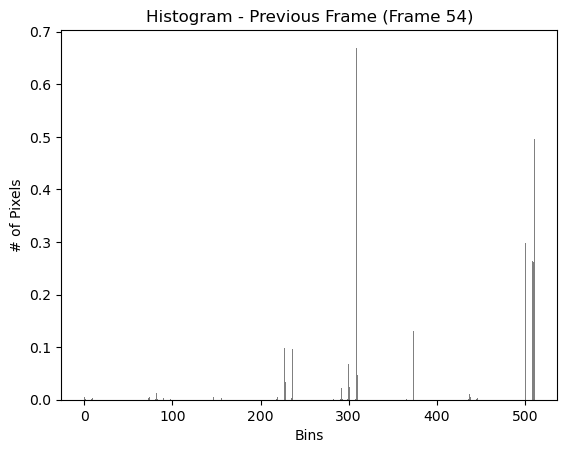

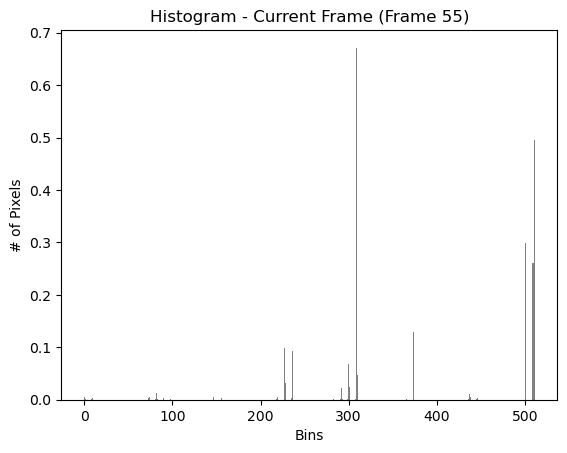

Hard cut detected at frame 56 (Pixel-based)


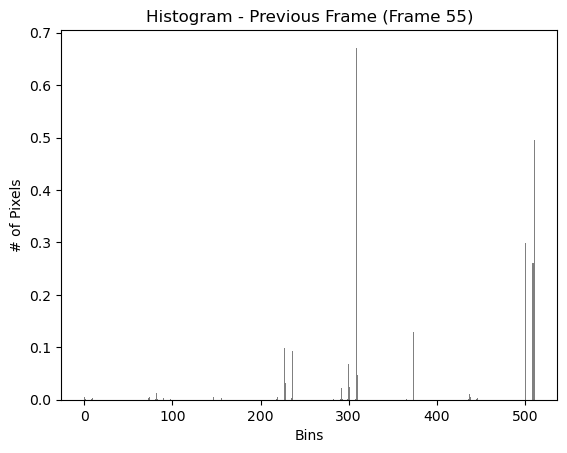

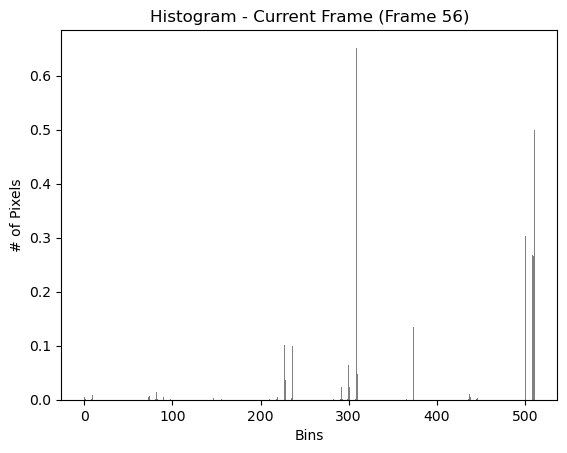

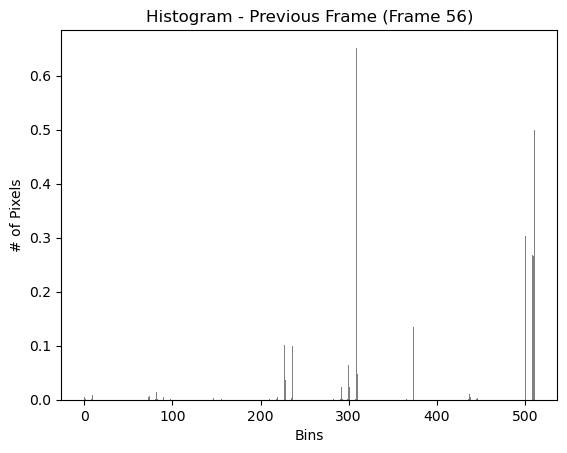

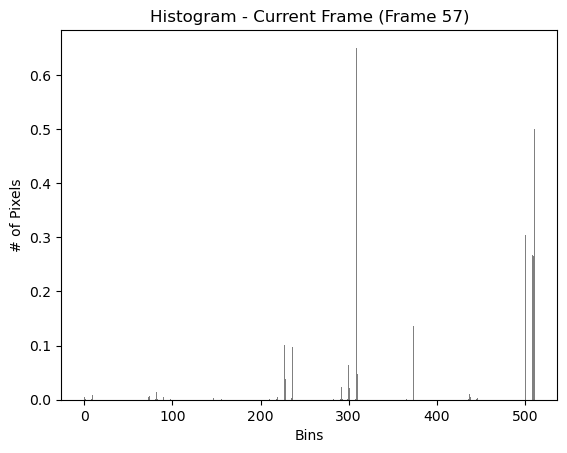

Hard cut detected at frame 58 (Pixel-based)


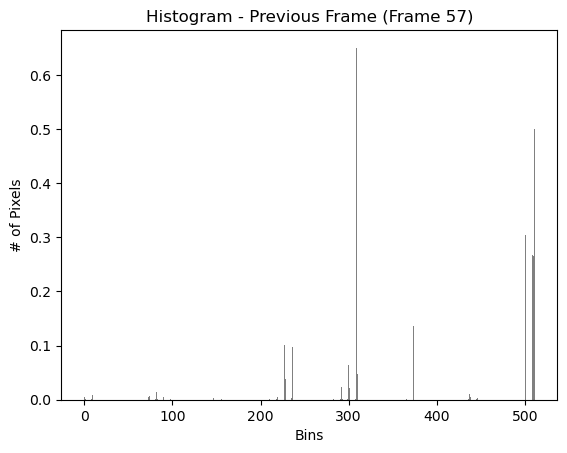

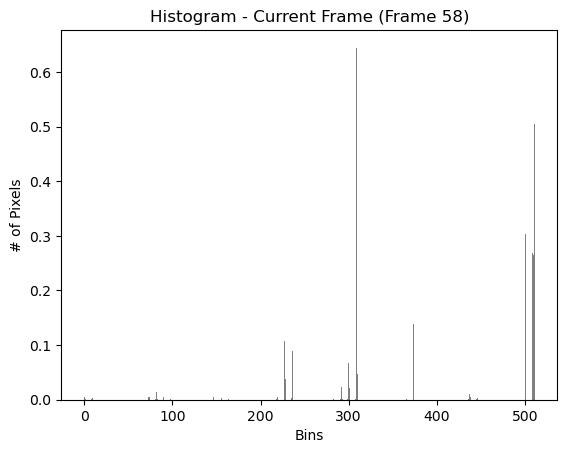

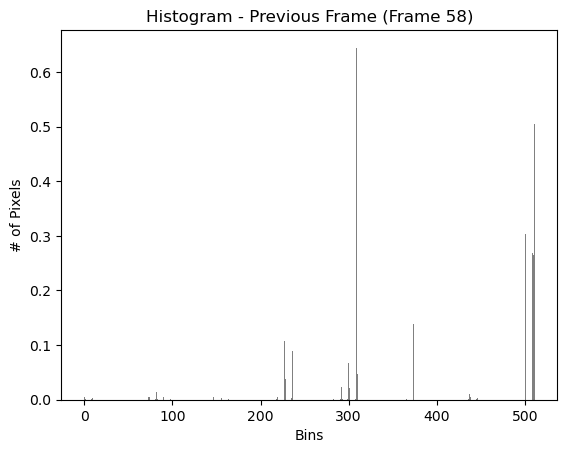

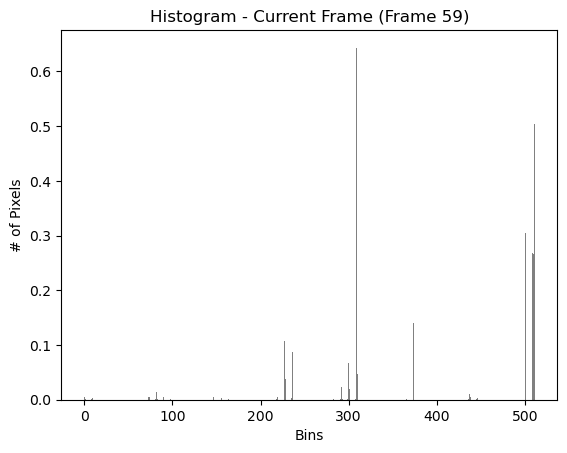

Hard cut detected at frame 60 (Pixel-based)


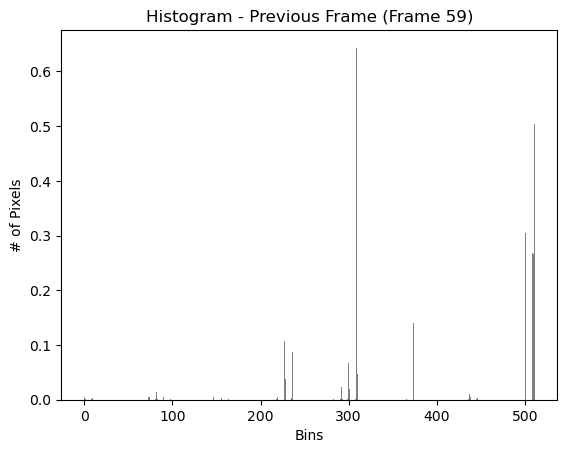

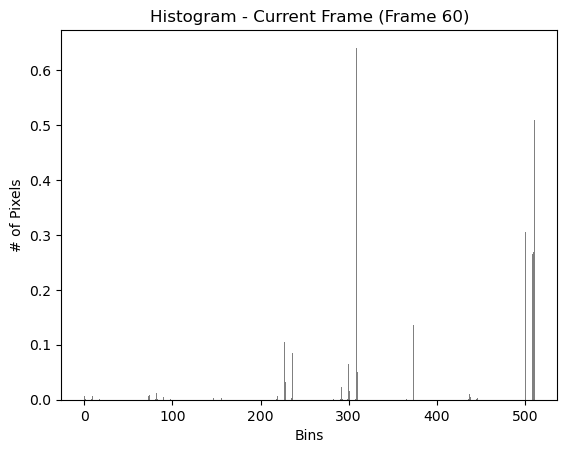

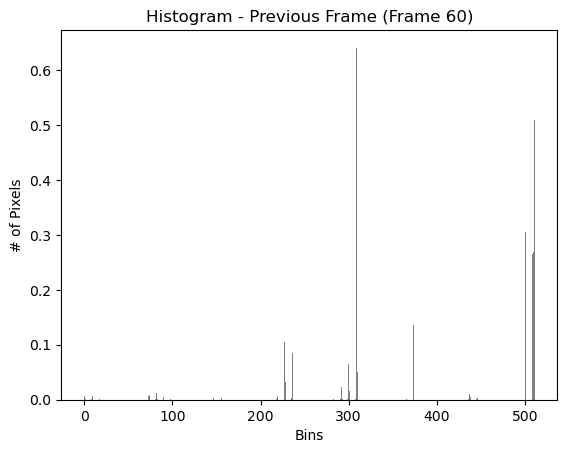

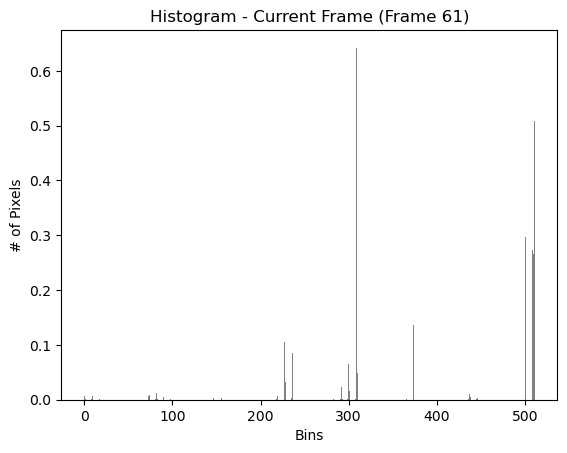

Hard cut detected at frame 62 (Pixel-based)


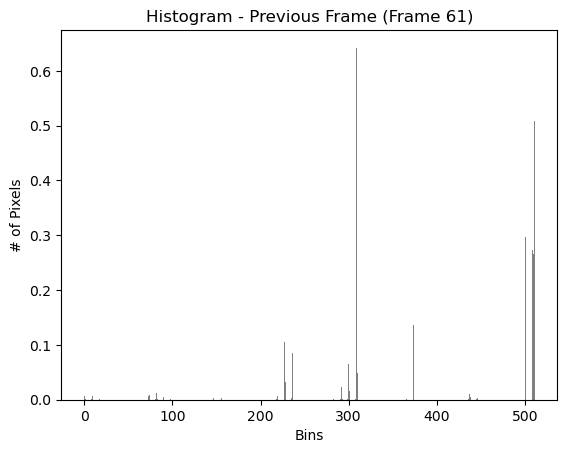

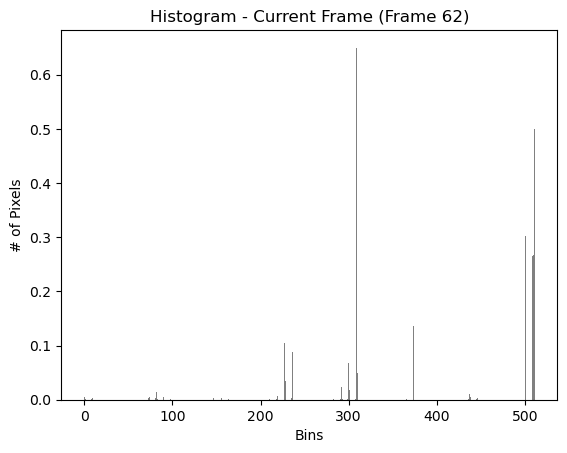

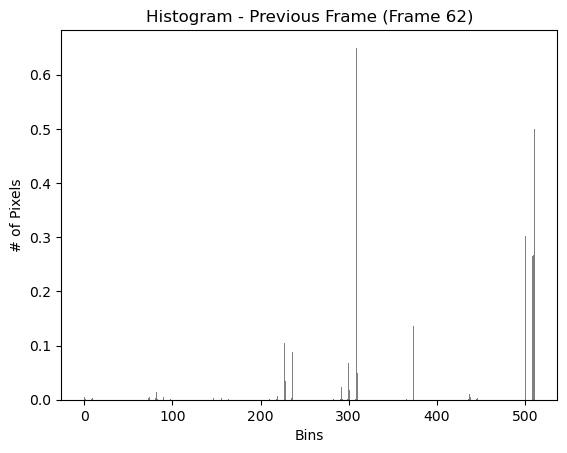

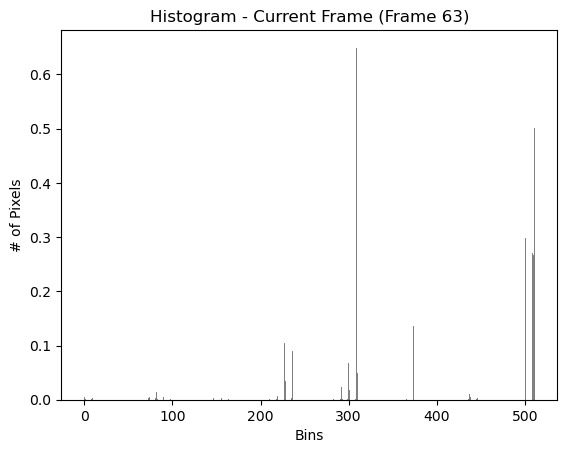

Hard cut detected at frame 64 (Pixel-based)


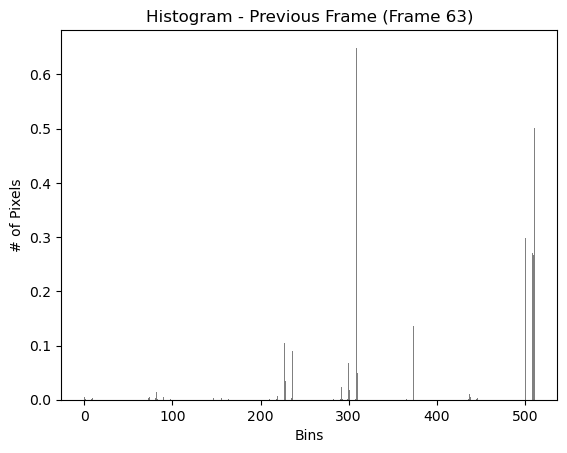

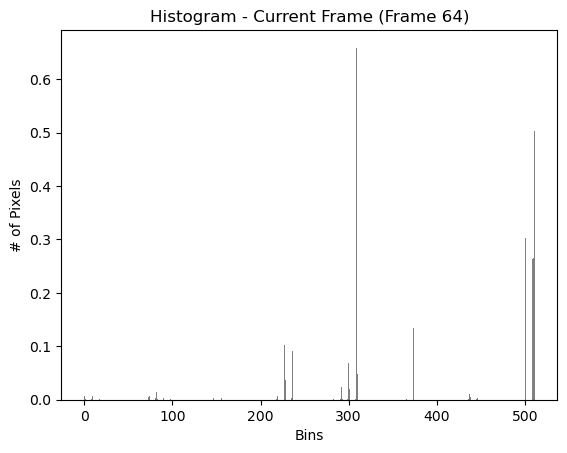

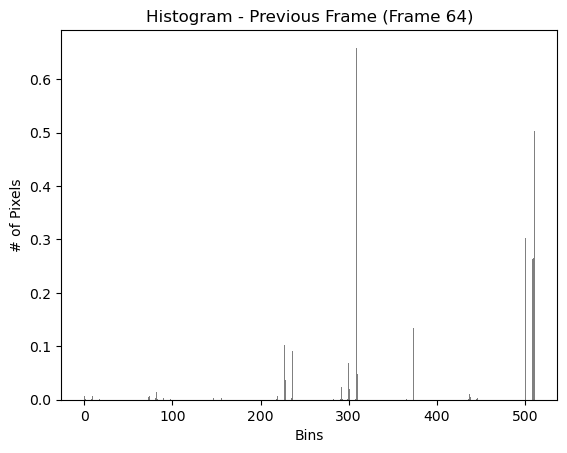

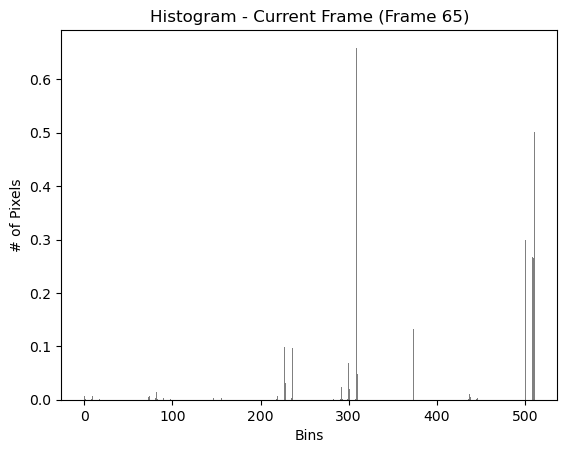

Hard cut detected at frame 66 (Pixel-based)


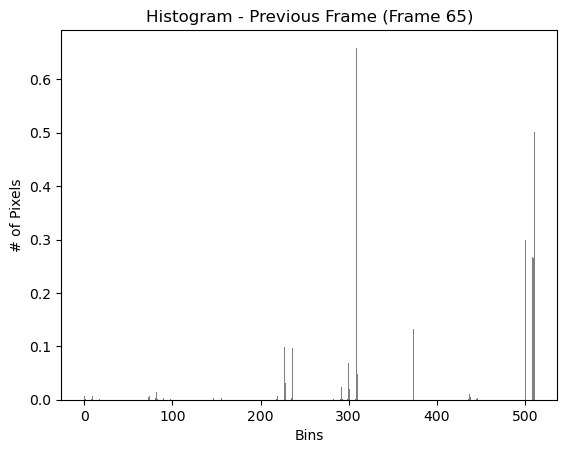

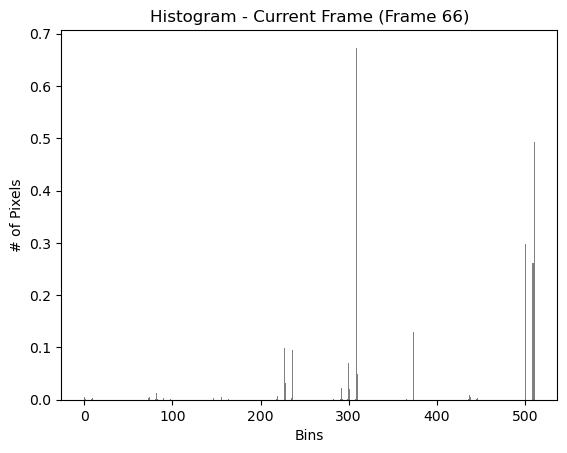

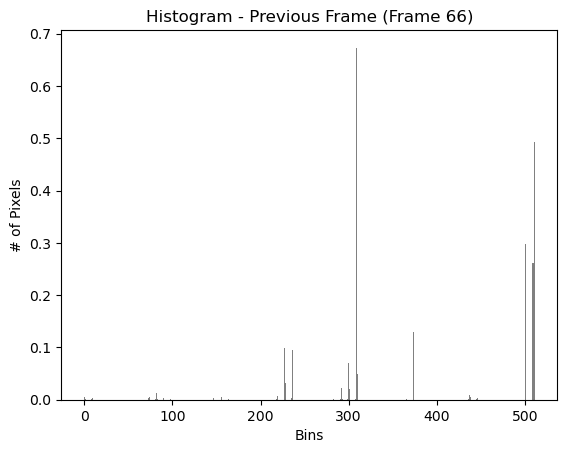

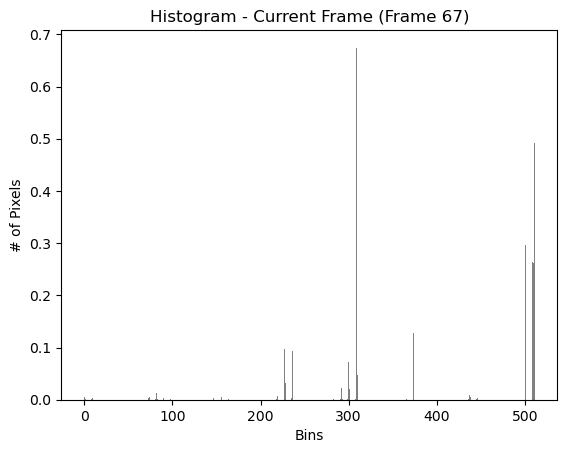

Hard cut detected at frame 68 (Pixel-based)


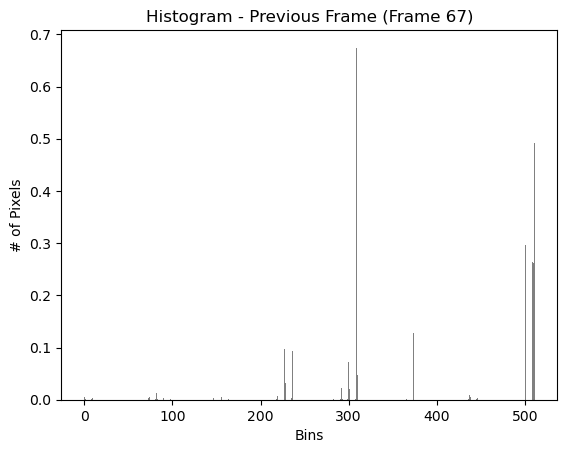

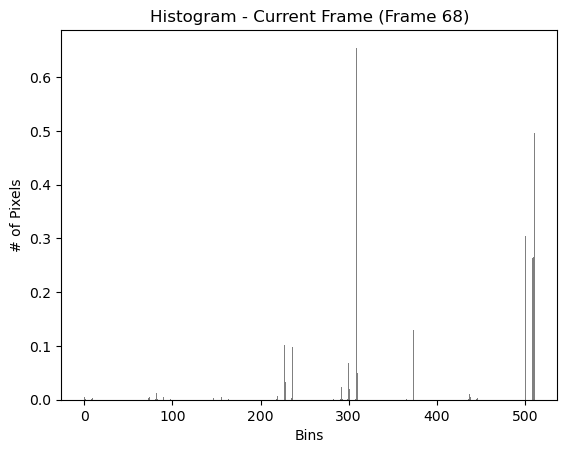

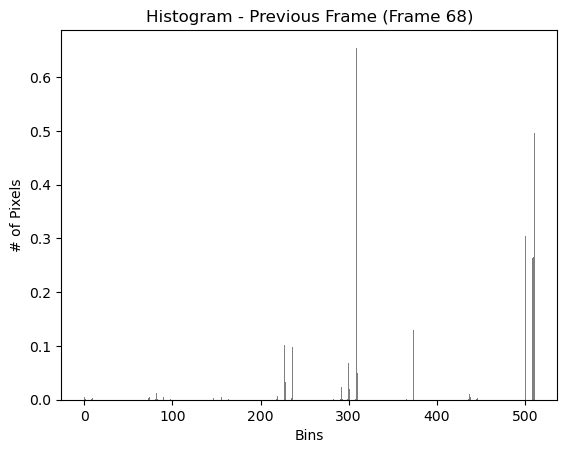

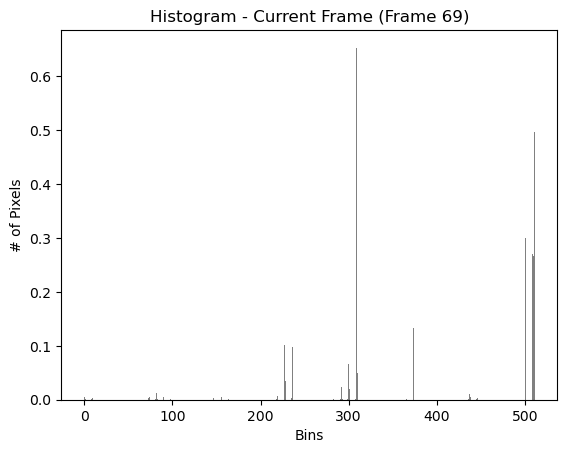

Hard cut detected at frame 70 (Pixel-based)


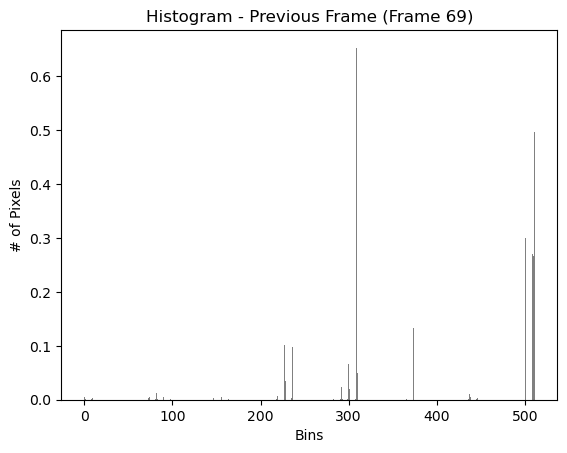

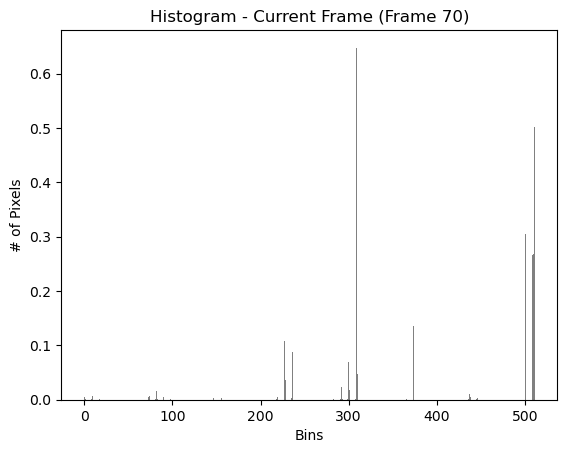

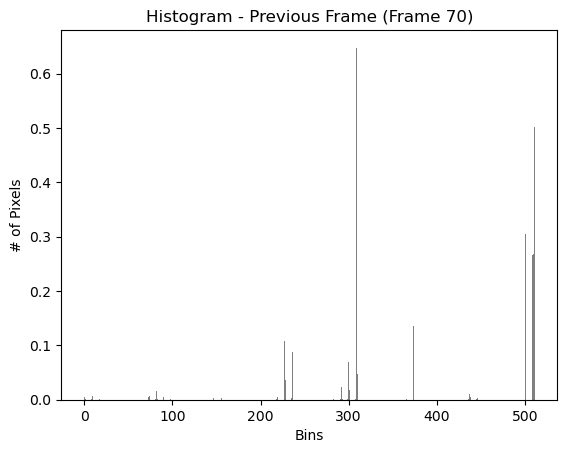

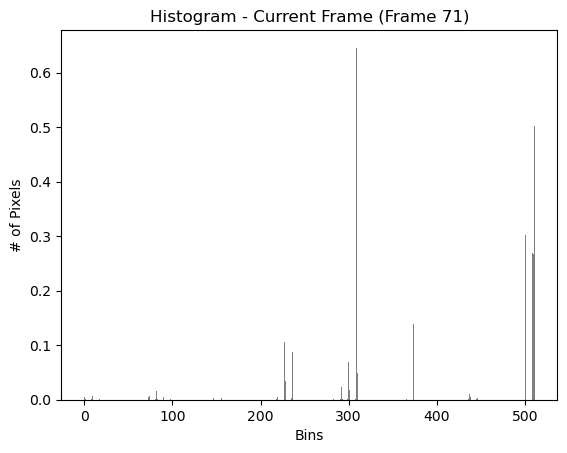

Hard cut detected at frame 72 (Pixel-based)


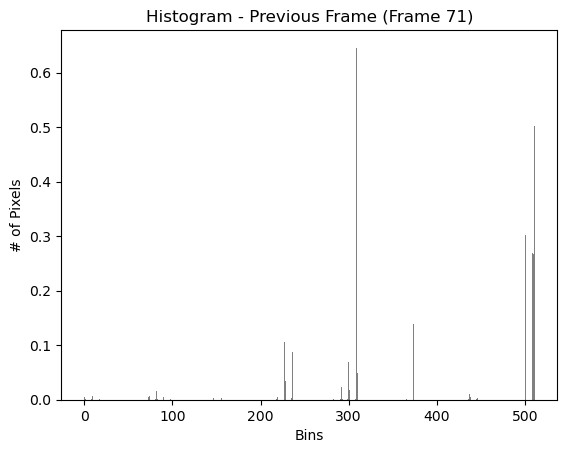

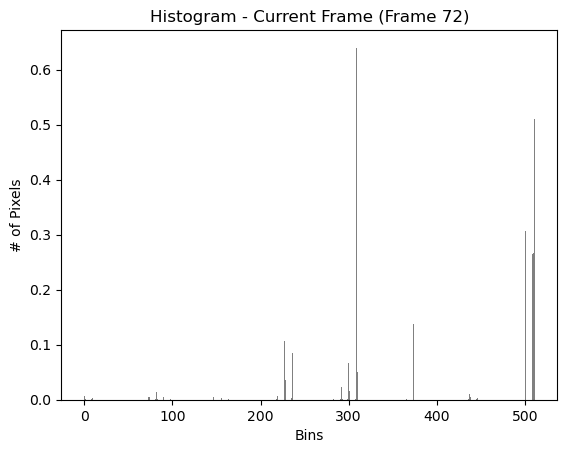

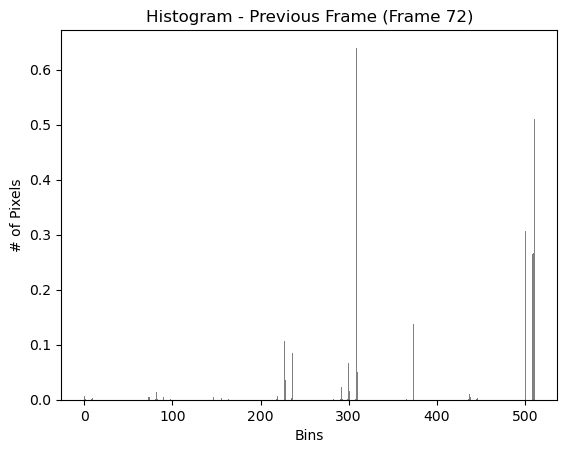

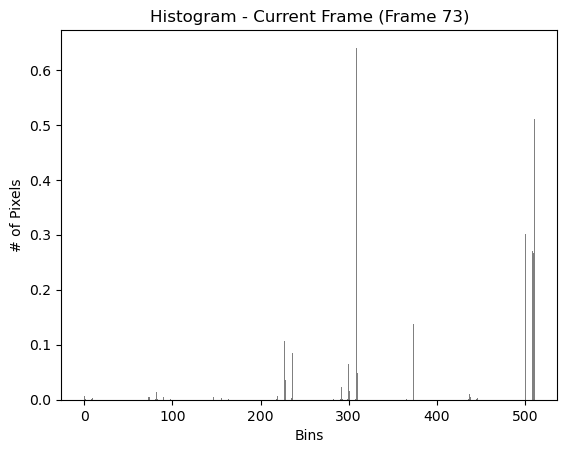

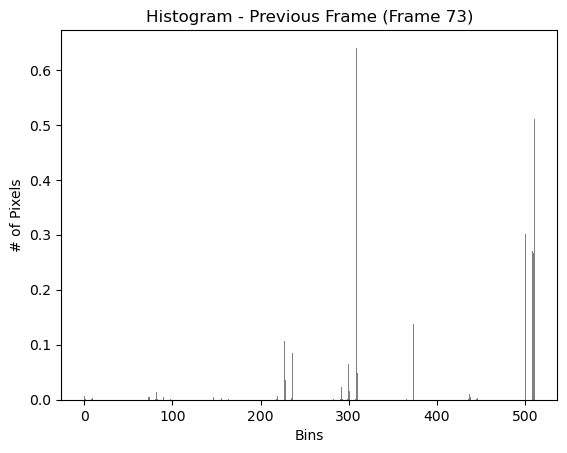

...

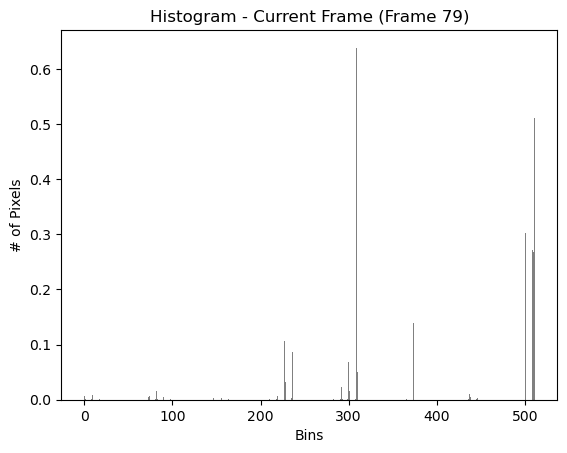

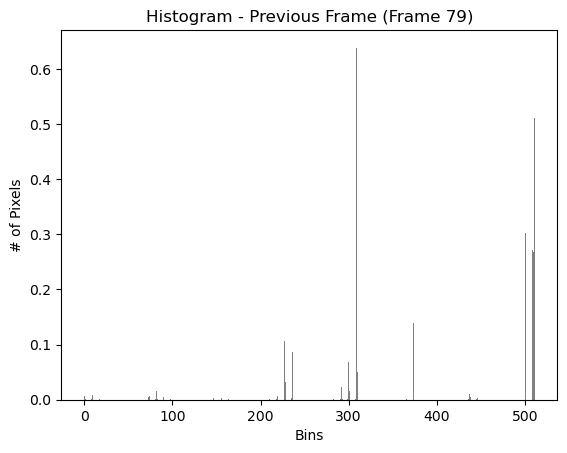

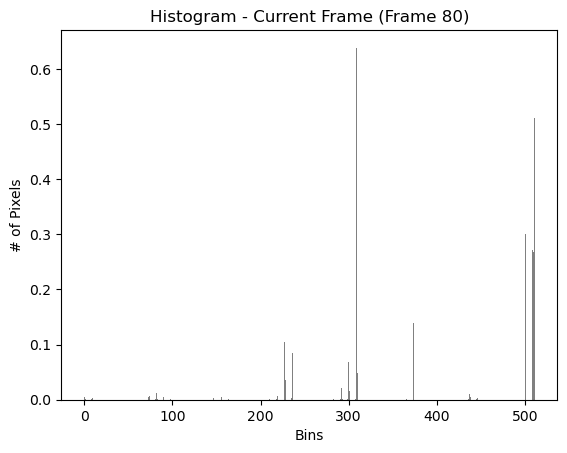

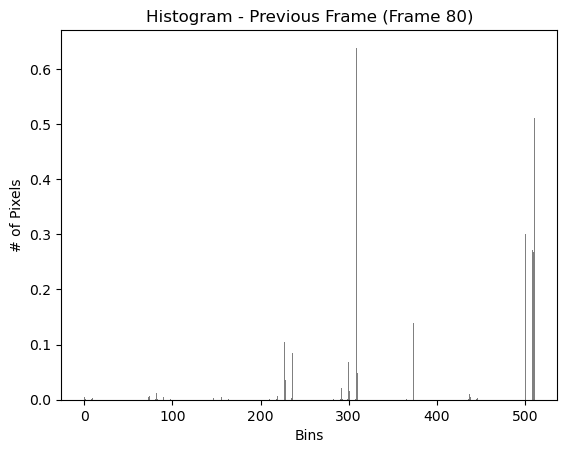

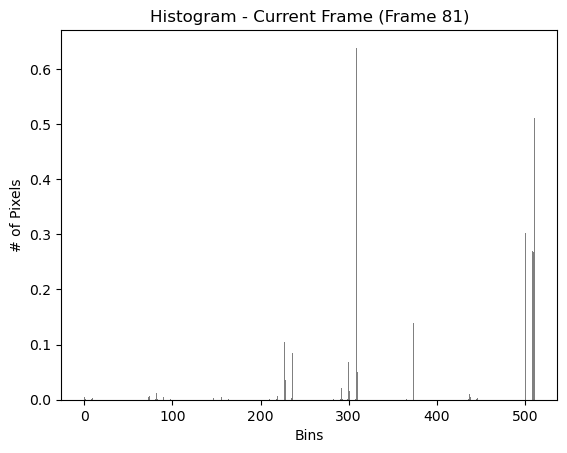

Hard cut detected at frame 82 (Pixel-based)


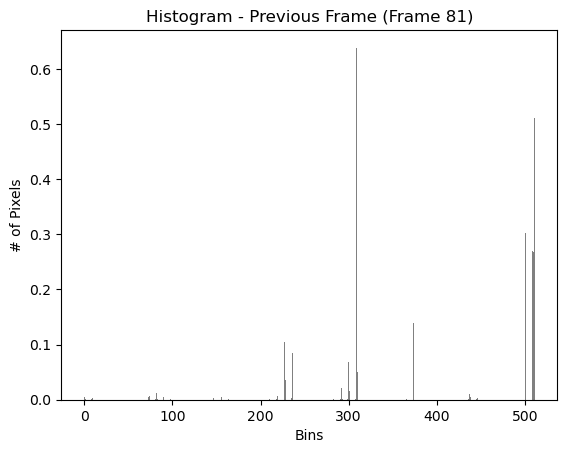

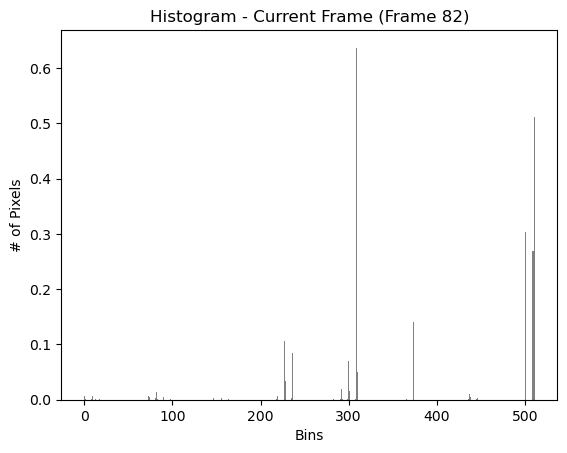

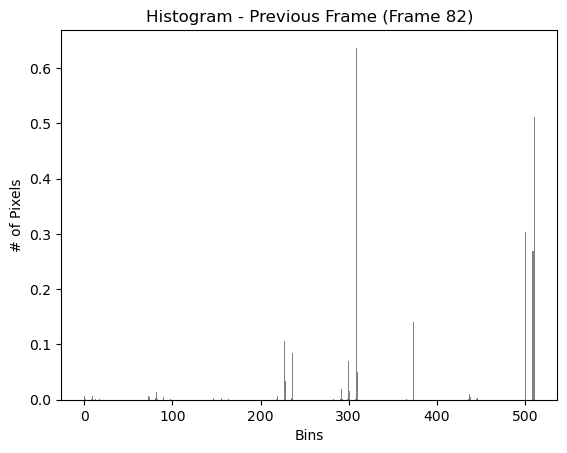

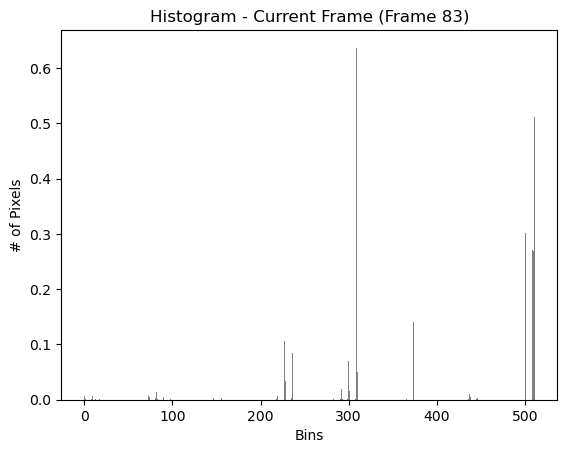

Hard cut detected at frame 84 (Pixel-based)


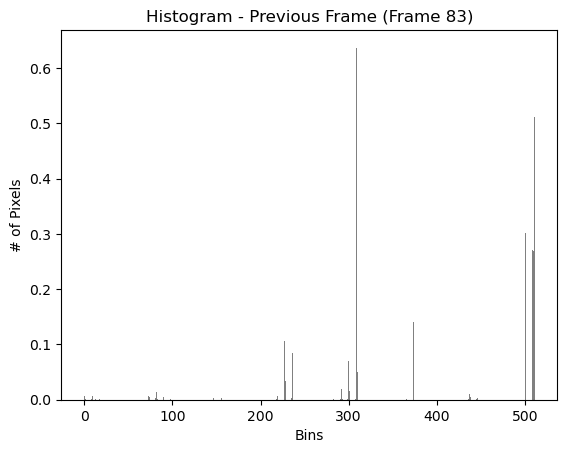

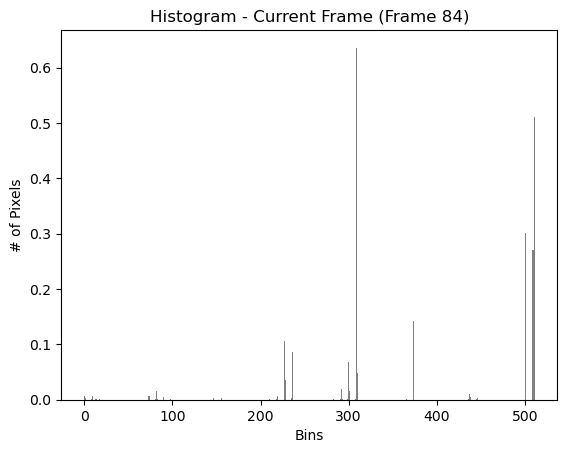

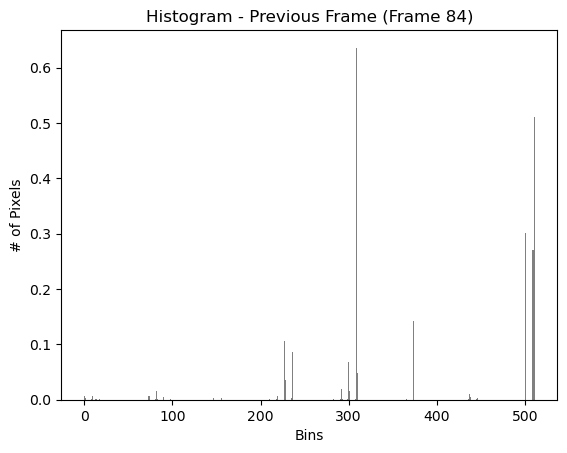

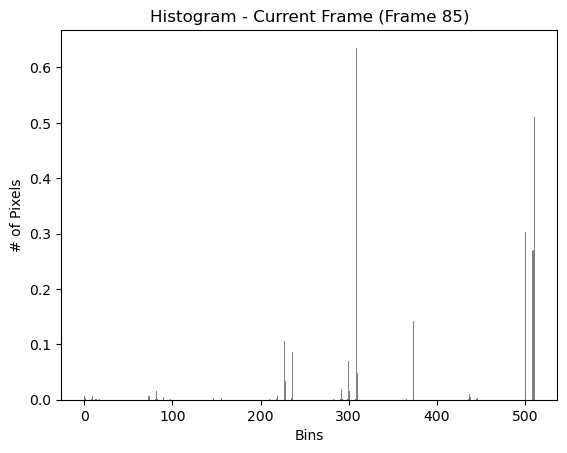

Hard cut detected at frame 86 (Pixel-based)


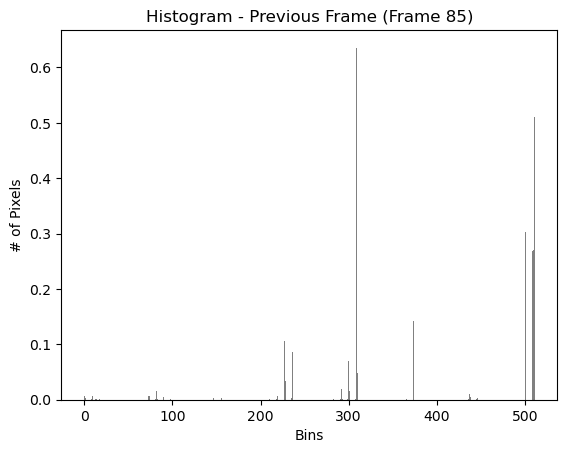

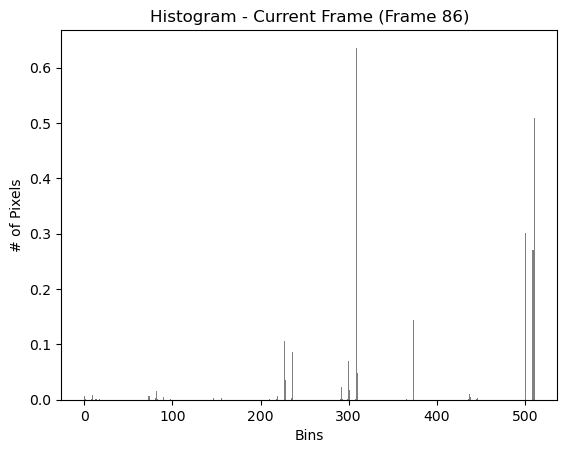

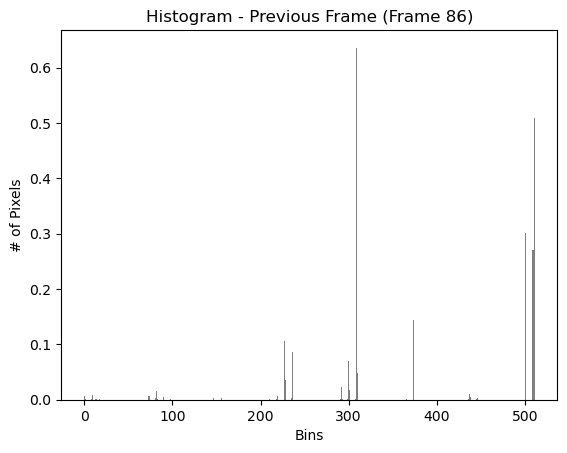

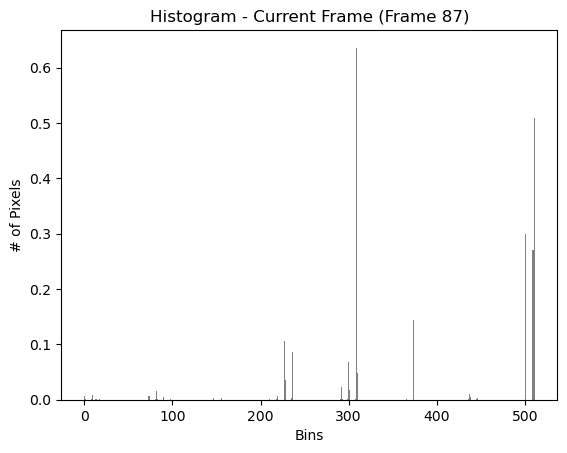

Hard cut detected at frame 88 (Pixel-based)


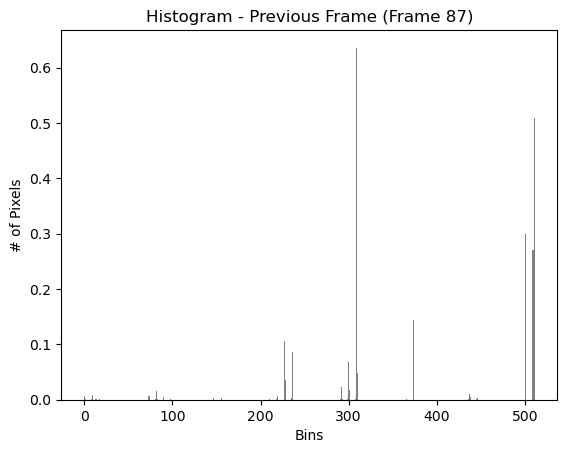

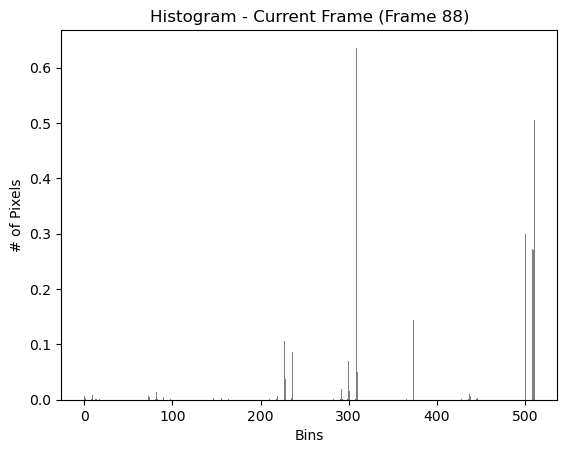

Hard cut detected at frame 89 (Pixel-based)


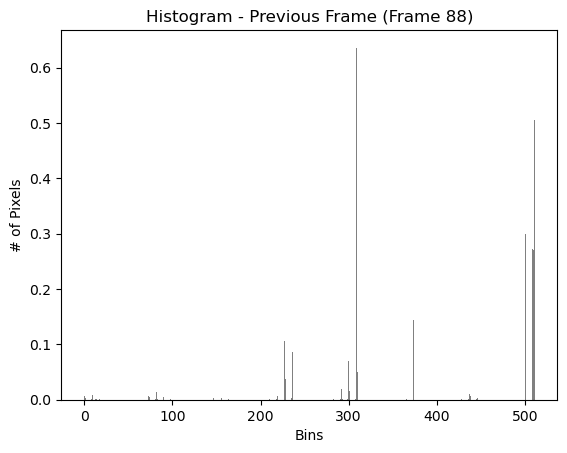

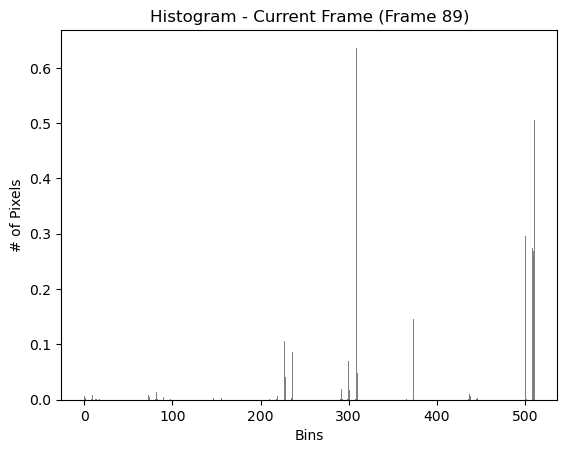

Hard cut detected at frame 90 (Pixel-based)


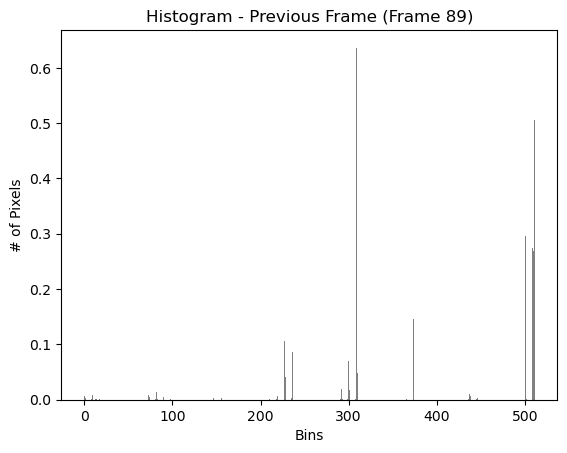

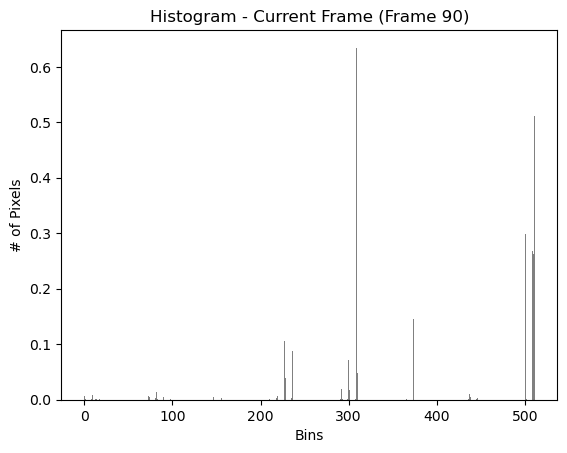

Hard cut detected at frame 91 (Pixel-based)


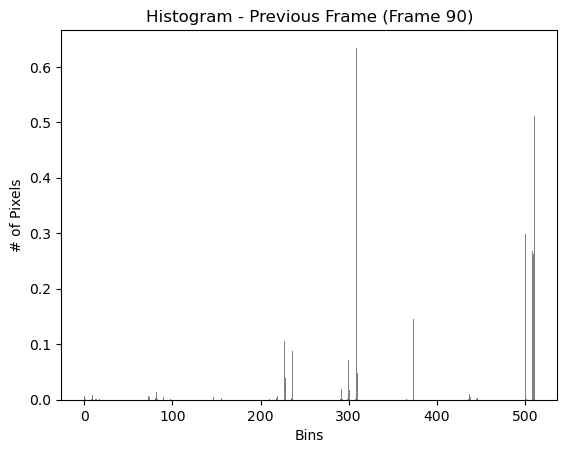

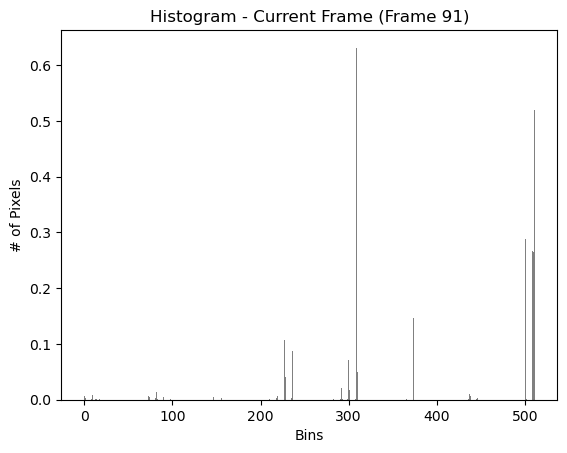

Hard cut detected at frame 92 (Pixel-based)


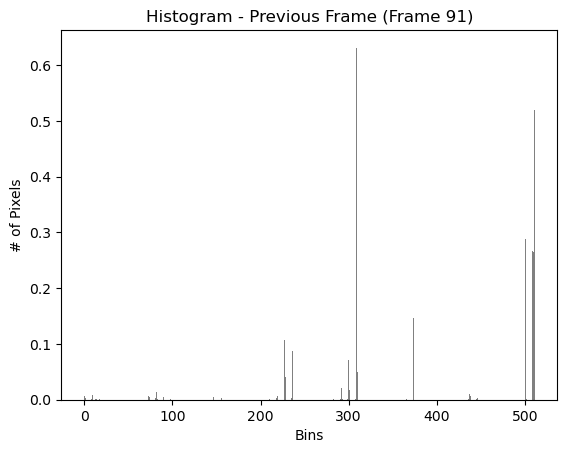

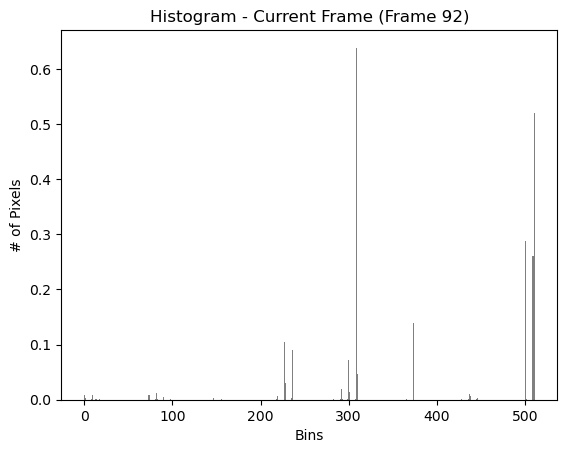

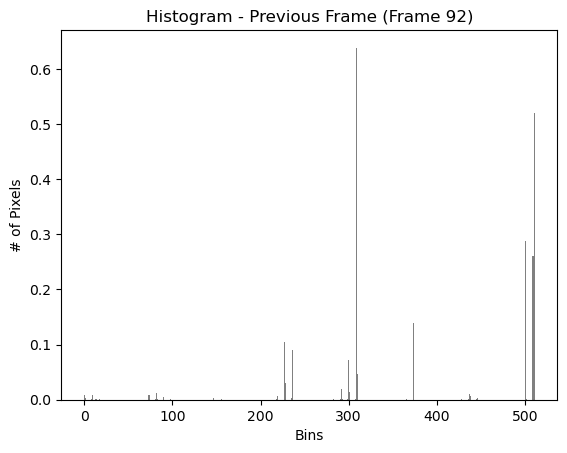

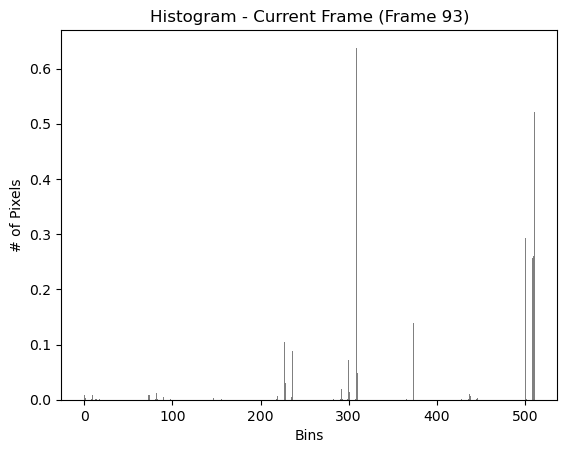

Hard cut detected at frame 94 (Pixel-based)


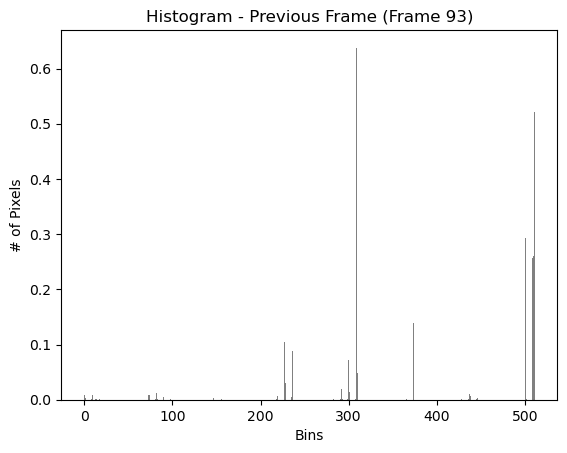

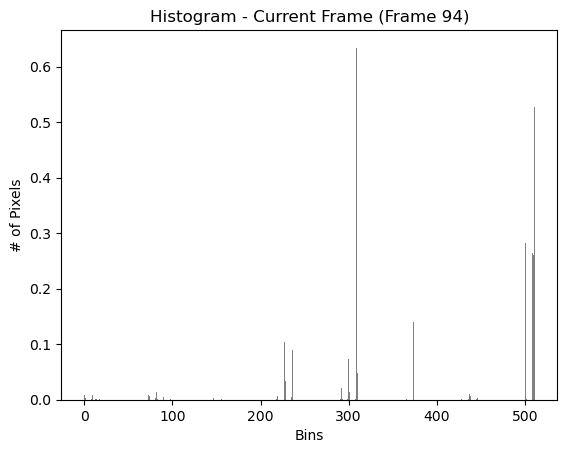

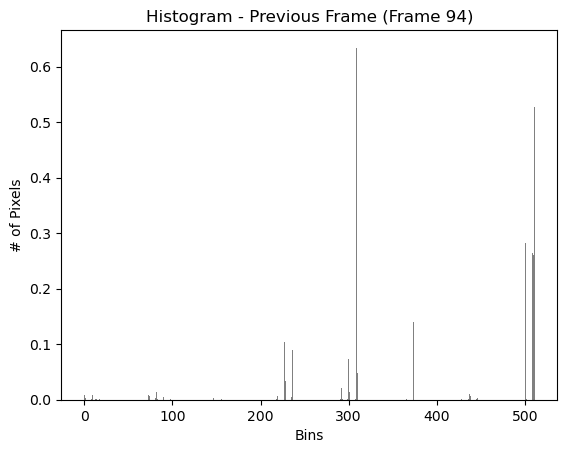

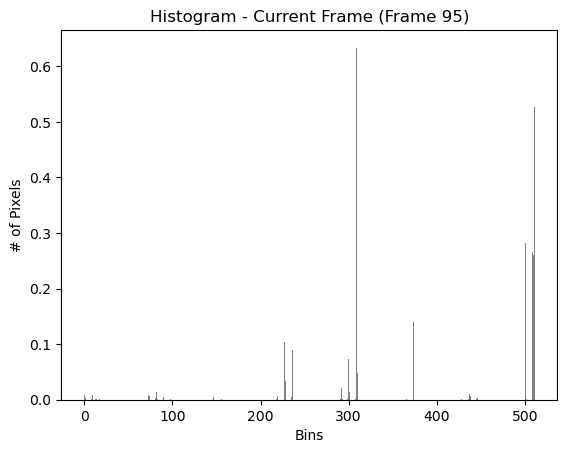

Hard cut detected at frame 96 (Pixel-based)


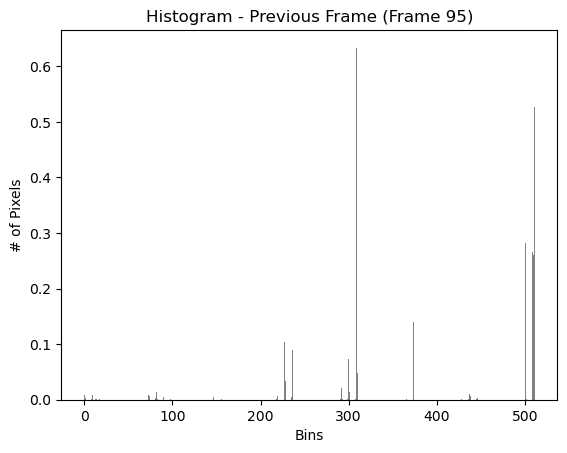

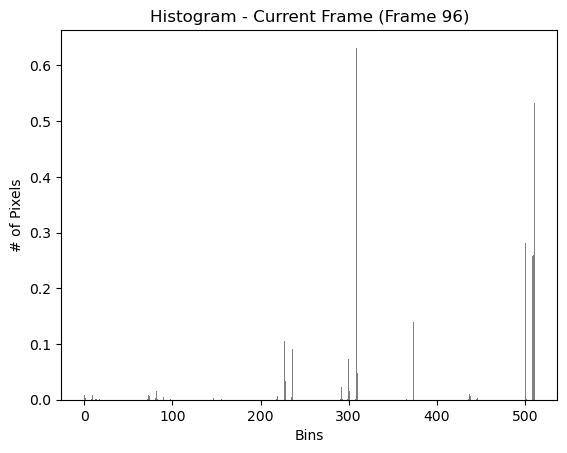

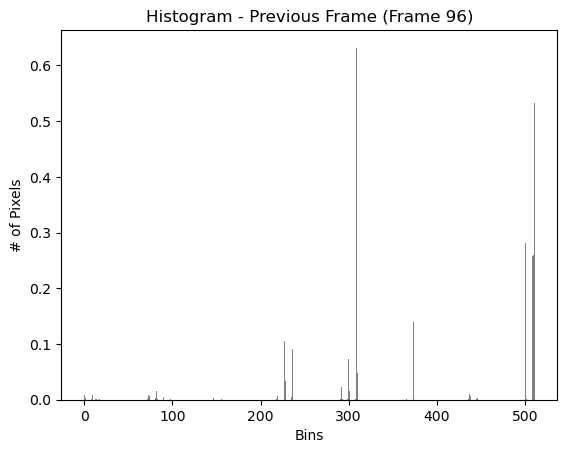

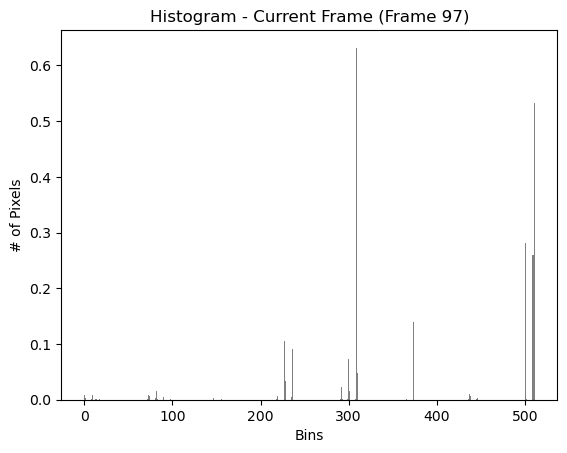

Hard cut detected at frame 98 (Pixel-based)


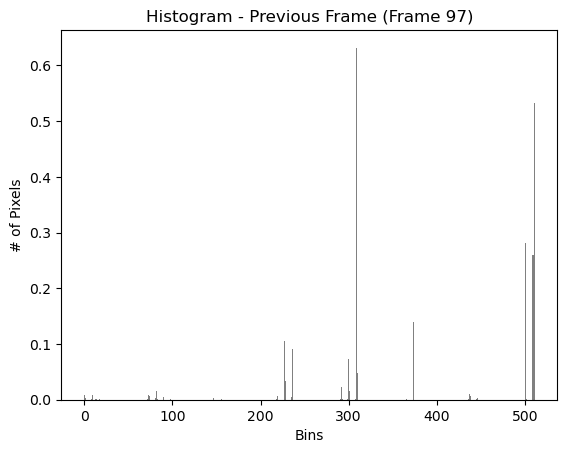

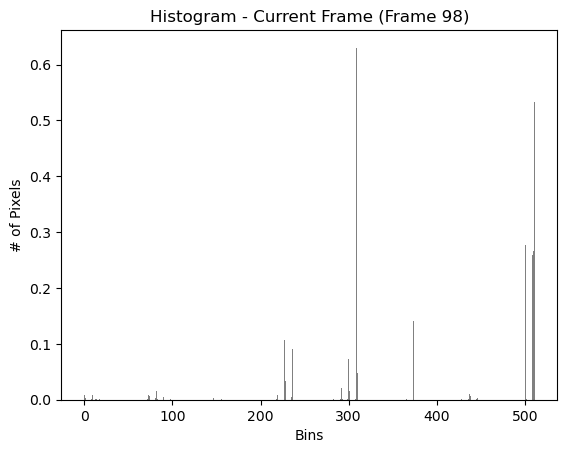

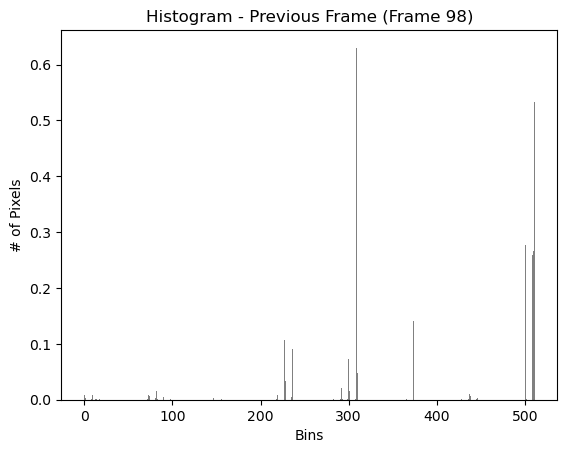

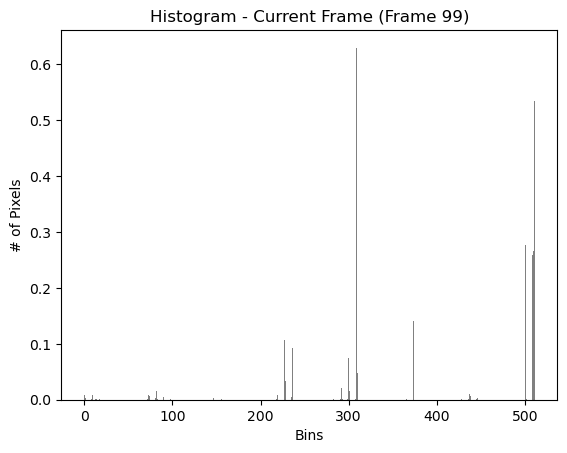

Hard cut detected at frame 100 (Pixel-based)


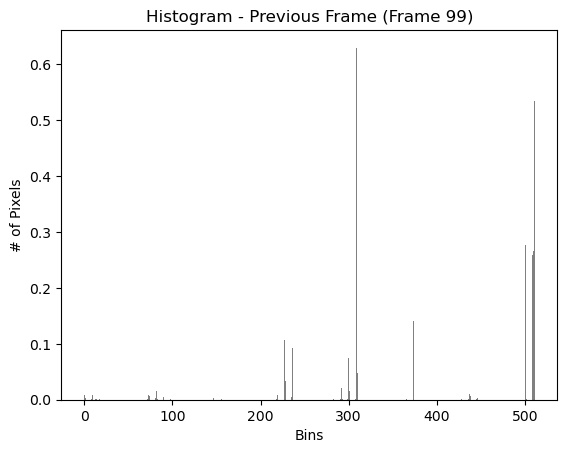

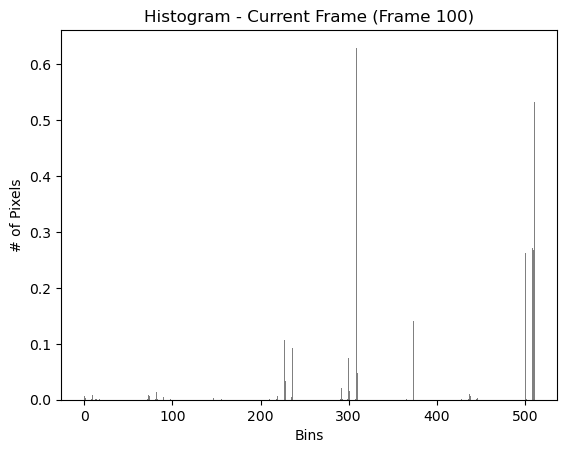

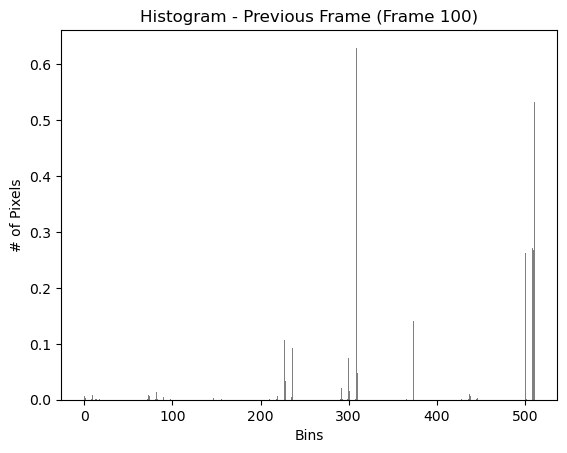

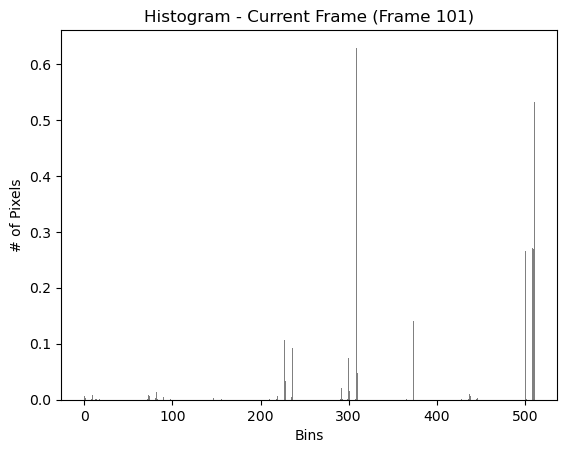

Hard cut detected at frame 102 (Pixel-based)


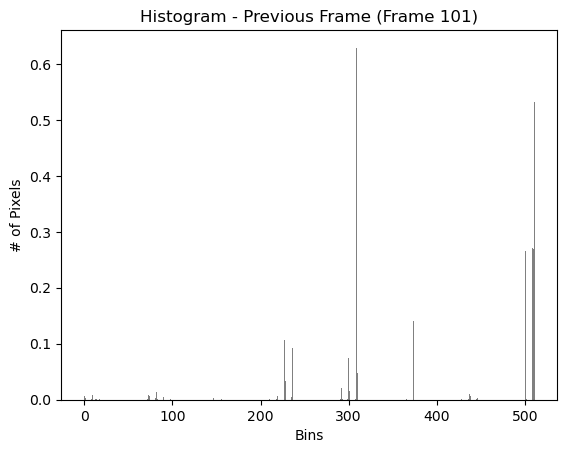

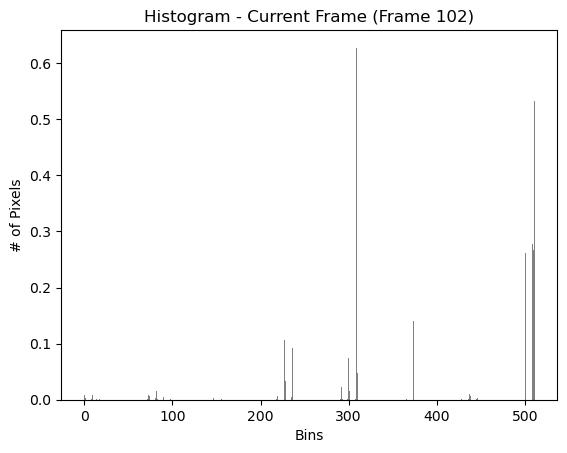

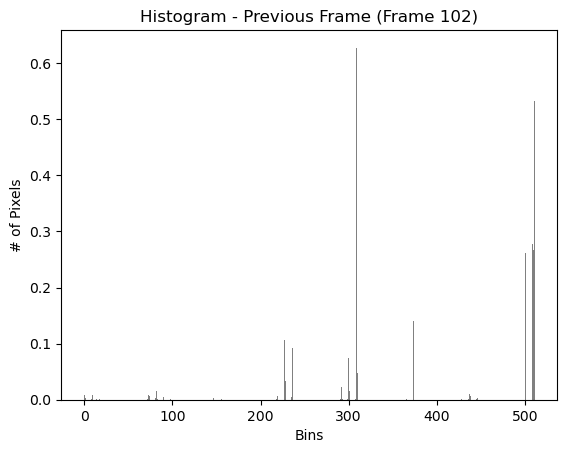

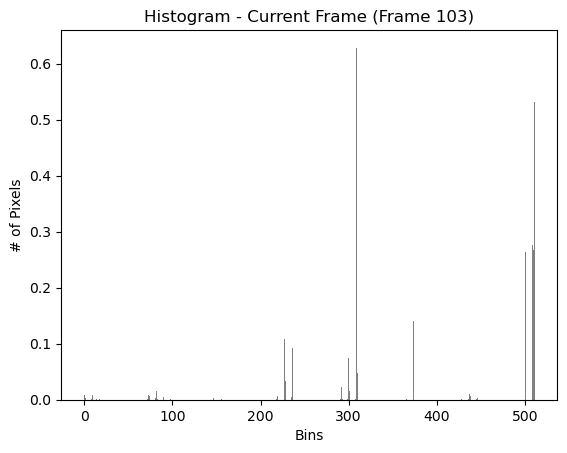

Hard cut detected at frame 104 (Pixel-based)


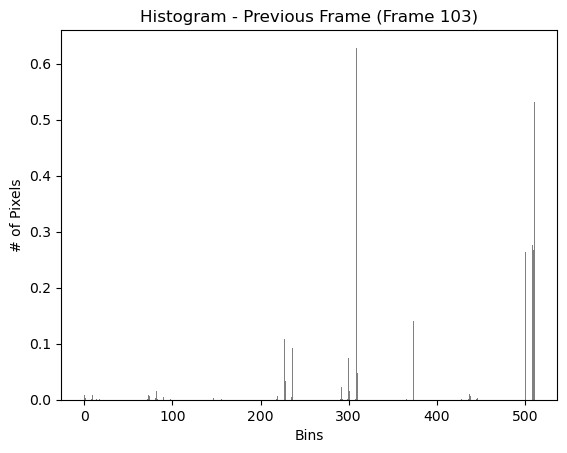

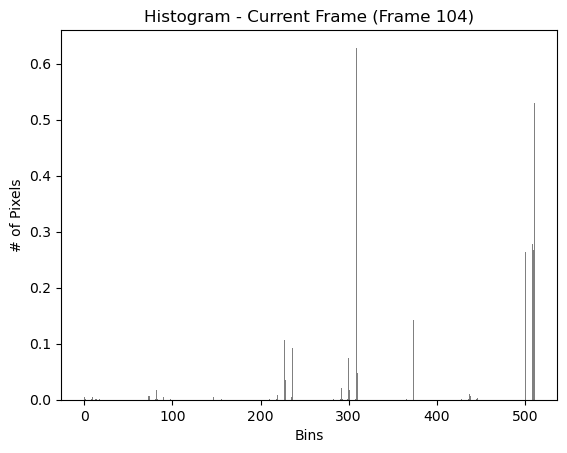

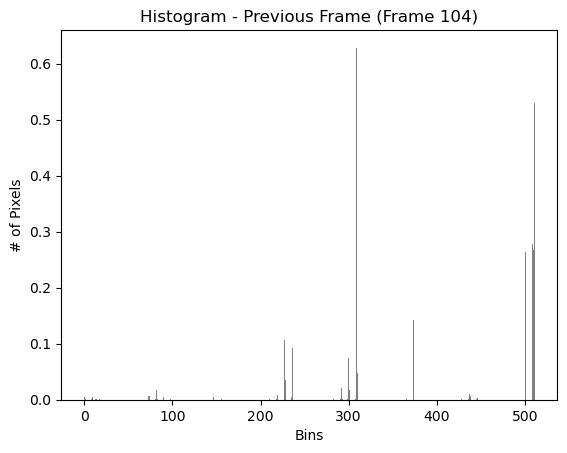

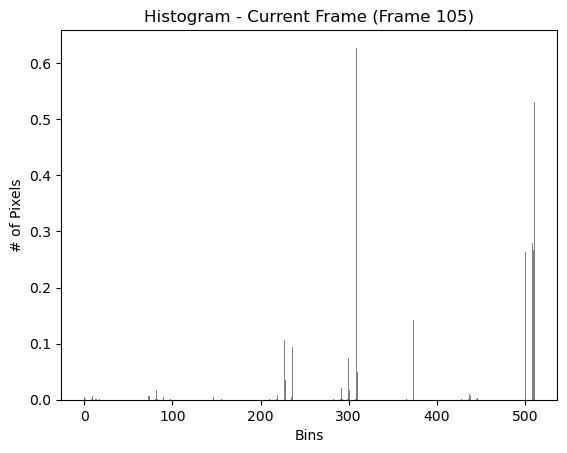

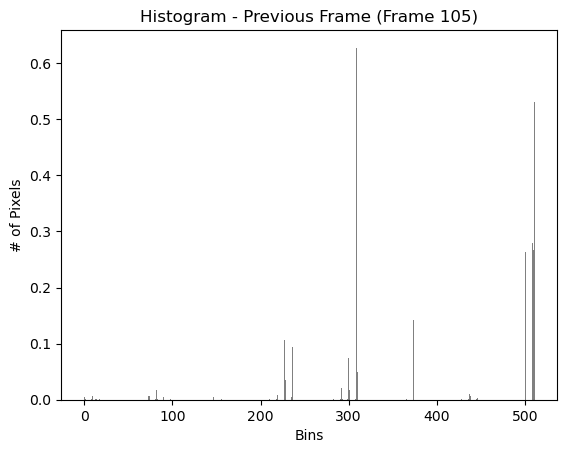

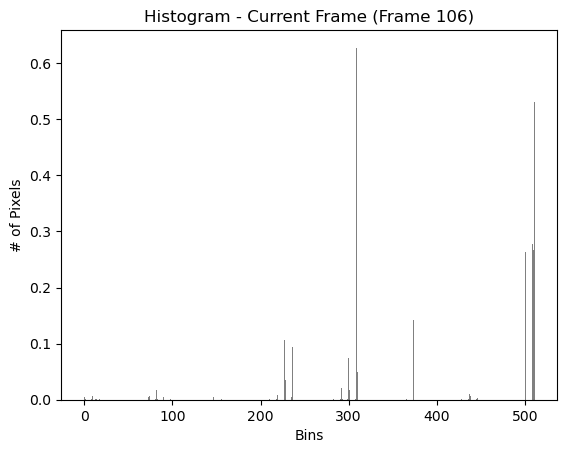

Hard cut detected at frame 107 (Pixel-based)


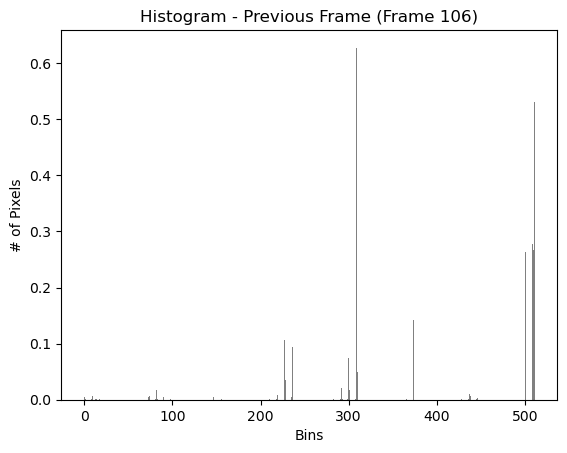

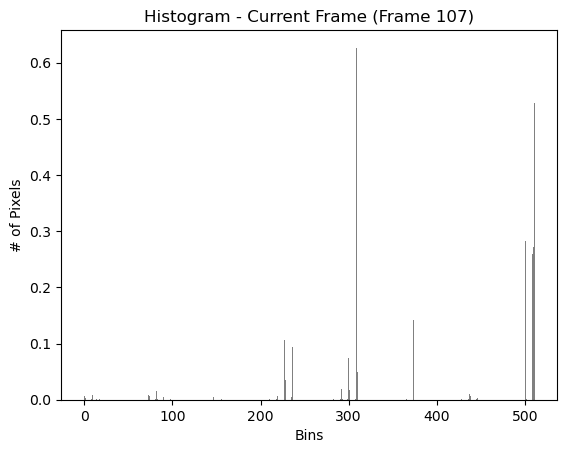

Hard cut detected at frame 108 (Pixel-based)


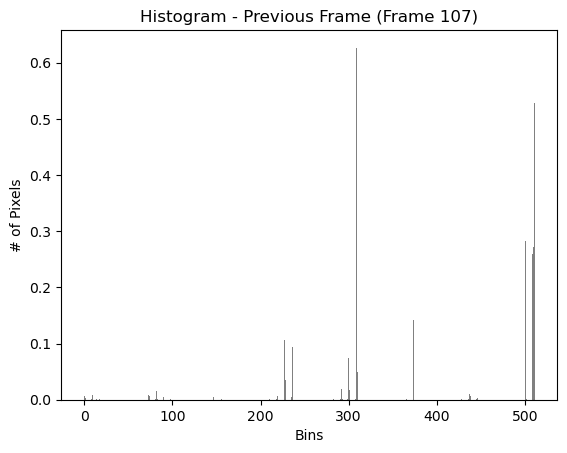

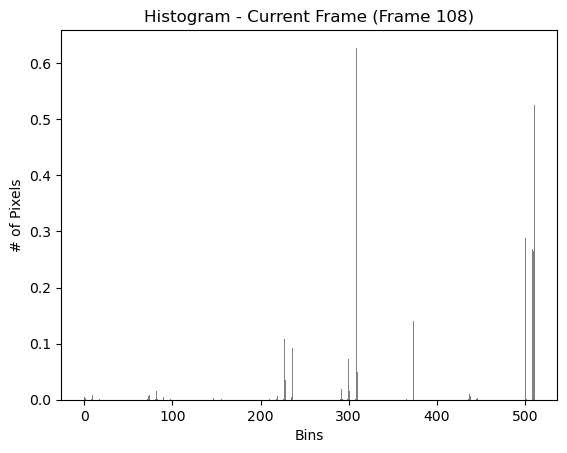

Hard cut detected at frame 109 (Pixel-based)


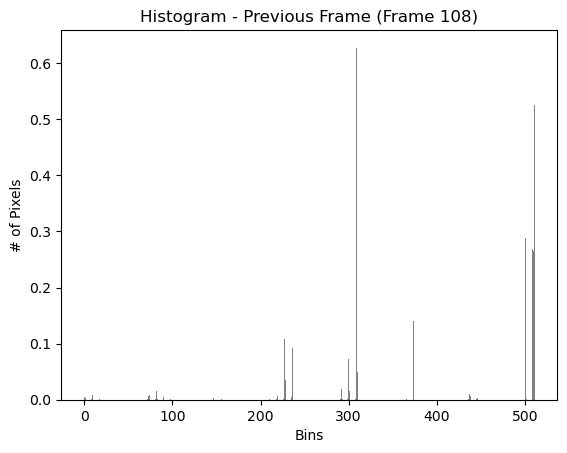

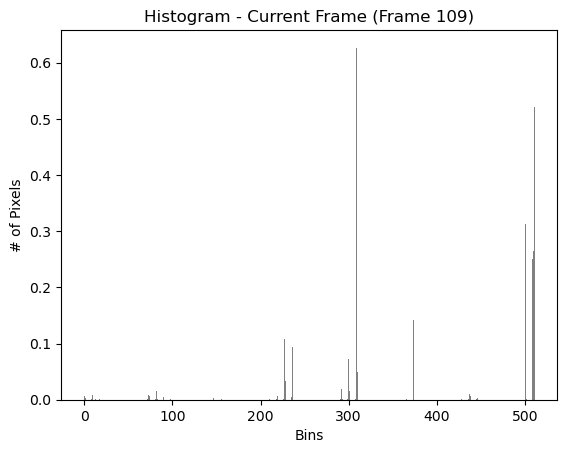

Hard cut detected at frame 110 (Pixel-based)


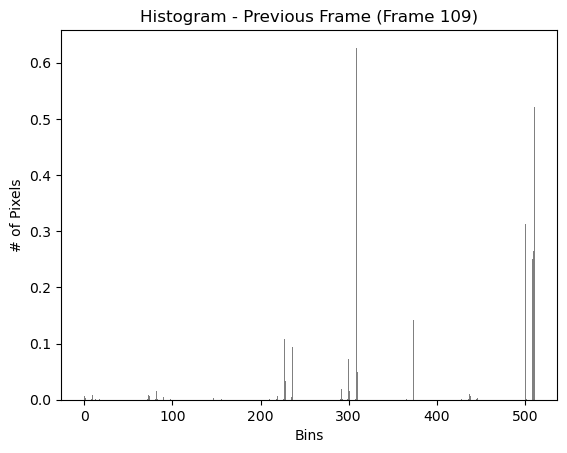

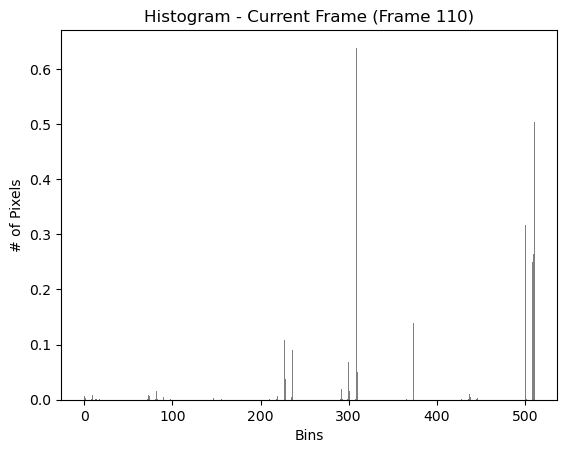

Hard cut detected at frame 111 (Pixel-based)


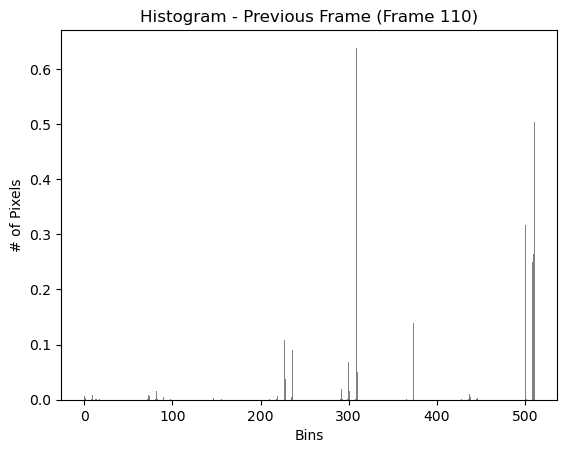

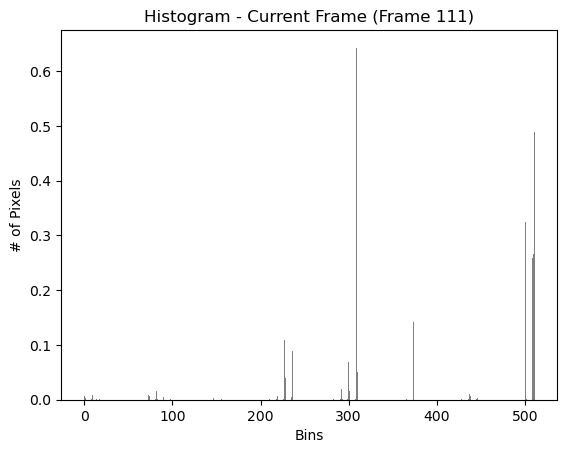

Hard cut detected at frame 112 (Pixel-based)


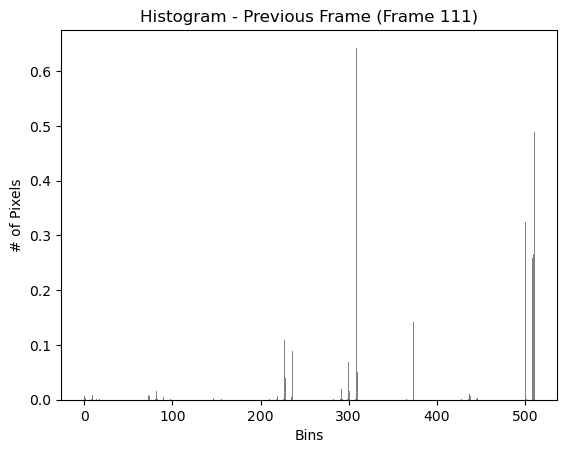

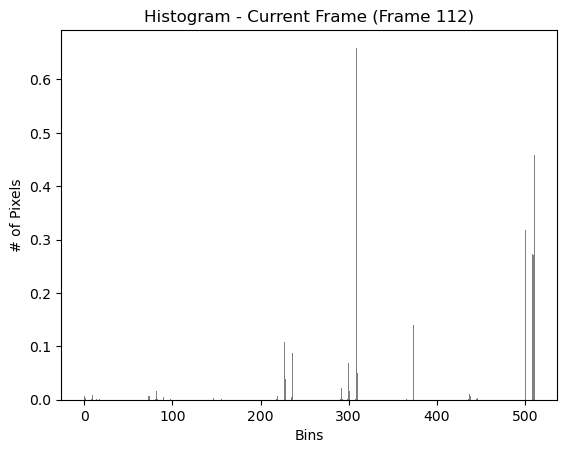

Hard cut detected at frame 113 (Pixel-based)


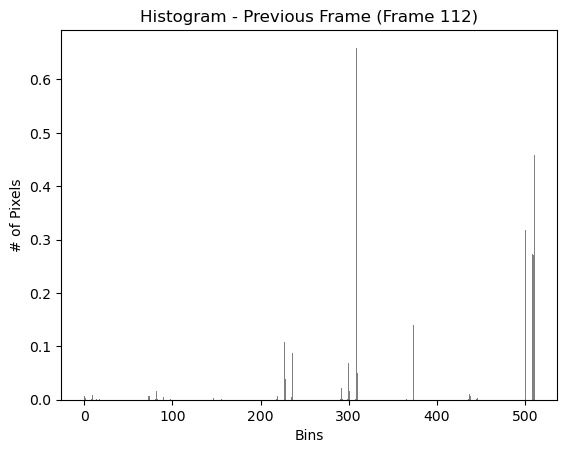

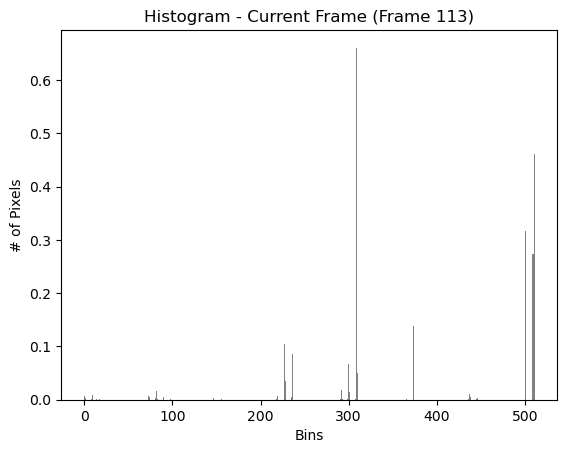

Hard cut detected at frame 114 (Pixel-based)


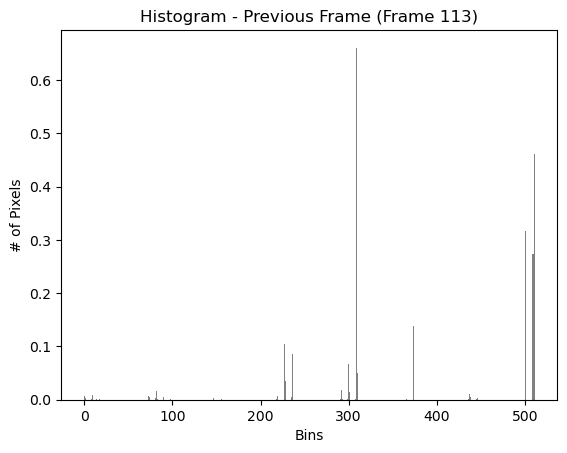

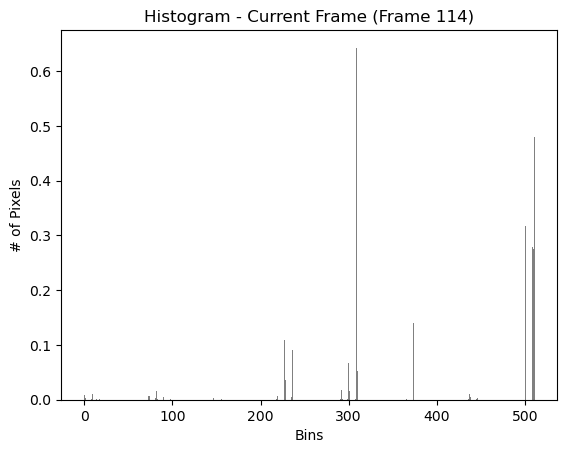

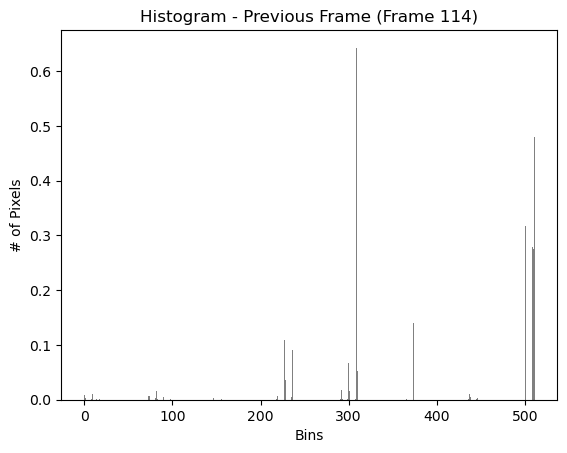

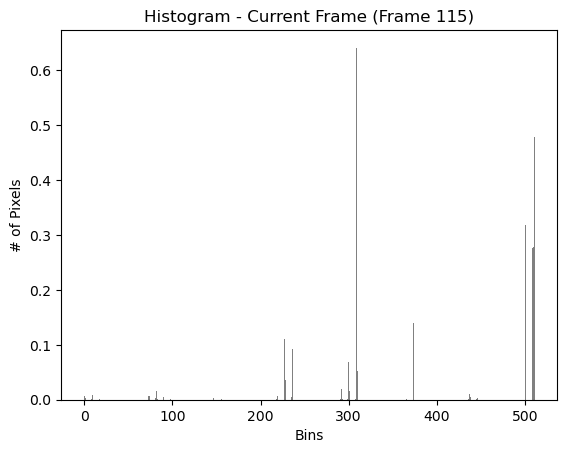

Hard cut detected at frame 116 (Pixel-based)


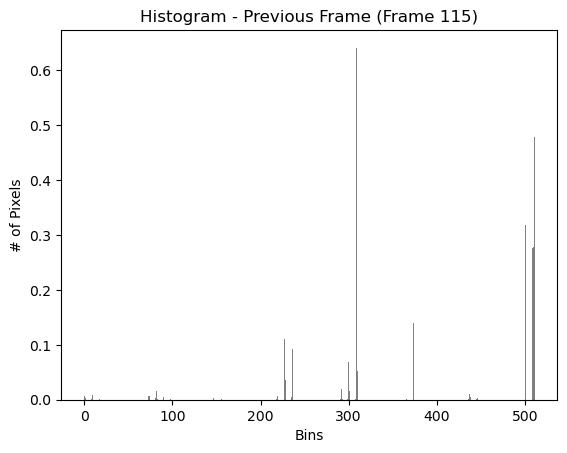

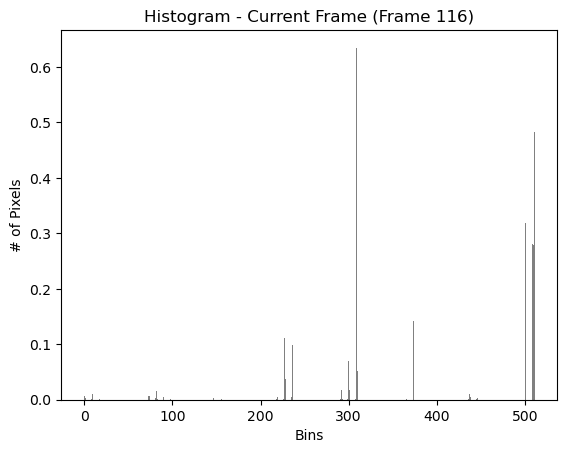

Hard cut detected at frame 117 (Pixel-based)


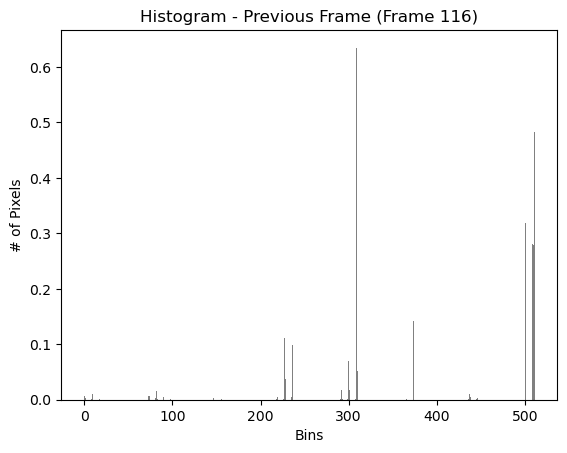

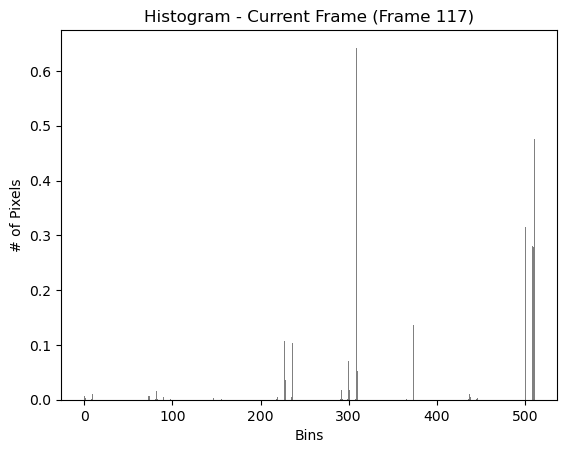

Hard cut detected at frame 118 (Pixel-based)


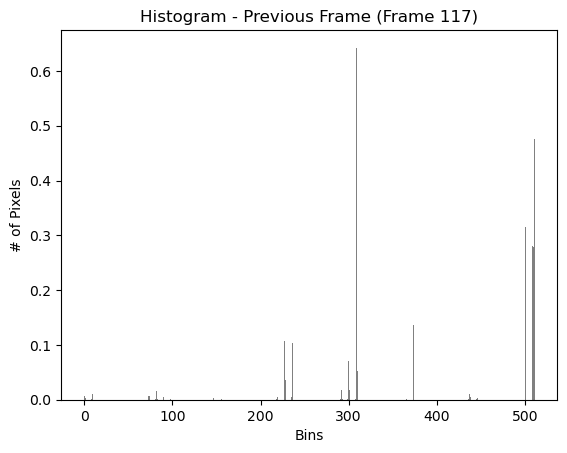

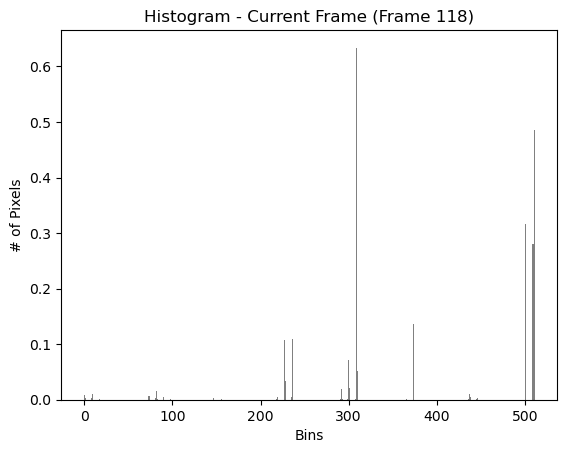

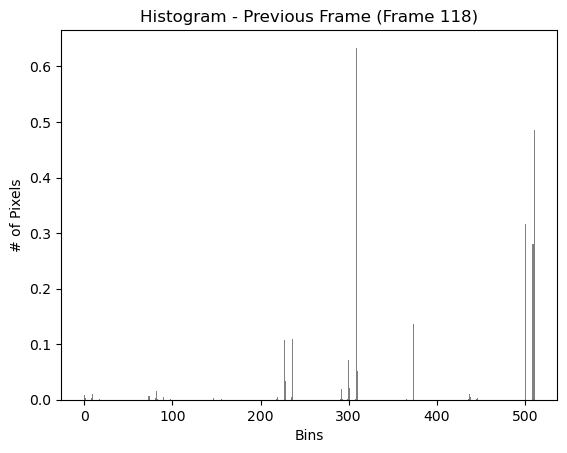

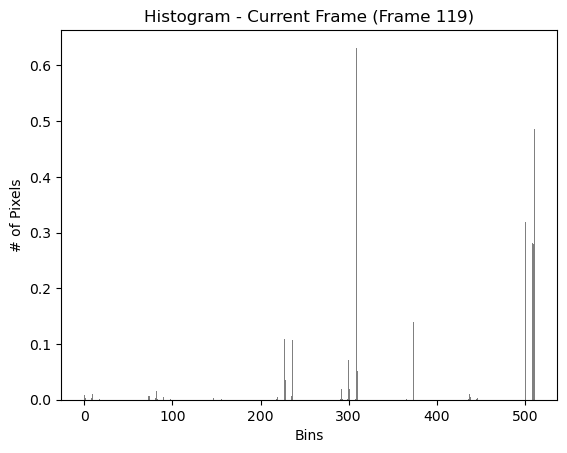

Hard cut detected at frame 120 (Pixel-based)


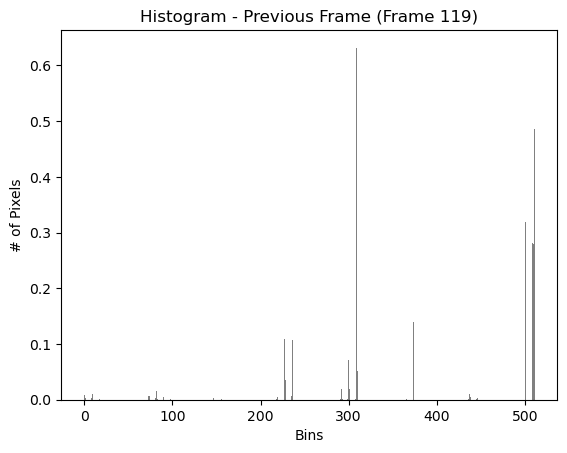

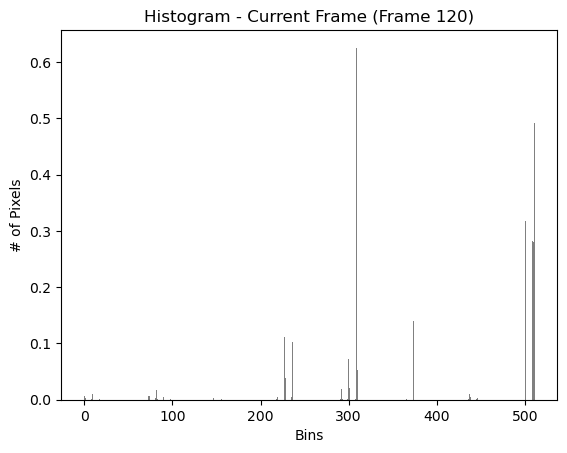

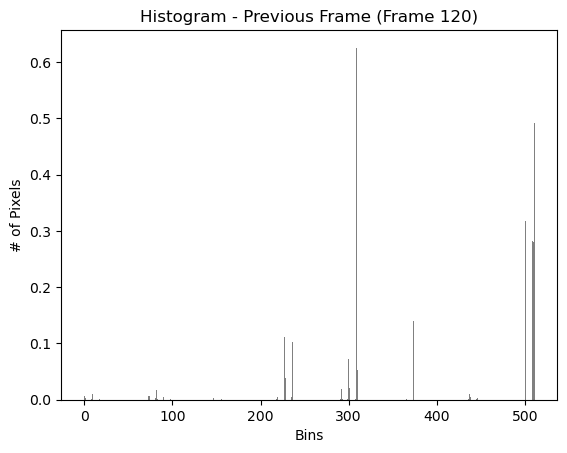

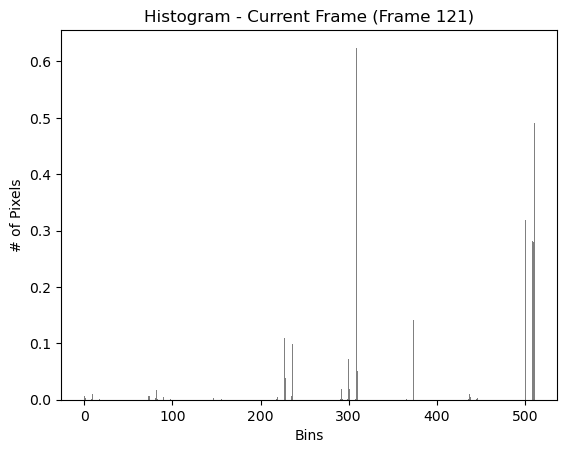

Hard cut detected at frame 122 (Pixel-based)


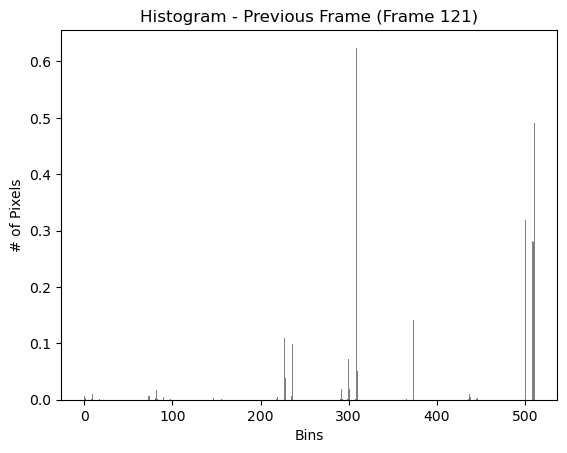

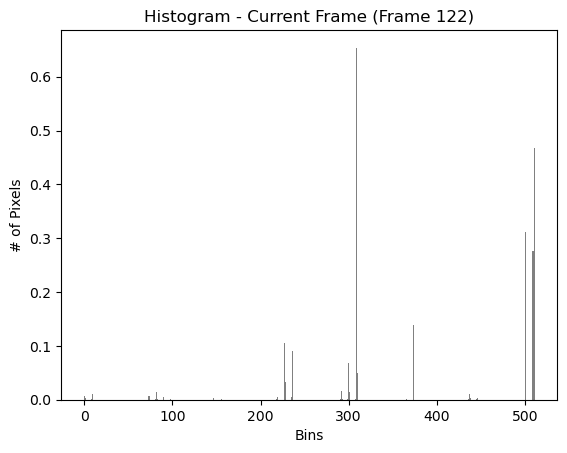

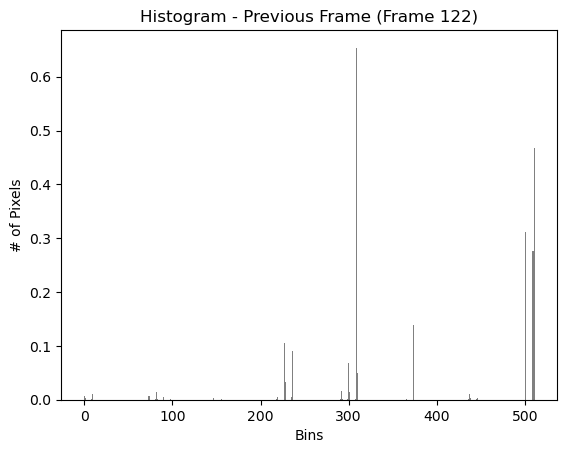

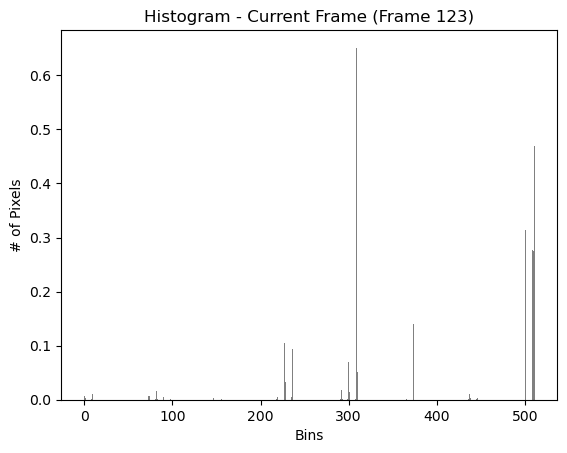

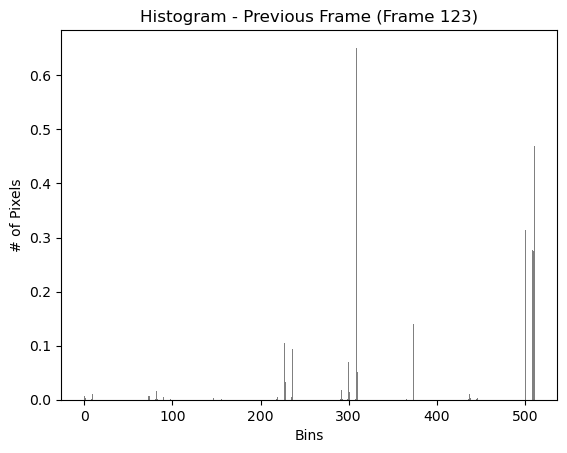

...

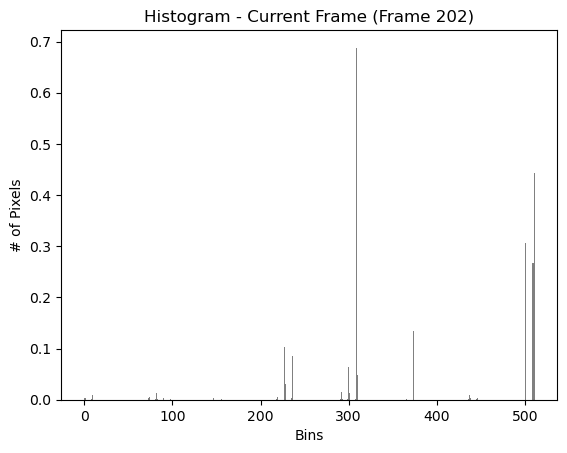

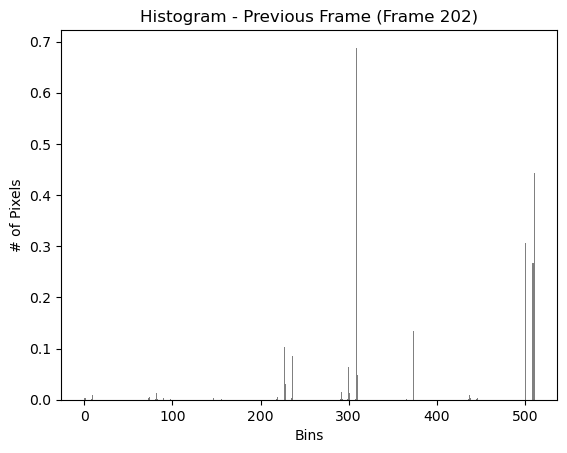

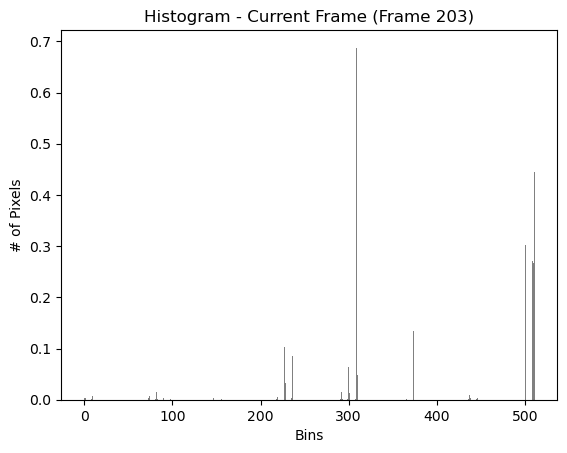

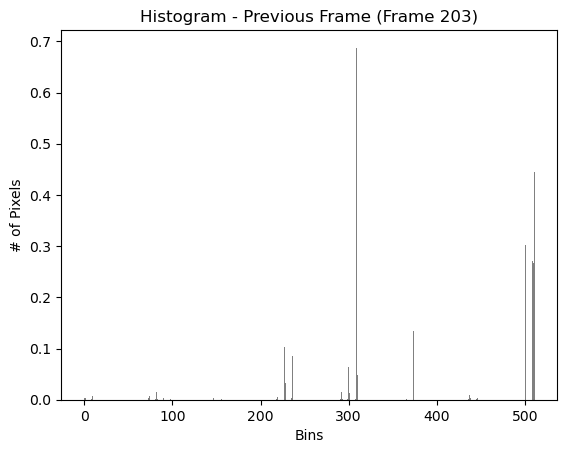

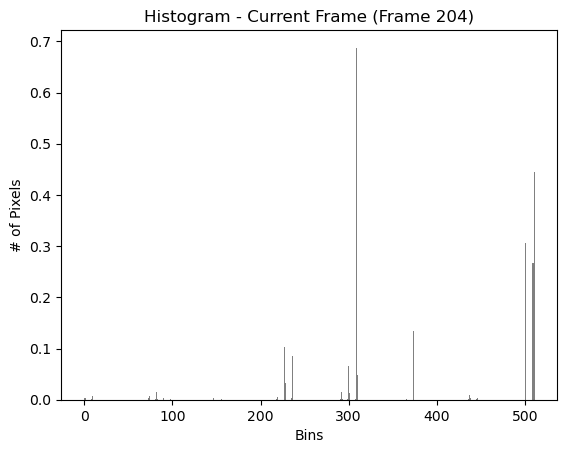

Hard cut detected at frame 205 (Pixel-based)


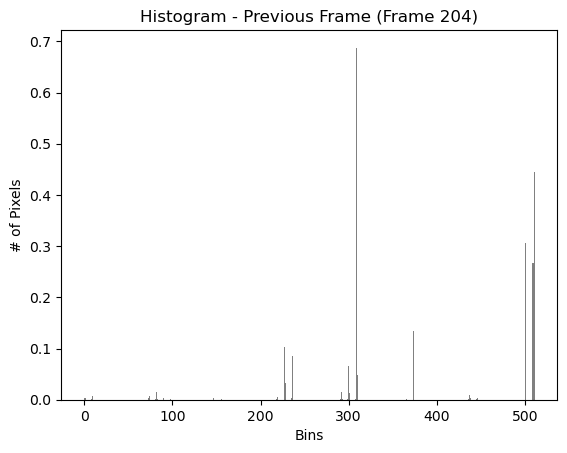

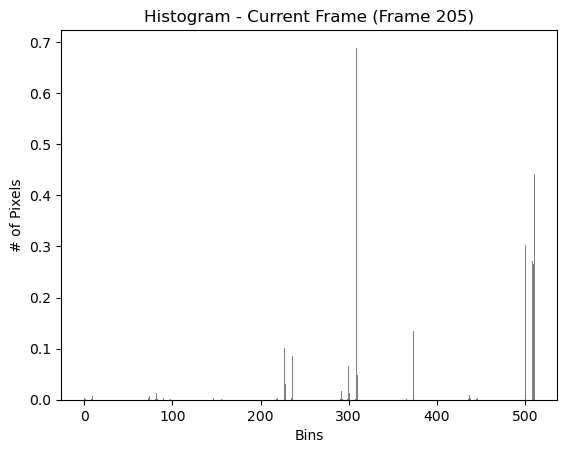

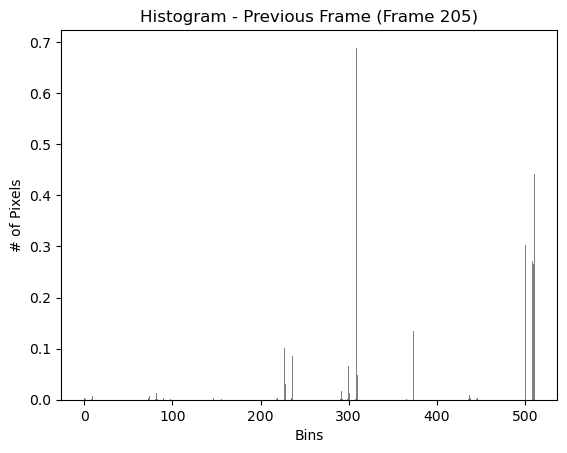

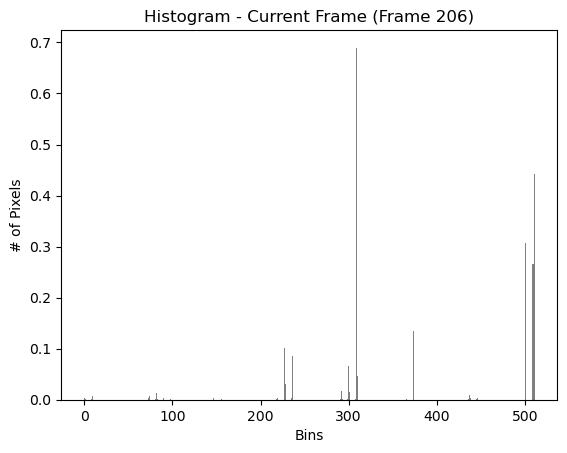

Hard cut detected at frame 207 (Pixel-based)


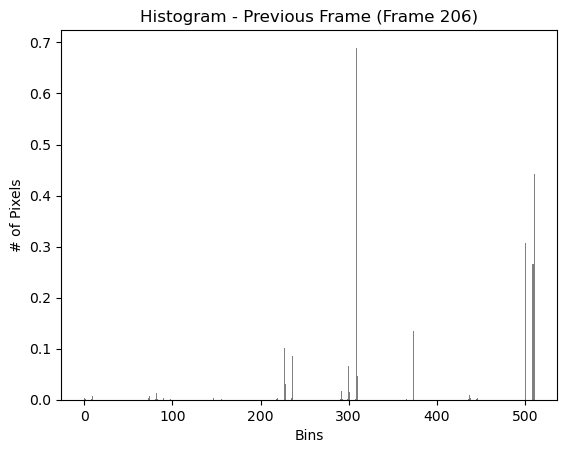

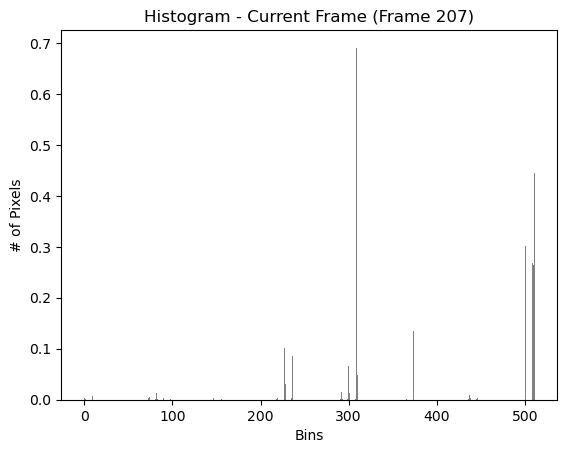

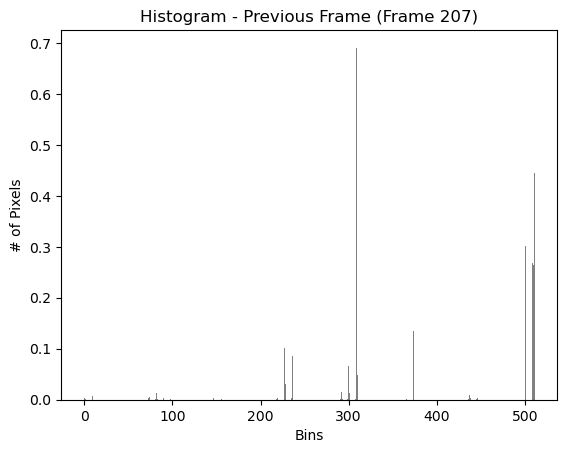

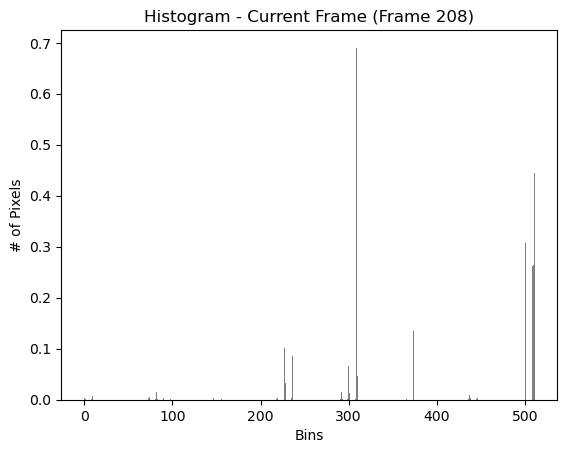

Hard cut detected at frame 209 (Pixel-based)


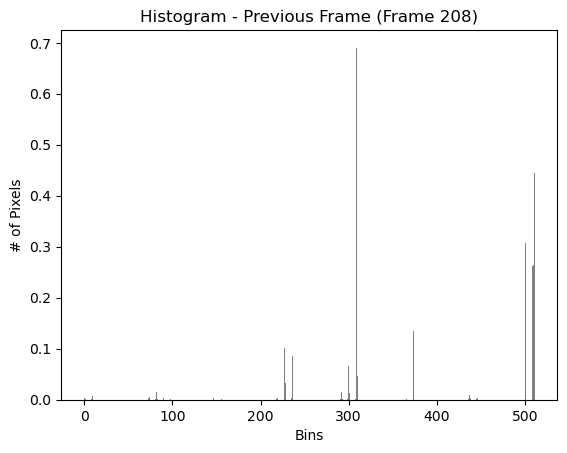

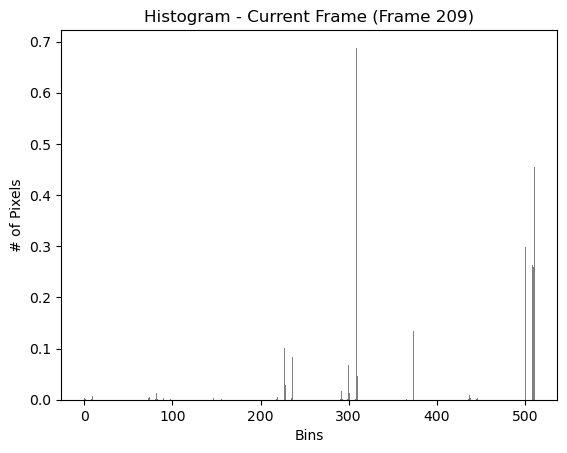

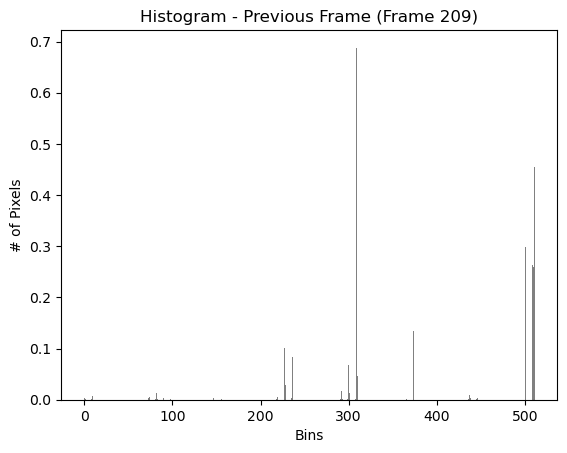

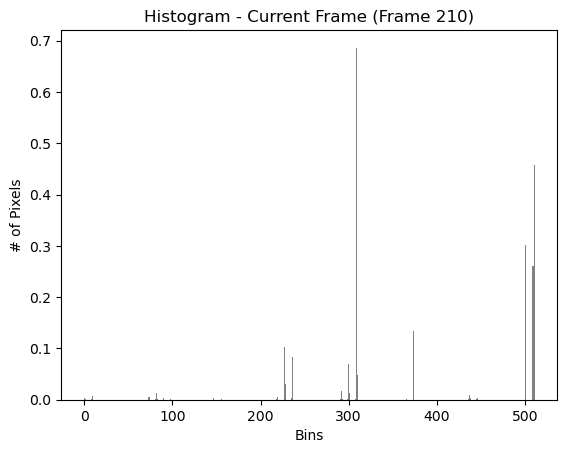

Hard cut detected at frame 211 (Pixel-based)


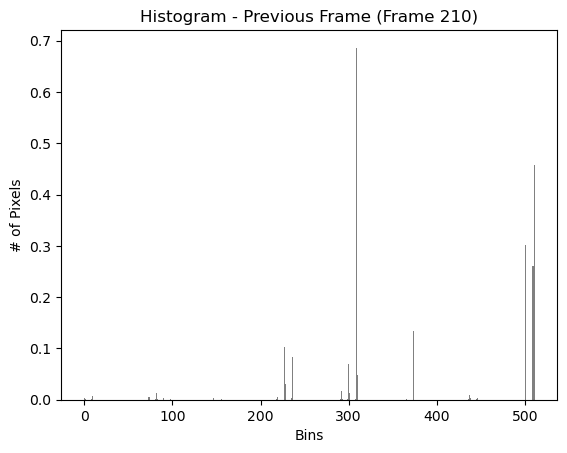

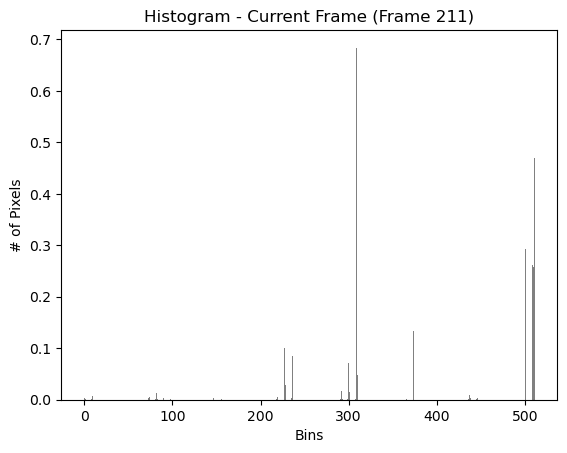

Hard cut detected at frame 212 (Pixel-based)


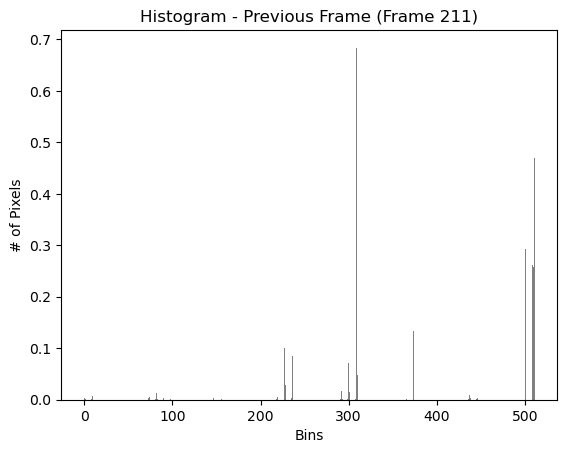

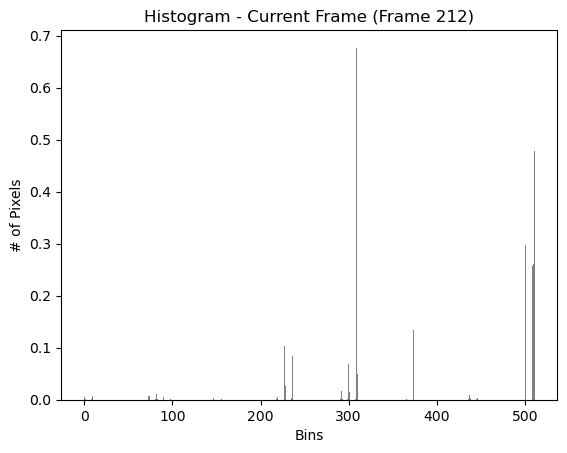

Hard cut detected at frame 213 (Pixel-based)


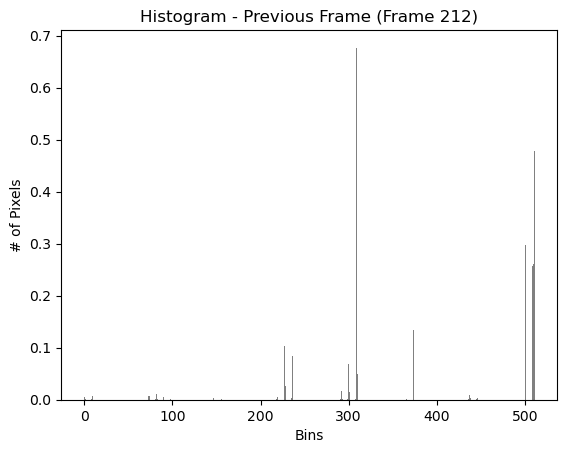

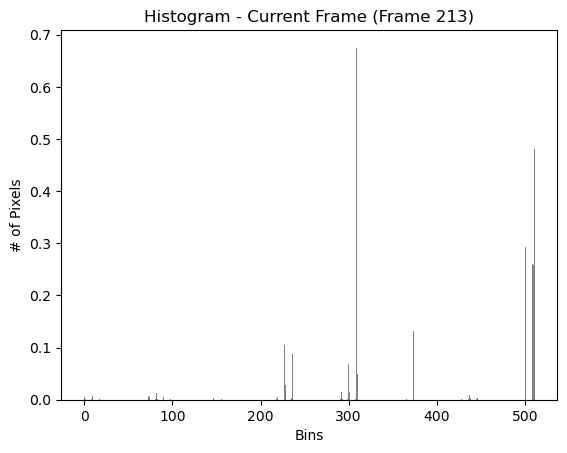

Hard cut detected at frame 214 (Pixel-based)


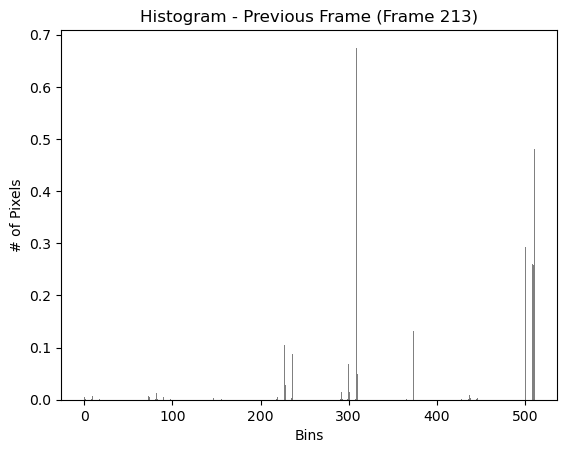

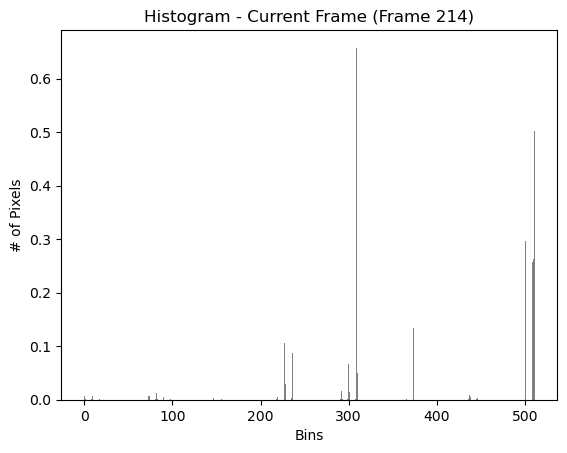

Hard cut detected at frame 215 (Pixel-based)


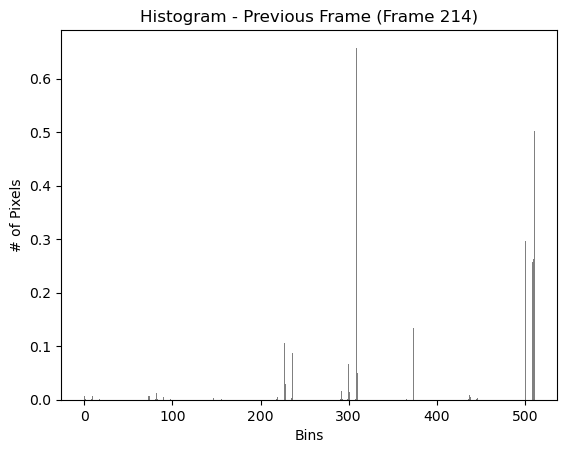

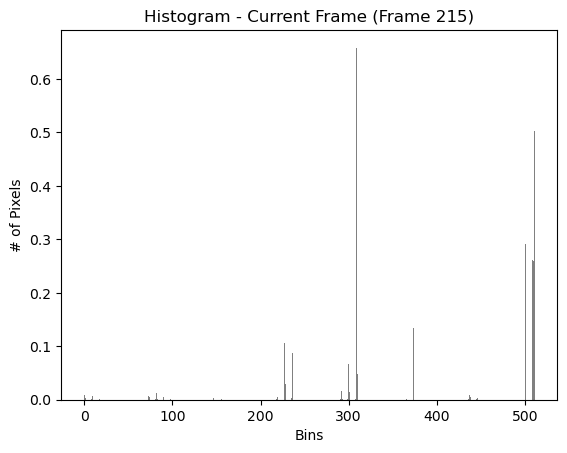

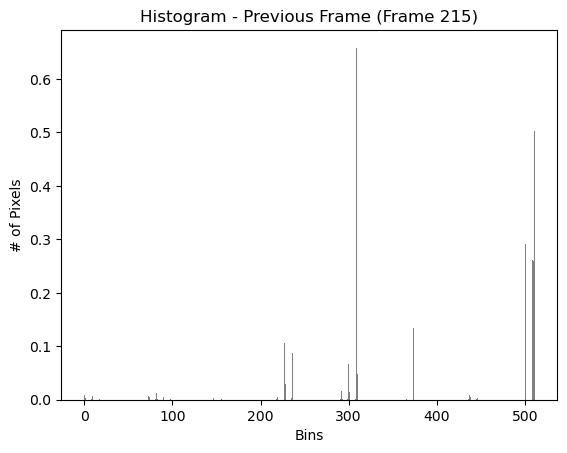

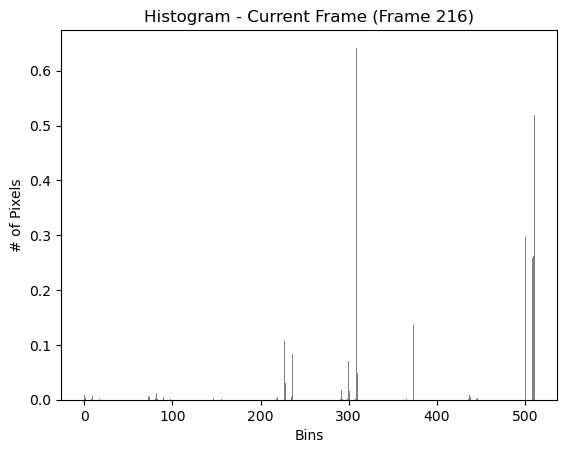

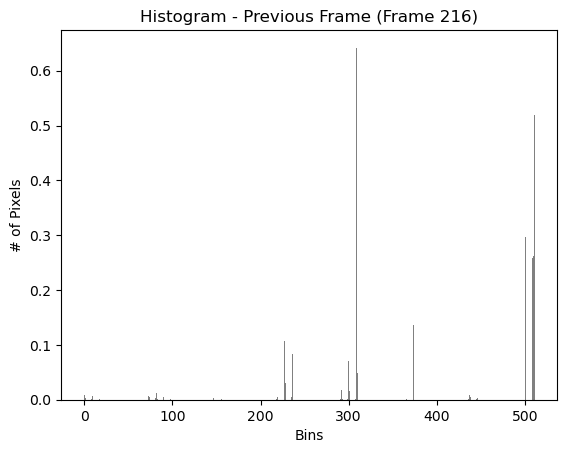

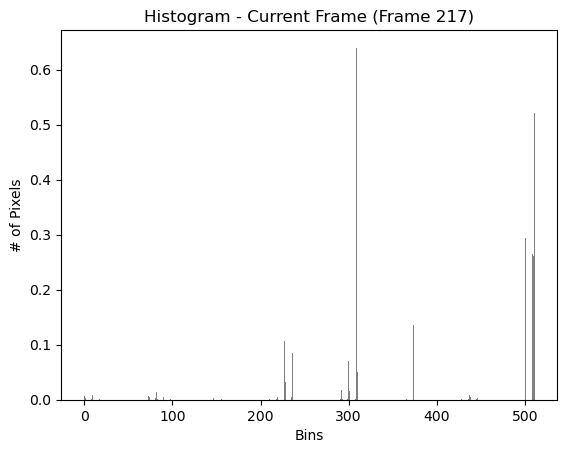

Hard cut detected at frame 218 (Pixel-based)


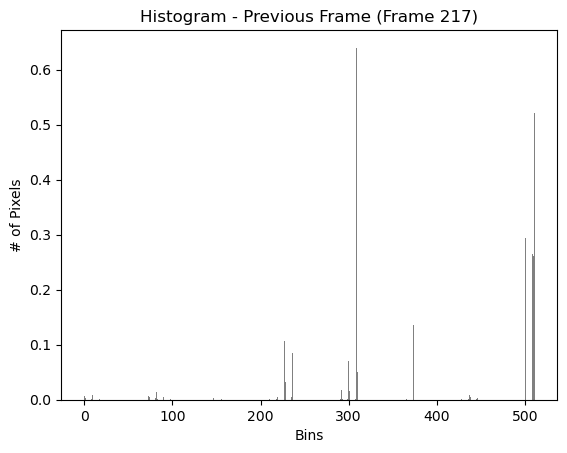

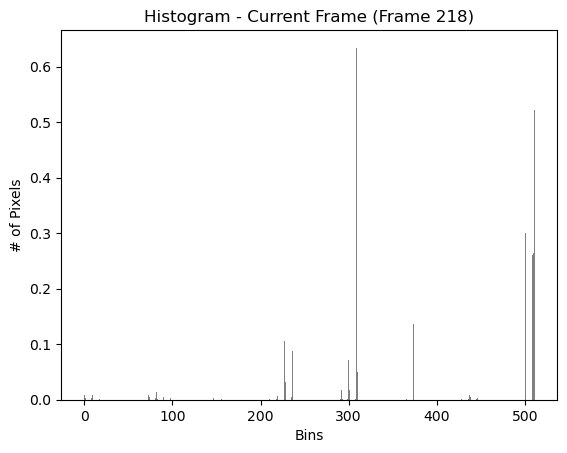

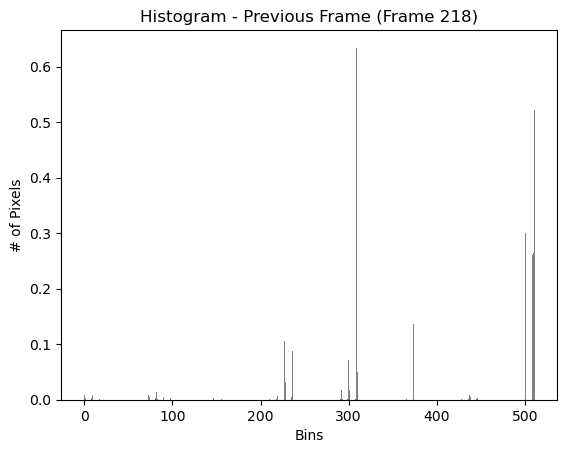

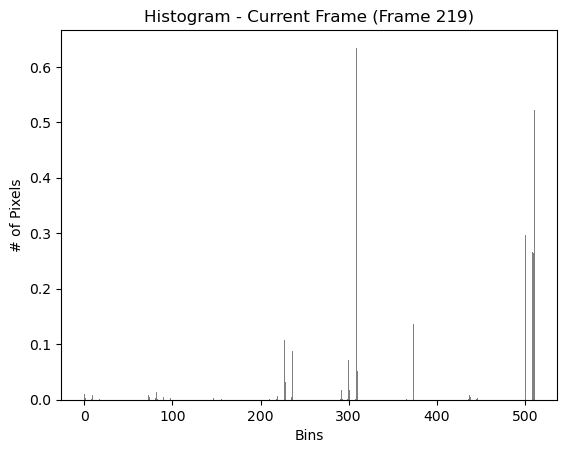

Hard cut detected at frame 220 (Pixel-based)


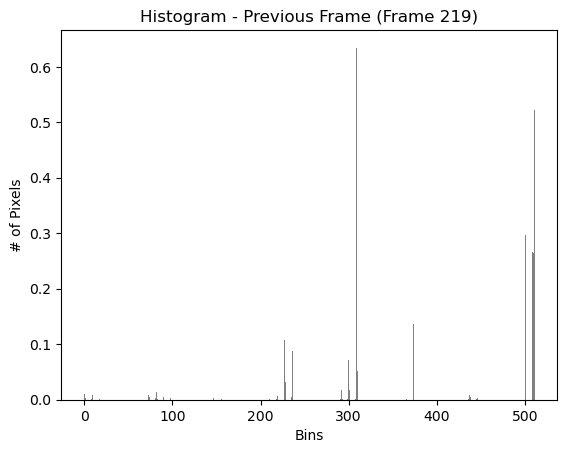

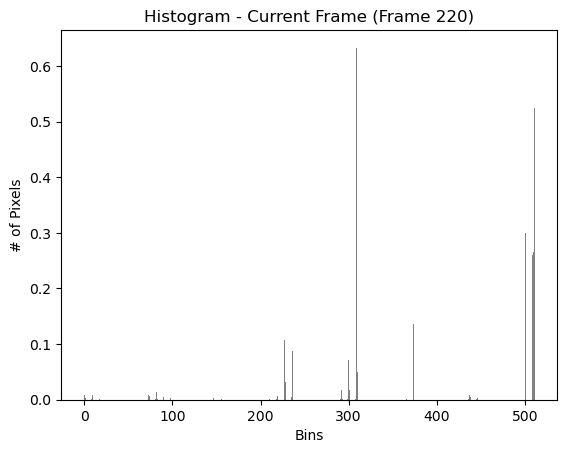

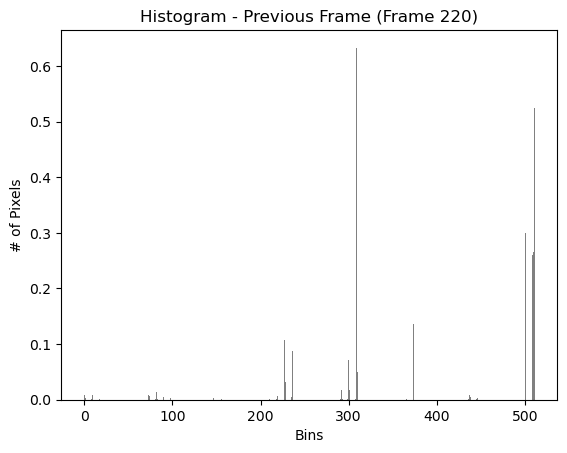

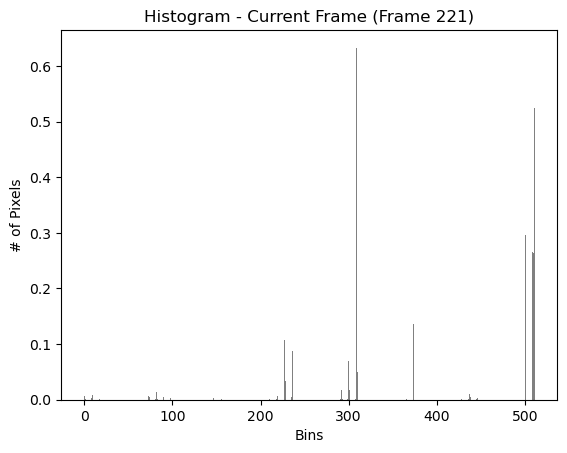

Hard cut detected at frame 222 (Pixel-based)


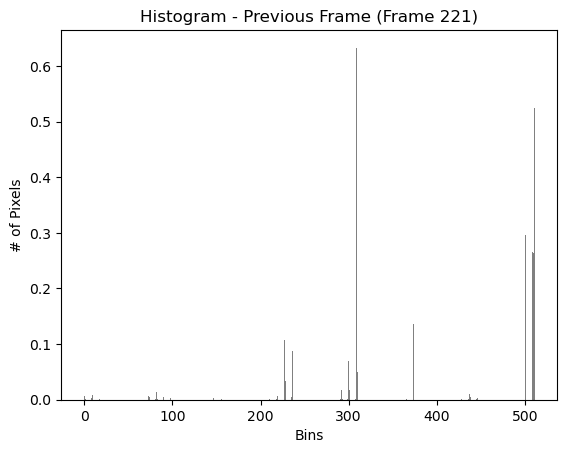

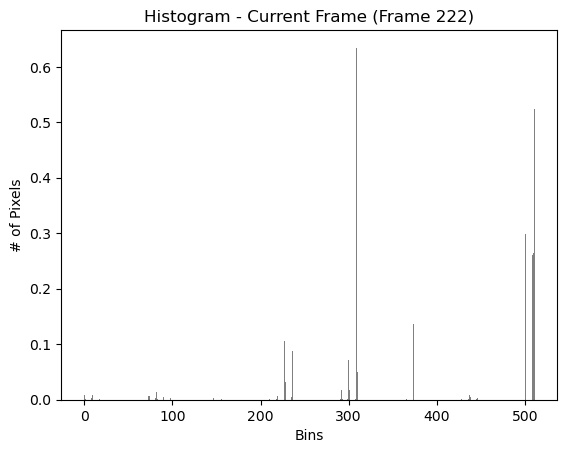

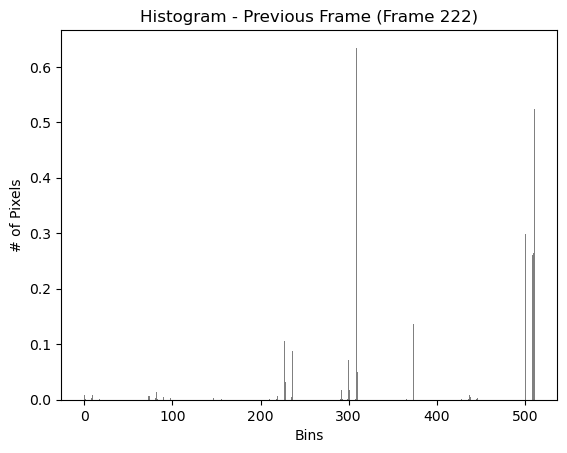

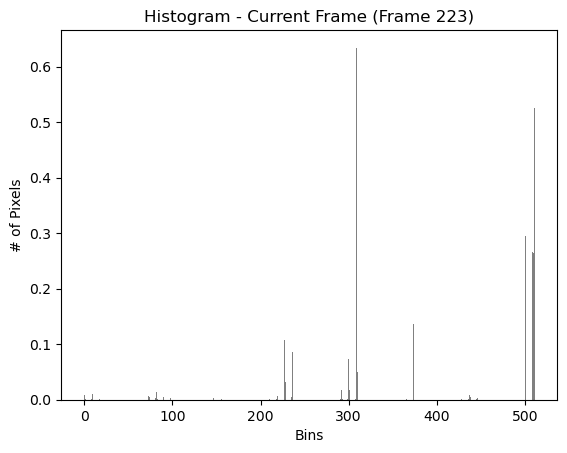

Hard cut detected at frame 224 (Pixel-based)


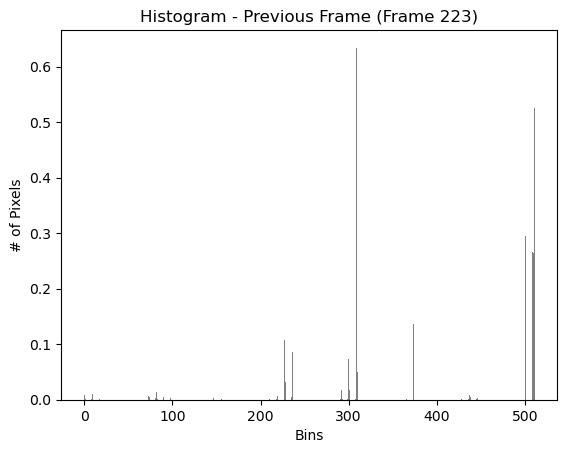

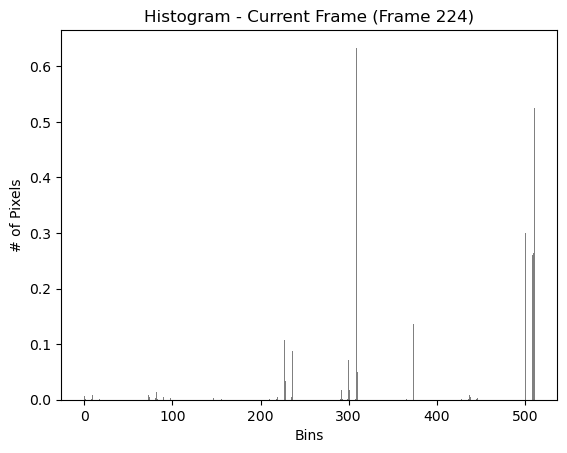

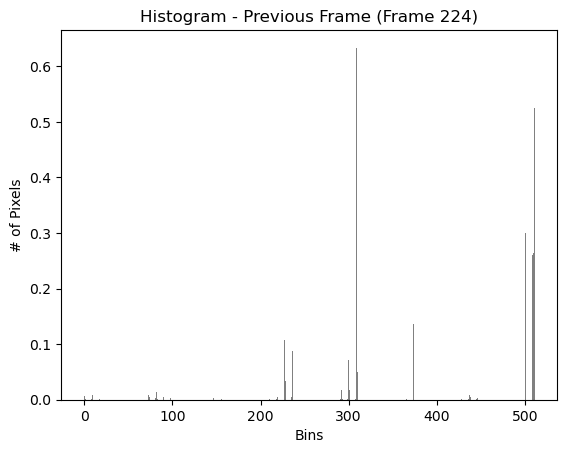

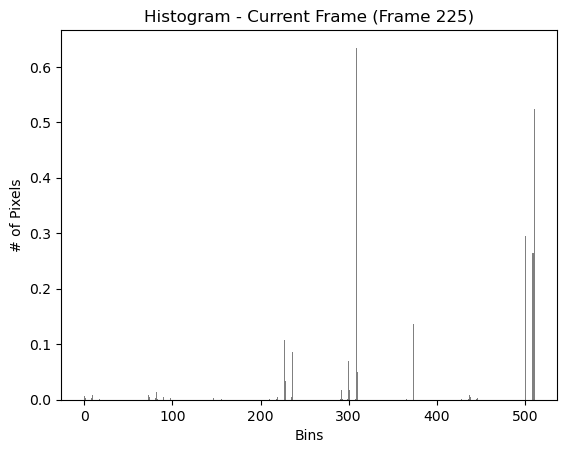

Hard cut detected at frame 226 (Pixel-based)


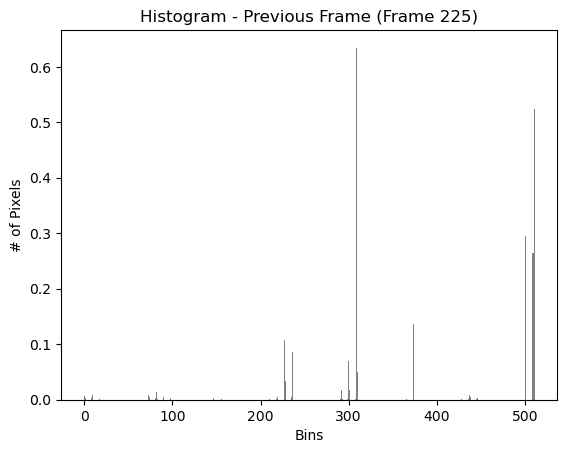

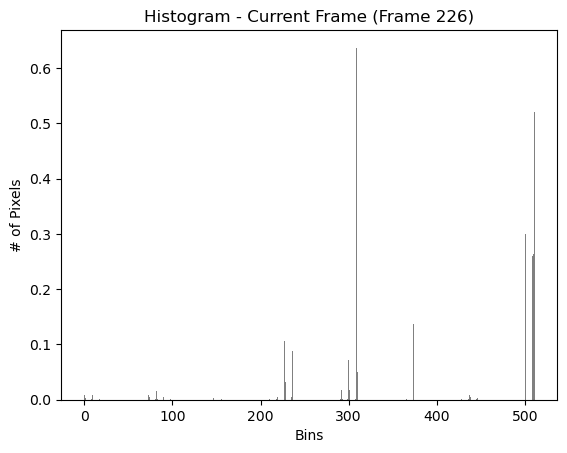

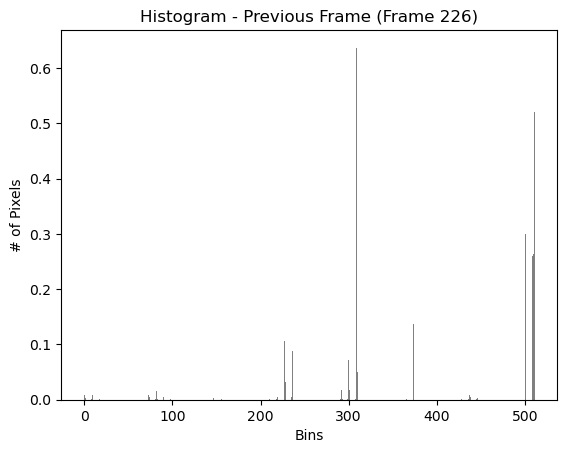

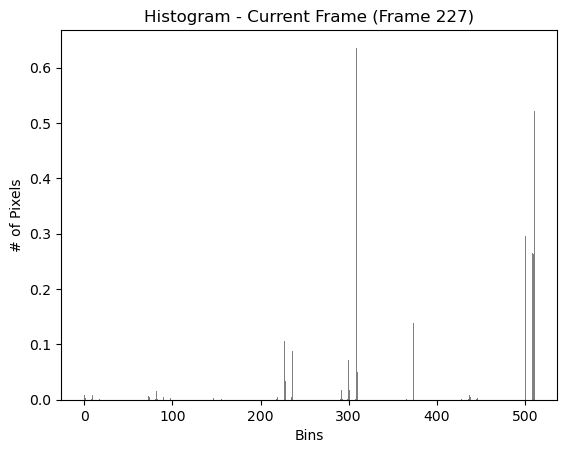

Hard cut detected at frame 228 (Pixel-based)


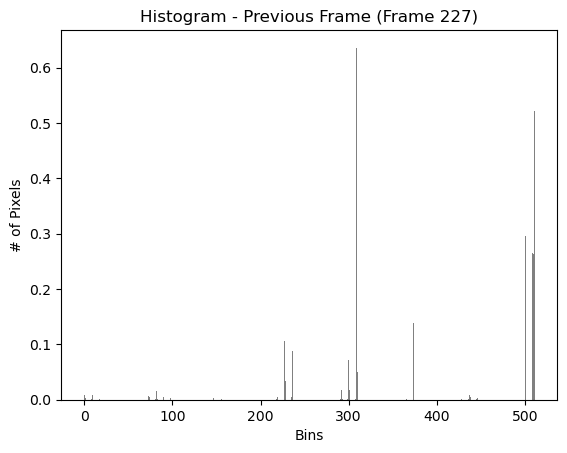

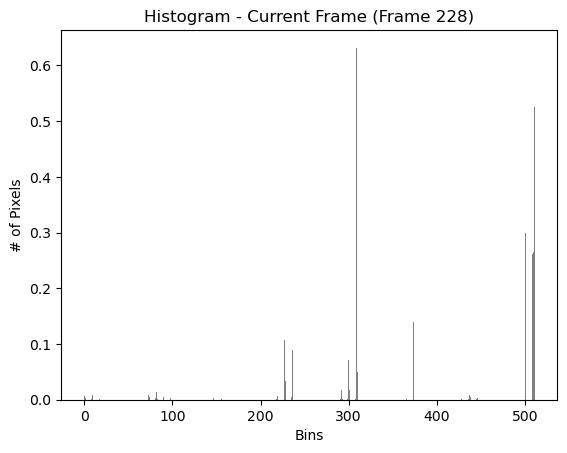

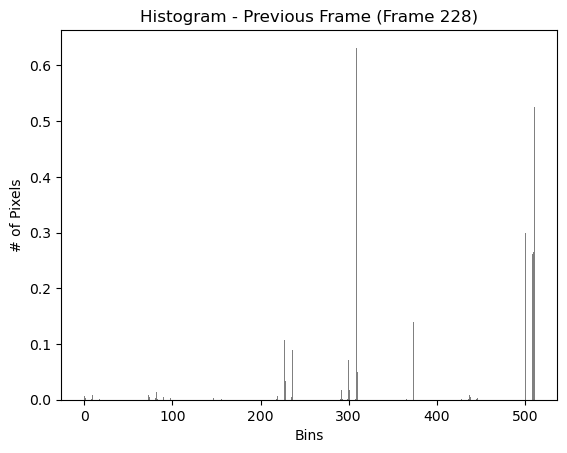

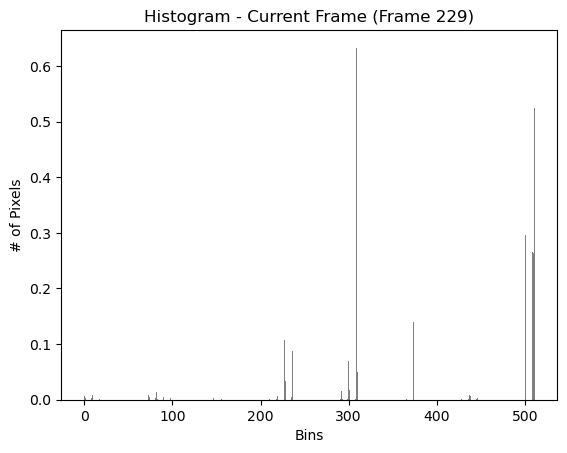

Hard cut detected at frame 230 (Pixel-based)


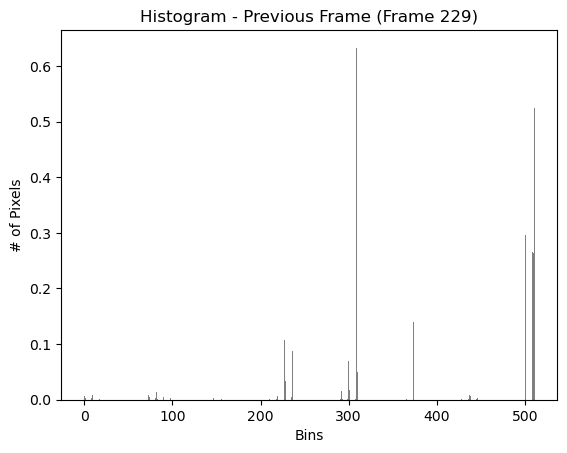

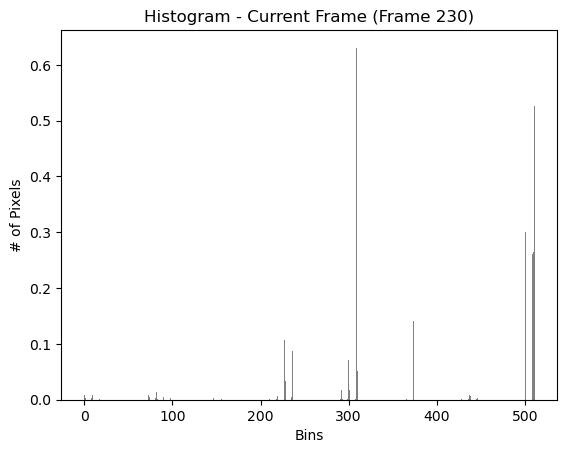

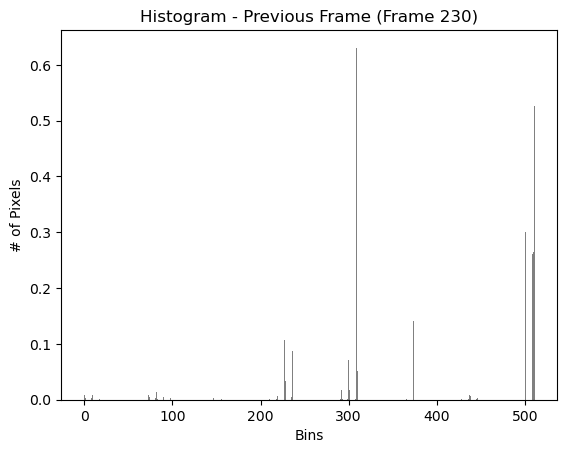

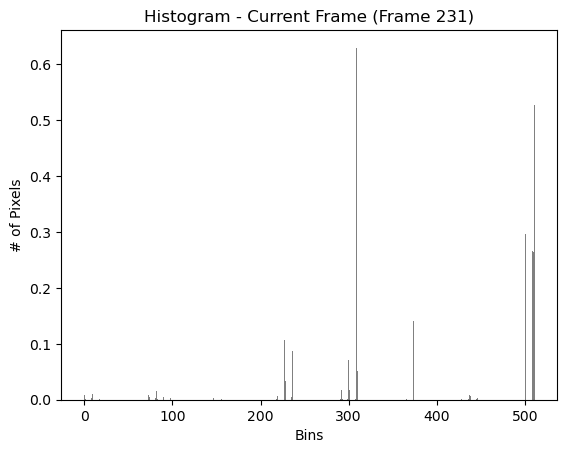

Hard cut detected at frame 232 (Pixel-based)


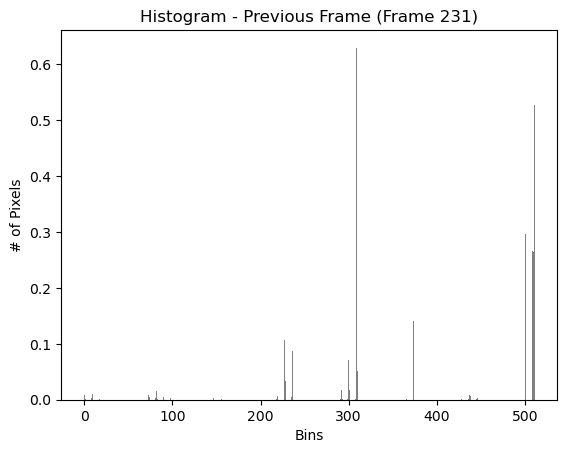

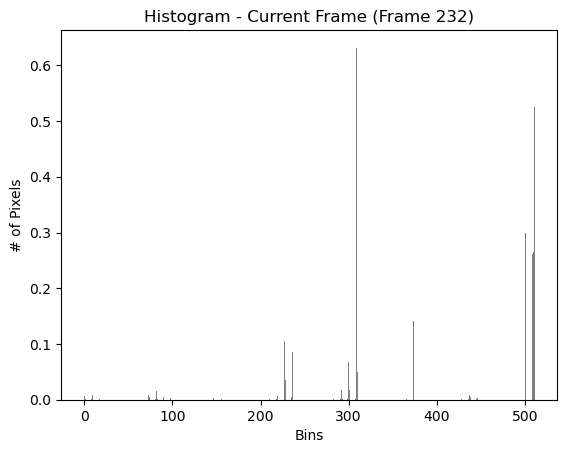

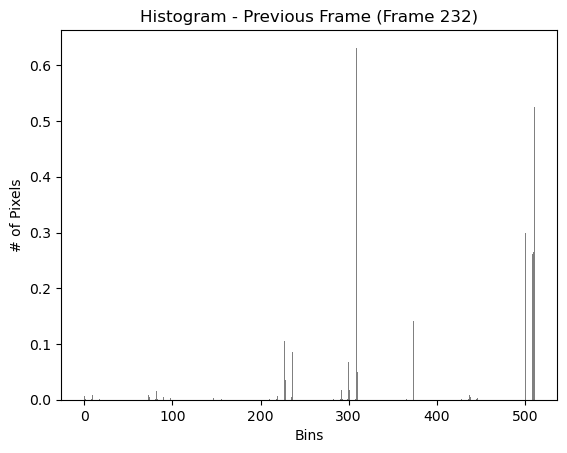

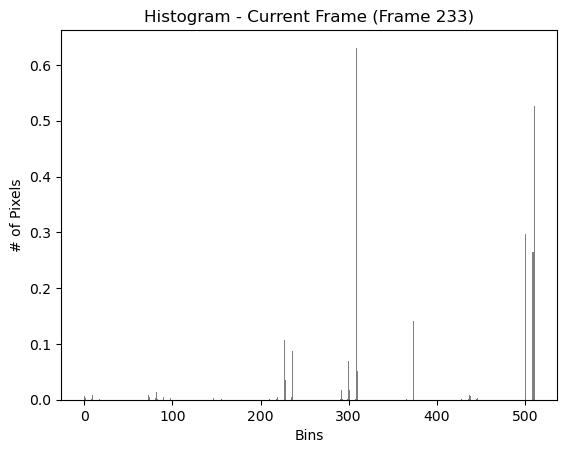

Hard cut detected at frame 234 (Pixel-based)


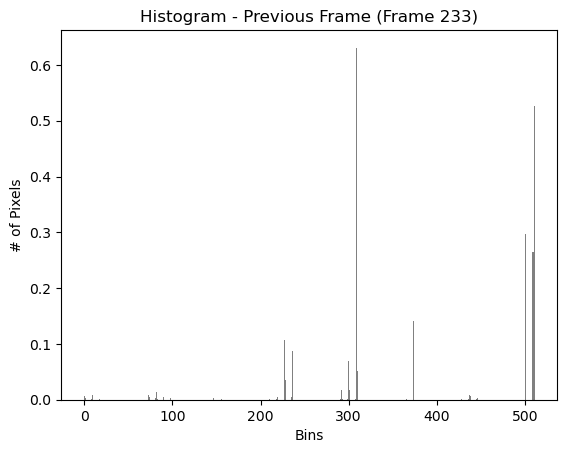

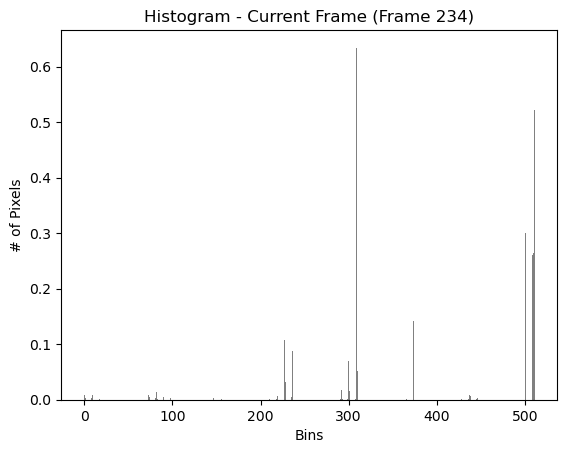

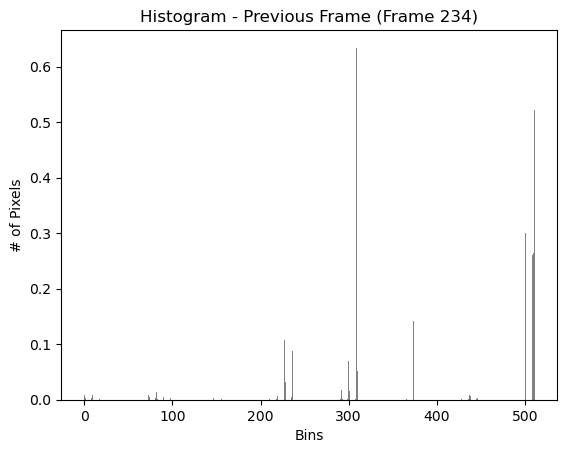

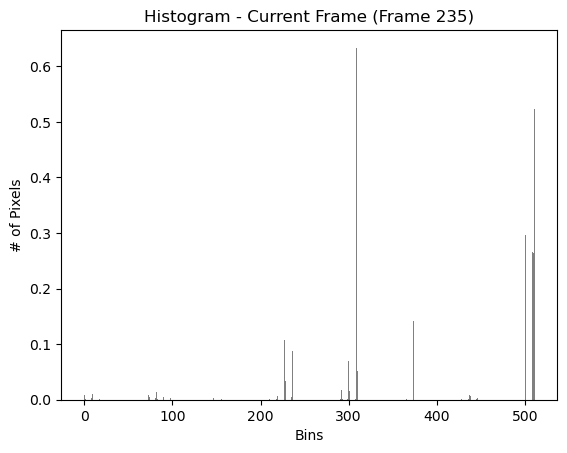

Hard cut detected at frame 236 (Pixel-based)


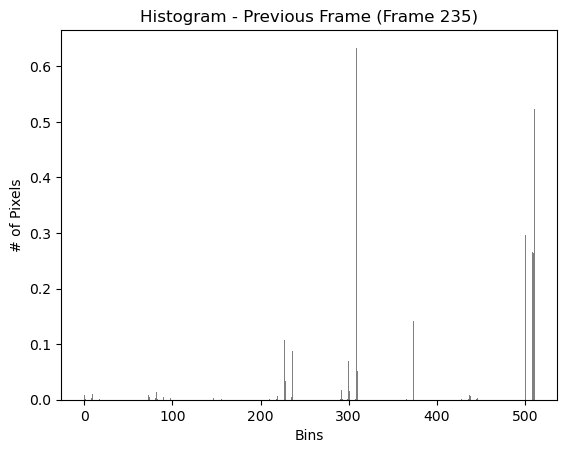

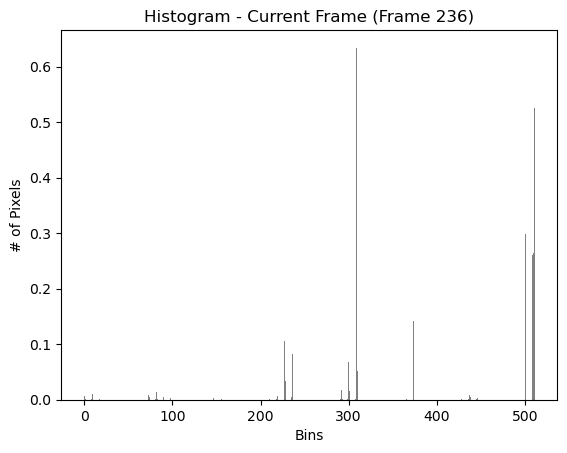

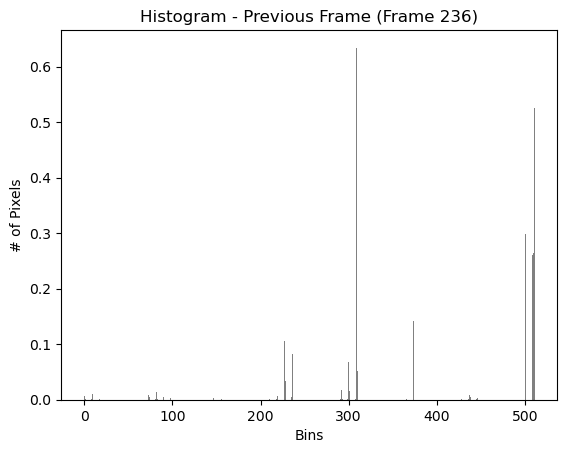

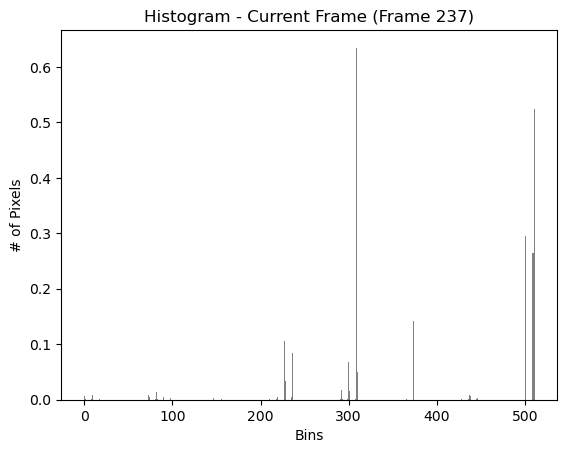

Hard cut detected at frame 238 (Pixel-based)


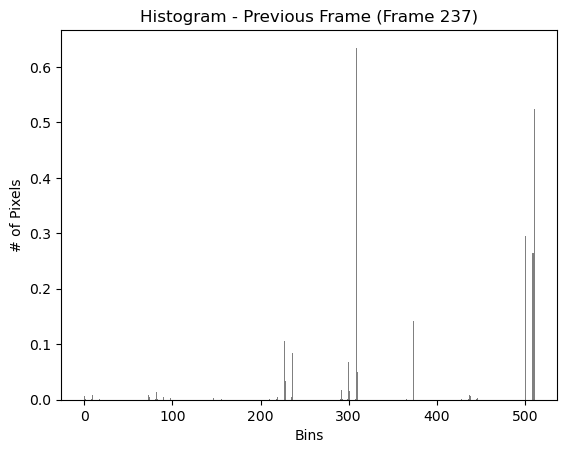

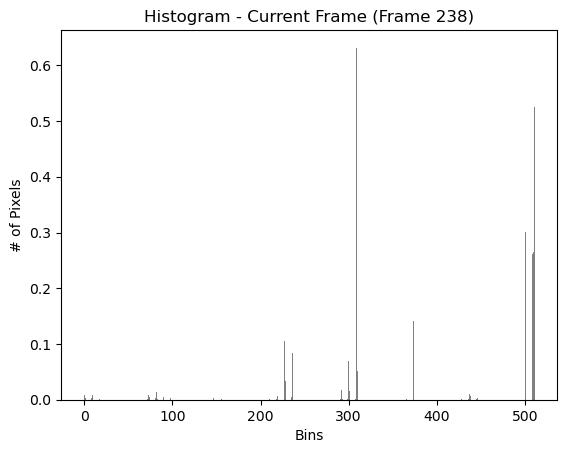

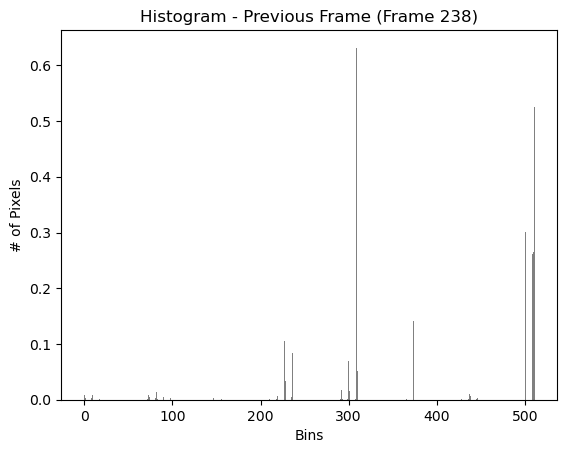

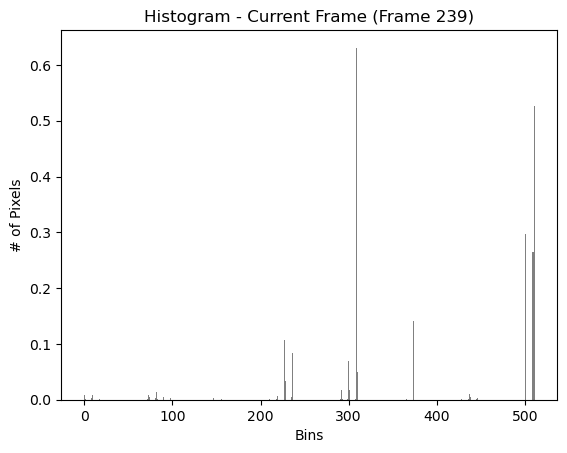

Hard cut detected at frame 240 (Pixel-based)


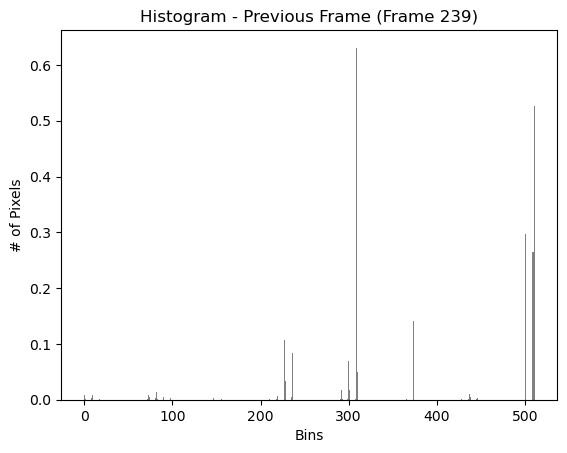

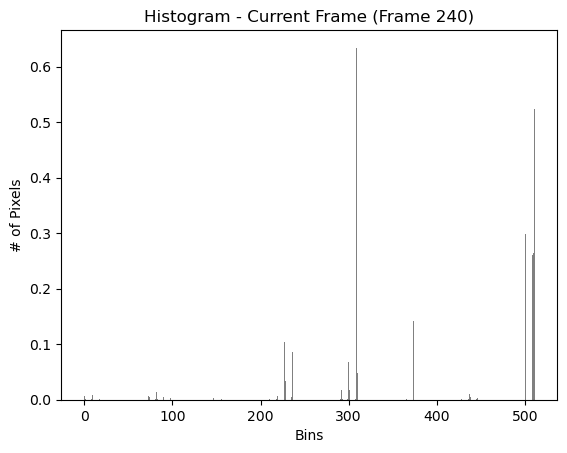

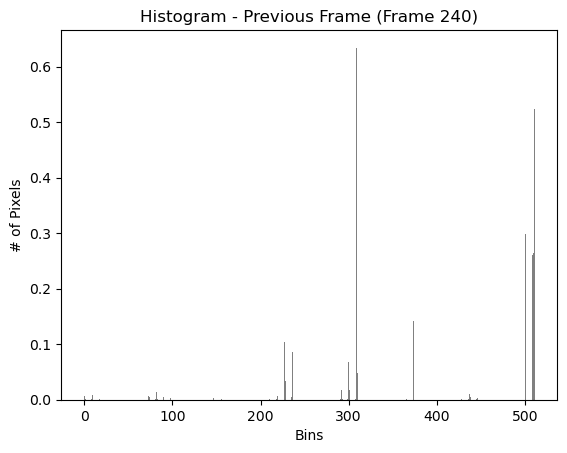

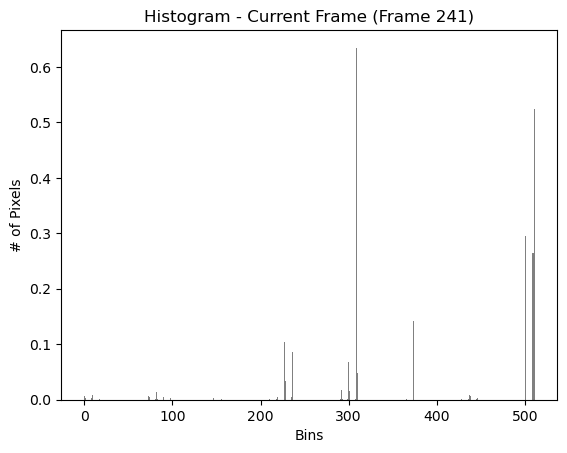

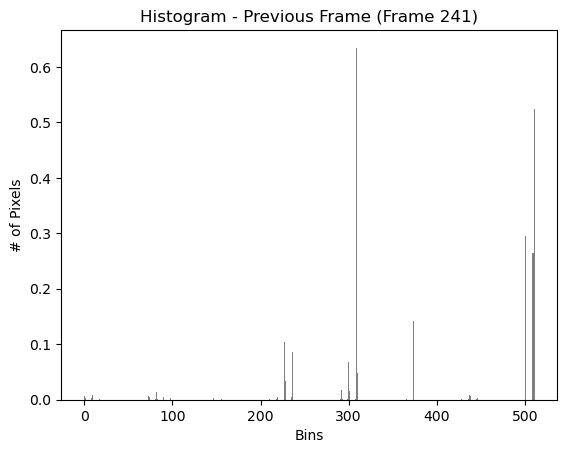

...

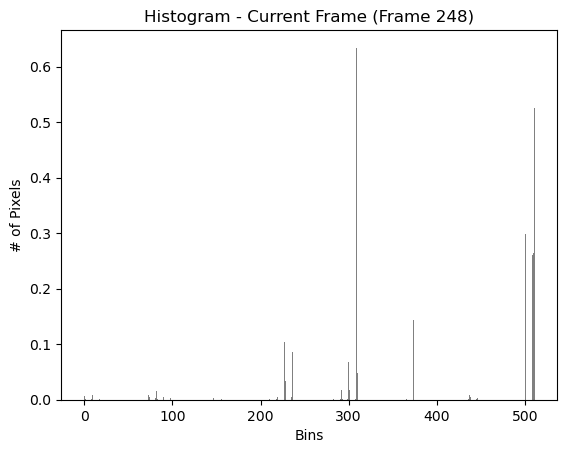

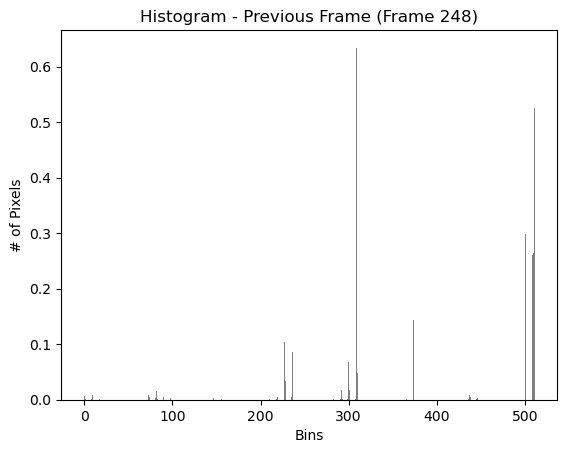

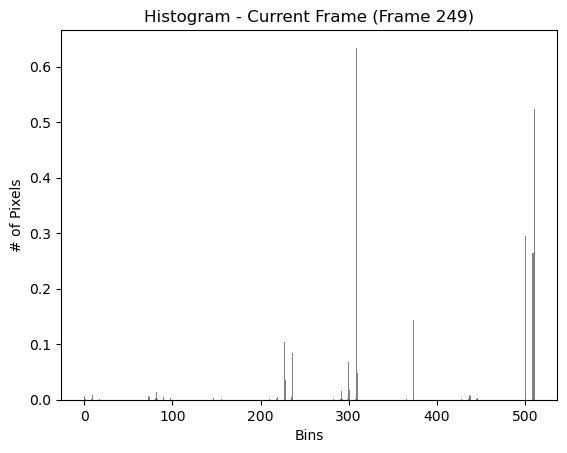

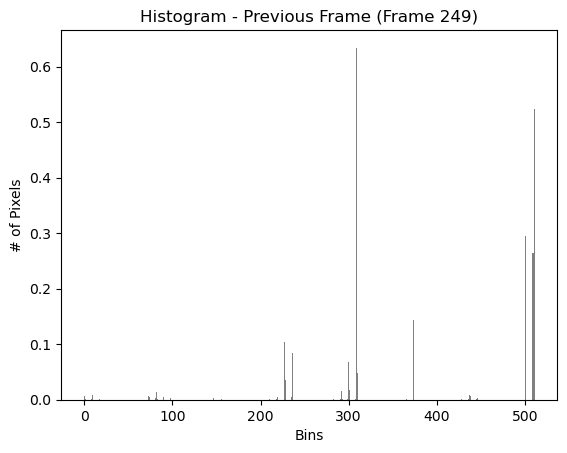

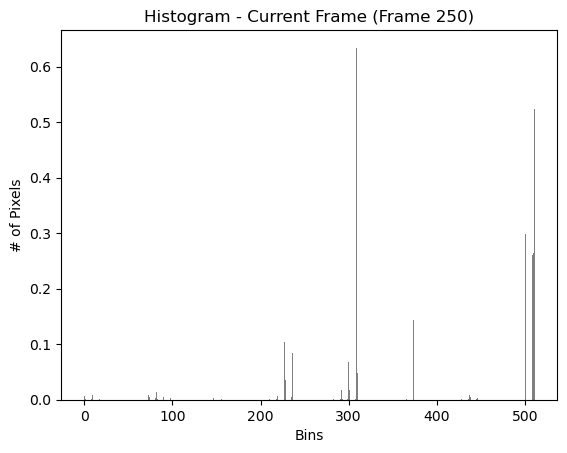

Hard cut detected at frame 251 (Pixel-based)
Hard cut detected at frame 251 (Histogram-based)


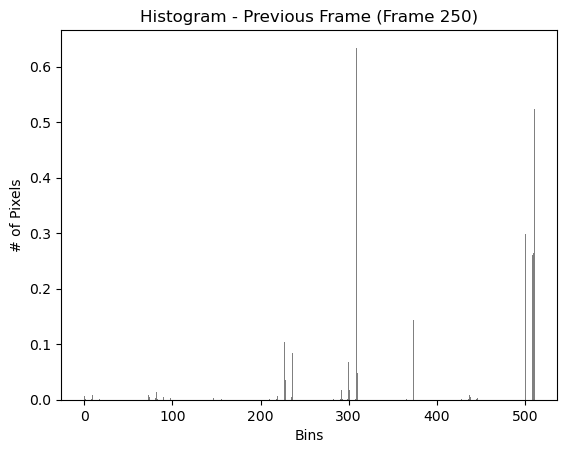

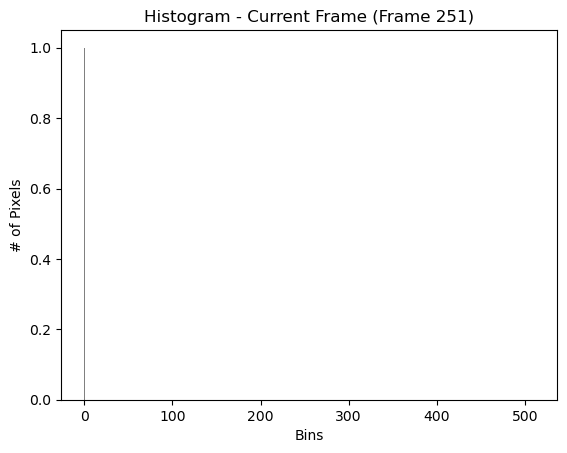

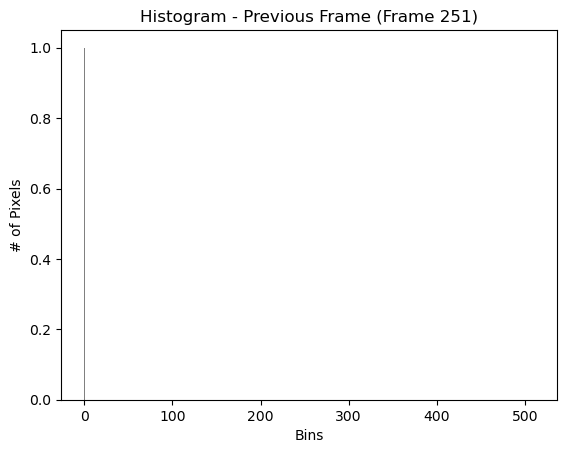

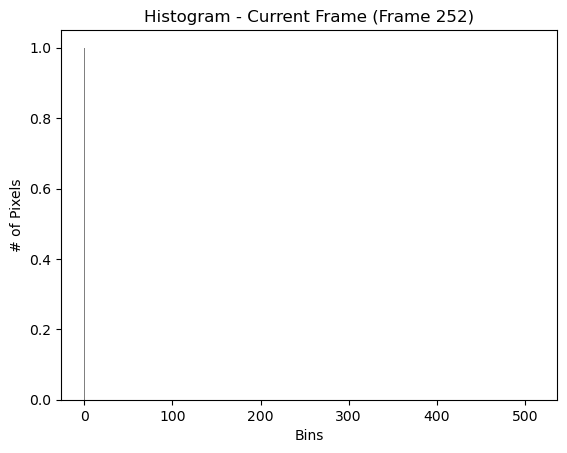

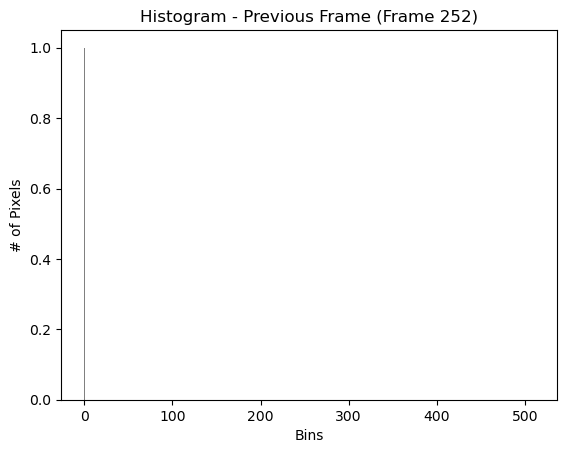

...

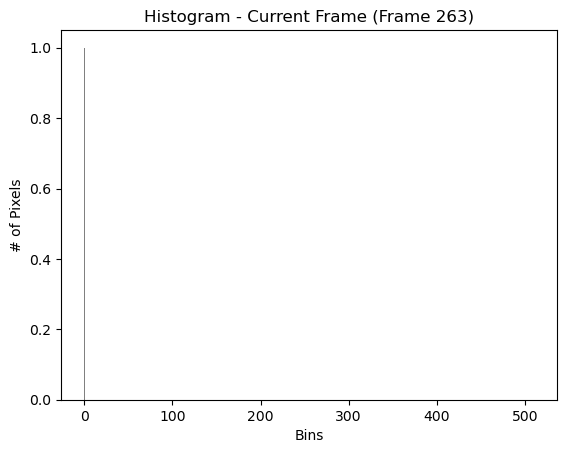

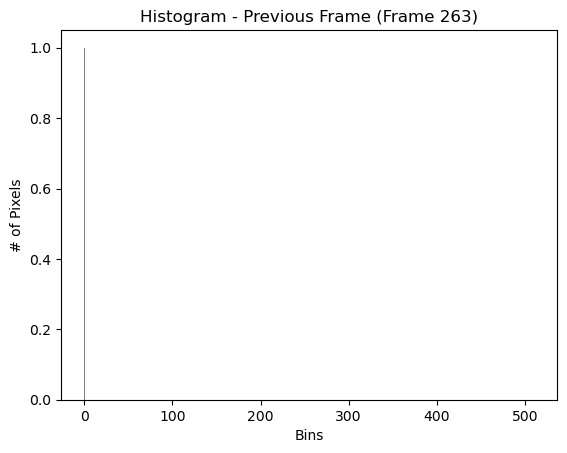

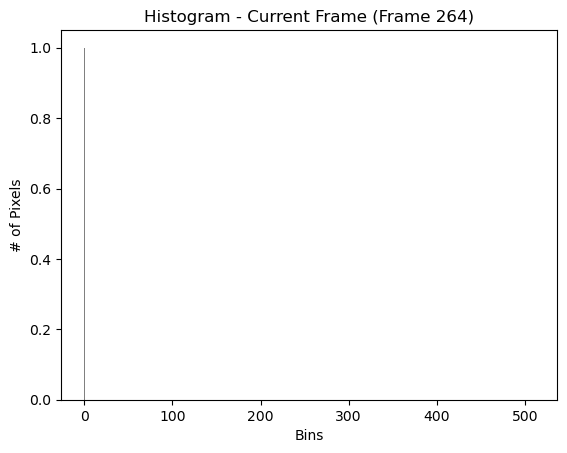

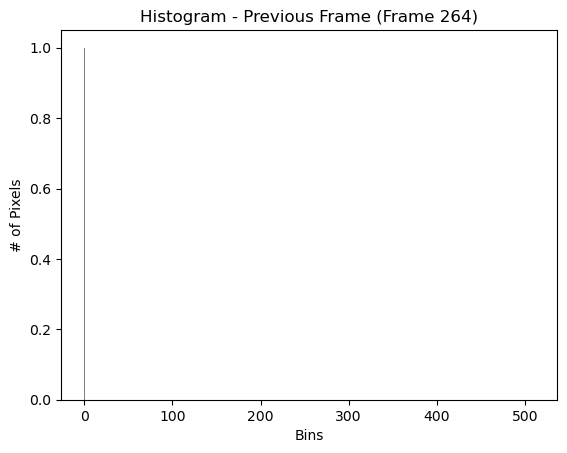

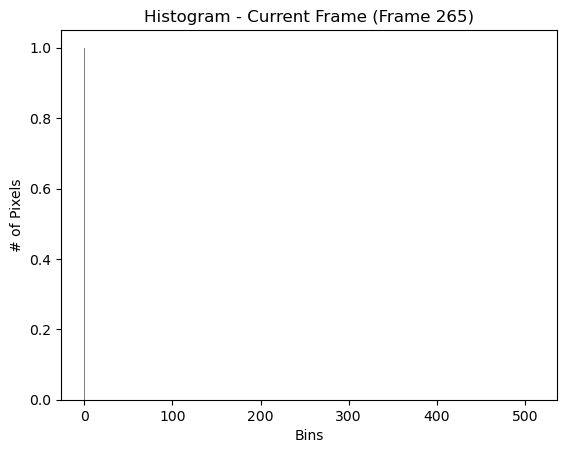

Hard cut detection complete! Processed 266 frames.


In [13]:
import matplotlib.pyplot as plt

# Load the video
cap = cv2.VideoCapture(video_path)

# Thresholds for hard cut detection
pixel_diff_threshold = 500000  # Adjust based on video resolution
hist_diff_threshold = 0.3      # Adjust based on histogram method (lower for high difference)

frame_idx = 0
previous_frame = None

def calculate_histogram(frame):
    """Calculate and normalize the histogram of a frame."""
    hist = cv2.calcHist([frame], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist

def plot_histogram(hist, title):
    """Plot the histogram."""
    plt.figure()
    plt.title(title)
    plt.xlabel("Bins")
    plt.ylabel("# of Pixels")
    
    # Flatten histogram to 1D for plotting
    hist_flattened = hist.flatten()
    plt.bar(range(len(hist_flattened)), hist_flattened, width=0.8, color='gray')
    
    plt.show()

while cap.isOpened():
    ret, current_frame = cap.read()
    if not ret:
        break

    # Convert current frame to grayscale for pixel-based comparison
    gray_current_frame = cv2.cvtColor(current_frame, cv2.COLOR_BGR2GRAY)
    
    if previous_frame is not None:
        ### Pixel-based comparison (frame difference)
        # Calculate absolute difference between consecutive frames
        pixel_diff = cv2.absdiff(previous_frame, gray_current_frame)
        pixel_diff_sum = np.sum(pixel_diff)

        ### Histogram-based comparison
        # Calculate histogram for current and previous frame
        hist_current = calculate_histogram(current_frame)
        hist_previous = calculate_histogram(previous_frame_color)

        # Calculate histogram difference using correlation
        hist_diff = cv2.compareHist(hist_previous, hist_current, cv2.HISTCMP_CORREL)
        
        # Check for hard cuts using pixel-based difference
        if pixel_diff_sum > pixel_diff_threshold:
            print(f"Hard cut detected at frame {frame_idx} (Pixel-based)")

        # Check for hard cuts using histogram-based difference
        if hist_diff < hist_diff_threshold:  # Lower correlation means higher difference
            print(f"Hard cut detected at frame {frame_idx} (Histogram-based)")

        # Plot histograms for visualization
        plot_histogram(hist_previous, f"Histogram - Previous Frame (Frame {frame_idx - 1})")
        plot_histogram(hist_current, f"Histogram - Current Frame (Frame {frame_idx})")

    # Display the current frame (optional)
    cv2.imshow('Current Frame', current_frame)

    # Update previous frame data
    previous_frame = gray_current_frame.copy()
    previous_frame_color = current_frame.copy()

    # Exit on pressing 'q'
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Hard cut detection complete! Processed {frame_idx} frames.")


In [14]:
# Load the video
cap = cv2.VideoCapture(video_path)

# Threshold for soft cut detection
soft_cut_threshold = 0.6  # Adjust based on video content

frame_idx = 0
previous_frame = None
intensity_history = []

while cap.isOpened():
    ret, current_frame = cap.read()
    if not ret:
        break

    # Convert current frame to grayscale
    gray_current_frame = cv2.cvtColor(current_frame, cv2.COLOR_BGR2GRAY)
    
    if previous_frame is not None:
        # Calculate absolute difference between consecutive frames
        pixel_diff = cv2.absdiff(previous_frame, gray_current_frame)

        # Calculate average intensity of the pixel difference
        avg_intensity = np.mean(pixel_diff)

        # Store the average intensity for this frame
        intensity_history.append(avg_intensity)

        # Check for soft cuts based on the average intensity difference
        if len(intensity_history) > 1:
            intensity_change = abs(intensity_history[-1] - intensity_history[-2])
            if intensity_change > soft_cut_threshold:
                print(f"Soft cut detected at frame {frame_idx}")

    # Update previous frame data
    previous_frame = gray_current_frame.copy()

    # Optional: Display the current frame
    cv2.imshow('Current Frame', current_frame)

    # Exit on pressing 'q'
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Soft cut detection complete! Processed {frame_idx} frames.")


Soft cut detected at frame 2
Soft cut detected at frame 3
Soft cut detected at frame 4
Soft cut detected at frame 5
Soft cut detected at frame 6
Soft cut detected at frame 7
Soft cut detected at frame 8
Soft cut detected at frame 9
Soft cut detected at frame 10
Soft cut detected at frame 11
Soft cut detected at frame 12
Soft cut detected at frame 13
Soft cut detected at frame 14
Soft cut detected at frame 15
Soft cut detected at frame 16
Soft cut detected at frame 17
Soft cut detected at frame 18
Soft cut detected at frame 19
Soft cut detected at frame 20
Soft cut detected at frame 21
Soft cut detected at frame 22
Soft cut detected at frame 23
Soft cut detected at frame 24
Soft cut detected at frame 25
Soft cut detected at frame 26
Soft cut detected at frame 27
Soft cut detected at frame 28
Soft cut detected at frame 29
Soft cut detected at frame 30
Soft cut detected at frame 31
Soft cut detected at frame 32
Soft cut detected at frame 33
Soft cut detected at frame 34
Soft cut detected 

In [17]:
# Load the video
cap = cv2.VideoCapture(video_path)

# Thresholds for hard cut and soft cut detection
pixel_diff_threshold = 500000 
hist_diff_threshold = 0.4    
soft_cut_threshold = 0.6      

frame_idx = 0
previous_frame = None
previous_frame_color = None
intensity_history = []

while cap.isOpened():
    ret, current_frame = cap.read()
    if not ret:
        break

    # Convert current frame to grayscale for pixel-based comparison
    gray_current_frame = cv2.cvtColor(current_frame, cv2.COLOR_BGR2GRAY)
    
    if previous_frame is not None:
        ### Pixel-based comparison (frame difference)
        # Calculate absolute difference between consecutive frames
        pixel_diff = cv2.absdiff(previous_frame, gray_current_frame)
        pixel_diff_sum = np.sum(pixel_diff)

        ### Histogram-based comparison
        # Calculate histogram for current and previous frame
        hist_current = cv2.calcHist([current_frame], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        hist_previous = cv2.calcHist([previous_frame_color], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        
        # Normalize histograms
        cv2.normalize(hist_current, hist_current)
        cv2.normalize(hist_previous, hist_previous)

        # Calculate histogram difference using correlation
        hist_diff = cv2.compareHist(hist_previous, hist_current, cv2.HISTCMP_CORREL)
        
        # Check for hard cuts using pixel-based difference
        hard_cut_detected = False
        if pixel_diff_sum > pixel_diff_threshold:
            hard_cut_detected = True
            print(f"Hard cut detected at frame {frame_idx} (Pixel-based)")

        # Check for hard cuts using histogram-based difference
        if hist_diff < hist_diff_threshold:
            hard_cut_detected = True
            print(f"Hard cut detected at frame {frame_idx} (Histogram-based)")

        ### Soft cut detection
        # Calculate average intensity of the pixel difference
        avg_intensity = np.mean(pixel_diff)
        intensity_history.append(avg_intensity)

        if len(intensity_history) > 1:
            intensity_change = abs(intensity_history[-1] - intensity_history[-2])
            if intensity_change > soft_cut_threshold:
                print(f"Soft cut detected at frame {frame_idx}")
                cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 255, 0), 5)
                cv2.putText(current_frame, "Soft Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # Highlight hard cuts
        if hard_cut_detected:
            cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 0, 255), 5)
            cv2.putText(current_frame, "Hard Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Update previous frame data
    previous_frame = gray_current_frame.copy()
    previous_frame_color = current_frame.copy()

    # Display the current frame with highlighted cuts
    cv2.imshow('Current Frame', current_frame)

    # Exit on pressing 'q'
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

print(f"Scene cut detection complete! Processed {frame_idx} frames.")


Hard cut detected at frame 2 (Pixel-based)
Soft cut detected at frame 2
Soft cut detected at frame 3
Hard cut detected at frame 4 (Pixel-based)
Soft cut detected at frame 4
Soft cut detected at frame 5
Hard cut detected at frame 6 (Pixel-based)
Soft cut detected at frame 6
Soft cut detected at frame 7
Hard cut detected at frame 8 (Pixel-based)
Soft cut detected at frame 8
Soft cut detected at frame 9
Hard cut detected at frame 10 (Pixel-based)
Soft cut detected at frame 10
Soft cut detected at frame 11
Hard cut detected at frame 12 (Pixel-based)
Soft cut detected at frame 12
Soft cut detected at frame 13
Hard cut detected at frame 14 (Pixel-based)
Soft cut detected at frame 14
Soft cut detected at frame 15
Hard cut detected at frame 16 (Pixel-based)
Soft cut detected at frame 16
Soft cut detected at frame 17
Hard cut detected at frame 18 (Pixel-based)
Soft cut detected at frame 18
Soft cut detected at frame 19
Hard cut detected at frame 20 (Pixel-based)
Soft cut detected at frame 20
So

In [18]:
# Load the video
cap = cv2.VideoCapture(video_path)

# Thresholds for hard cut and soft cut detection
pixel_diff_threshold = 500000  # Adjust based on video resolution
hist_diff_threshold = 0.4     # Adjust based on histogram method (lower for high difference)
soft_cut_threshold = 0.6         # Adjust based on video content

frame_idx = 0
previous_frame = None
previous_frame_color = None
intensity_history = []

# Lists to store the frame indices of detected cuts
hard_cut_frames = []
soft_cut_frames = []

while cap.isOpened():
    ret, current_frame = cap.read()
    if not ret:
        break

    # Convert current frame to grayscale for pixel-based comparison
    gray_current_frame = cv2.cvtColor(current_frame, cv2.COLOR_BGR2GRAY)
    
    if previous_frame is not None:
        ### Pixel-based comparison (frame difference)
        # Calculate absolute difference between consecutive frames
        pixel_diff = cv2.absdiff(previous_frame, gray_current_frame)
        pixel_diff_sum = np.sum(pixel_diff)

        ### Histogram-based comparison
        # Calculate histogram for current and previous frame
        hist_current = cv2.calcHist([current_frame], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        hist_previous = cv2.calcHist([previous_frame_color], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        
        # Normalize histograms
        cv2.normalize(hist_current, hist_current)
        cv2.normalize(hist_previous, hist_previous)

        # Calculate histogram difference using correlation
        hist_diff = cv2.compareHist(hist_previous, hist_current, cv2.HISTCMP_CORREL)
        
        # Check for hard cuts using pixel-based difference
        hard_cut_detected = False
        if pixel_diff_sum > pixel_diff_threshold:
            hard_cut_detected = True
            hard_cut_frames.append(frame_idx)
            print(f"Hard cut detected at frame {frame_idx} (Pixel-based)")

        # Check for hard cuts using histogram-based difference
        if hist_diff < hist_diff_threshold:
            hard_cut_detected = True
            hard_cut_frames.append(frame_idx)
            print(f"Hard cut detected at frame {frame_idx} (Histogram-based)")

        ### Soft cut detection
        # Calculate average intensity of the pixel difference
        avg_intensity = np.mean(pixel_diff)
        intensity_history.append(avg_intensity)

        if len(intensity_history) > 1:
            intensity_change = abs(intensity_history[-1] - intensity_history[-2])
            if intensity_change > soft_cut_threshold:
                soft_cut_frames.append(frame_idx)
                print(f"Soft cut detected at frame {frame_idx}")
                cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 255, 0), 5)
                cv2.putText(current_frame, "Soft Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # Highlight hard cuts
        if hard_cut_detected:
            cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 0, 255), 5)
            cv2.putText(current_frame, "Hard Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Update previous frame data
    previous_frame = gray_current_frame.copy()
    previous_frame_color = current_frame.copy()

    # Display the current frame with highlighted cuts
    cv2.imshow('Current Frame', current_frame)

    # Exit on pressing 'q'
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

# Display a summary of detected scene boundaries
print("\nSummary of Detected Scene Boundaries:")
print("Hard Cuts Detected at Frames:", hard_cut_frames)
print("Soft Cuts Detected at Frames:", soft_cut_frames)
print(f"Scene cut detection complete! Processed {frame_idx} frames.")


Hard cut detected at frame 2 (Pixel-based)
Soft cut detected at frame 2
Soft cut detected at frame 3
Hard cut detected at frame 4 (Pixel-based)
Soft cut detected at frame 4
Soft cut detected at frame 5
Hard cut detected at frame 6 (Pixel-based)
Soft cut detected at frame 6
Soft cut detected at frame 7
Hard cut detected at frame 8 (Pixel-based)
Soft cut detected at frame 8
Soft cut detected at frame 9
Hard cut detected at frame 10 (Pixel-based)
Soft cut detected at frame 10
Soft cut detected at frame 11
Hard cut detected at frame 12 (Pixel-based)
Soft cut detected at frame 12
Soft cut detected at frame 13
Hard cut detected at frame 14 (Pixel-based)
Soft cut detected at frame 14
Soft cut detected at frame 15
Hard cut detected at frame 16 (Pixel-based)
Soft cut detected at frame 16
Soft cut detected at frame 17
Hard cut detected at frame 18 (Pixel-based)
Soft cut detected at frame 18
Soft cut detected at frame 19
Hard cut detected at frame 20 (Pixel-based)
Soft cut detected at frame 20
So

In [21]:
# Create a directory for saving frames if it doesn't exist
output_directory = 'scene_cut_frames'
os.makedirs(output_directory, exist_ok=True)

# Load the video
cap = cv2.VideoCapture(video_path)

# Thresholds for hard cut and soft cut detection
pixel_diff_threshold = 500000  # Adjust based on video resolution
hist_diff_threshold = 0.4      # Adjust based on histogram method (lower for high difference)
soft_cut_threshold = 0.6        # Adjust based on video content

frame_idx = 0
previous_frame = None
previous_frame_color = None
intensity_history = []

# Lists to store the frame indices of detected cuts and their images
hard_cut_frames = []
soft_cut_frames = []
cut_frames_images = []

while cap.isOpened():
    ret, current_frame = cap.read()
    if not ret:
        break

    # Convert current frame to grayscale for pixel-based comparison
    gray_current_frame = cv2.cvtColor(current_frame, cv2.COLOR_BGR2GRAY)

    if previous_frame is not None:
        ### Pixel-based comparison (frame difference)
        pixel_diff = cv2.absdiff(previous_frame, gray_current_frame)
        pixel_diff_sum = np.sum(pixel_diff)

        ### Histogram-based comparison
        hist_current = cv2.calcHist([current_frame], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        hist_previous = cv2.calcHist([previous_frame_color], [0, 1, 2], None, [8, 8, 8], [0, 256, 0, 256, 0, 256])
        
        # Normalize histograms
        cv2.normalize(hist_current, hist_current)
        cv2.normalize(hist_previous, hist_previous)

        # Calculate histogram difference using correlation
        hist_diff = cv2.compareHist(hist_previous, hist_current, cv2.HISTCMP_CORREL)

        # Check for hard cuts using pixel-based difference
        hard_cut_detected = False
        if pixel_diff_sum > pixel_diff_threshold:
            hard_cut_detected = True
            hard_cut_frames.append(frame_idx)
            cut_frames_images.append(current_frame.copy())  # Store the frame
            print(f"Hard cut detected at frame {frame_idx} (Pixel-based)")

        # Check for hard cuts using histogram-based difference
        if hist_diff < hist_diff_threshold:
            hard_cut_detected = True
            hard_cut_frames.append(frame_idx)
            cut_frames_images.append(current_frame.copy())  # Store the frame
            print(f"Hard cut detected at frame {frame_idx} (Histogram-based)")

        ### Soft cut detection
        avg_intensity = np.mean(pixel_diff)
        intensity_history.append(avg_intensity)

        if len(intensity_history) > 1:
            intensity_change = abs(intensity_history[-1] - intensity_history[-2])
            if intensity_change > soft_cut_threshold:
                soft_cut_frames.append(frame_idx)
                cut_frames_images.append(current_frame.copy())  # Store the frame
                print(f"Soft cut detected at frame {frame_idx}")
                cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 255, 0), 5)
                cv2.putText(current_frame, "Soft Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # Highlight hard cuts
        if hard_cut_detected:
            cv2.rectangle(current_frame, (0, 0), (current_frame.shape[1], current_frame.shape[0]), (0, 0, 255), 5)
            cv2.putText(current_frame, "Hard Cut Detected", (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Update previous frame data
    previous_frame = gray_current_frame.copy()
    previous_frame_color = current_frame.copy()

    # Display the current frame with highlighted cuts
    cv2.imshow('Current Frame', current_frame)

    # Exit on pressing 'q'
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

    frame_idx += 1

cap.release()
cv2.destroyAllWindows()

# Display a summary of detected scene boundaries
print("\nSummary of Detected Scene Boundaries:")
print("Hard Cuts Detected at Frames:", hard_cut_frames)
print("Soft Cuts Detected at Frames:", soft_cut_frames)
print(f"Scene cut detection complete! Processed {frame_idx} frames.")

# Save cut frames and their segmented results
for idx, frame in enumerate(cut_frames_images):
    # Convert the current cut frame to grayscale for segmentation
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    # Apply segmentation (e.g., using color thresholding or edge detection)
    # For demonstration, using Canny edge detection
    edges = cv2.Canny(gray_frame, 100, 200)
    
    # Construct filenames
    original_filename = os.path.join(output_directory, f'cut_frame_{idx + 1}.png')
    segmented_filename = os.path.join(output_directory, f'segmented_frame_{idx + 1}.png')

    # Save original cut frame and its segmentation result
    cv2.imwrite(original_filename, frame)
    cv2.imwrite(segmented_filename, edges)

    print(f"Saved: {original_filename}")
    print(f"Saved: {segmented_filename}")



    # Wait for a key press to continue to the next frame
    cv2.waitKey(0)

cv2.destroyAllWindows()


Hard cut detected at frame 2 (Pixel-based)
Soft cut detected at frame 2
Soft cut detected at frame 3
Hard cut detected at frame 4 (Pixel-based)
Soft cut detected at frame 4
Soft cut detected at frame 5
Hard cut detected at frame 6 (Pixel-based)
Soft cut detected at frame 6
Soft cut detected at frame 7
Hard cut detected at frame 8 (Pixel-based)
Soft cut detected at frame 8
Soft cut detected at frame 9
Hard cut detected at frame 10 (Pixel-based)
Soft cut detected at frame 10
Soft cut detected at frame 11
Hard cut detected at frame 12 (Pixel-based)
Soft cut detected at frame 12
Soft cut detected at frame 13
Hard cut detected at frame 14 (Pixel-based)
Soft cut detected at frame 14
Soft cut detected at frame 15
Hard cut detected at frame 16 (Pixel-based)
Soft cut detected at frame 16
Soft cut detected at frame 17
Hard cut detected at frame 18 (Pixel-based)
Soft cut detected at frame 18
Soft cut detected at frame 19
Hard cut detected at frame 20 (Pixel-based)
Soft cut detected at frame 20
So

Extracted 67 frames
Segmentation completed
Tracked 404 object instances
Identified 5 consistent regions
Consistent regions:
  Region: (0, 0, 64, 20), Persistence: 0.72
  Region: (0, 15, 9, 7), Persistence: 0.45
  Region: (42, 12, 21, 8), Persistence: 0.43
  Region: (0, 15, 64, 20), Persistence: 0.37
  Region: (0, 18, 64, 17), Persistence: 0.28
Detected 1 hard cuts and 0 soft cuts
Hard cut frames: [63]
Soft cut frames: []
Analyzed changes for 62 object instances
Average motion: 342.66
Average shape change: 93861.53
Average object size: 41777.34


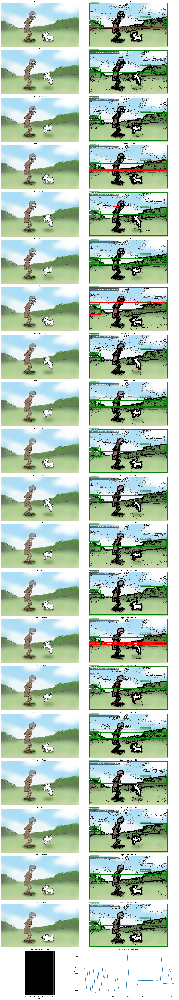

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from sklearn.cluster import KMeans

def load_video(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError(f"Error opening video file: {video_path}")
    return cap

def extract_frames(cap, fps=6):
    frames = []
    frame_count = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        if frame_count % int(cap.get(cv2.CAP_PROP_FPS) / fps) == 0:
            frames.append(frame)
        frame_count += 1
    return frames

def adaptive_color_thresholding(frame):
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    
    s_thresh = cv2.adaptiveThreshold(s, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    v_thresh = cv2.adaptiveThreshold(v, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    
    combined = cv2.bitwise_and(s_thresh, v_thresh)
    return cv2.bitwise_and(frame, frame, mask=combined)

def segment_frames(frames):
    return [adaptive_color_thresholding(frame) for frame in frames]

def track_objects(segmented_frames):
    tracked_objects = []
    for i, frame in enumerate(segmented_frames):
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        _, binary = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        for contour in contours:
            if cv2.contourArea(contour) > 300:  # Increased area threshold to reduce noise
                x, y, w, h = cv2.boundingRect(contour)
                tracked_objects.append((i, x, y, w, h))
    return tracked_objects

def identify_consistent_regions(tracked_objects, num_frames, threshold=0.05, max_regions=5):
    object_counts = {}
    for obj in tracked_objects:
        key = (obj[1] // 10, obj[2] // 10, obj[3] // 10, obj[4] // 10)
        object_counts[key] = object_counts.get(key, 0) + 1
    
    consistent_regions = sorted(
        [(key, count) for key, count in object_counts.items() if count / num_frames >= threshold],
        key=lambda x: x[1],
        reverse=True
    )[:max_regions]
    
    return [(*region, count) for region, count in consistent_regions]

def detect_scene_cuts(frames, threshold=12):
    diffs = []
    scene_cuts = {'hard': [], 'soft': []}
    
    for i in range(1, len(frames)):
        prev_frame = cv2.cvtColor(frames[i-1], cv2.COLOR_BGR2GRAY)
        curr_frame = cv2.cvtColor(frames[i], cv2.COLOR_BGR2GRAY)
        diff = np.mean(cv2.absdiff(prev_frame, curr_frame))
        diffs.append(diff)
        
        if diff > threshold * 2:
            scene_cuts['hard'].append(i)
        elif diff > threshold * 1.5:
            scene_cuts['soft'].append(i)
    
    return scene_cuts, diffs

def analyze_object_changes(tracked_objects):
    object_changes = []
    for i in range(1, len(tracked_objects)):
        prev_obj = tracked_objects[i-1]
        curr_obj = tracked_objects[i]
        if prev_obj[0] + 1 == curr_obj[0]:
            motion = ((curr_obj[1] - prev_obj[1]) * 2 + (curr_obj[2] - prev_obj[2]) * 2) * 0.5
            shape_change = abs((curr_obj[3] * curr_obj[4]) - (prev_obj[3] * prev_obj[4]))
            size = curr_obj[3] * curr_obj[4]
            object_changes.append((curr_obj[0], motion, shape_change, size))
    
    avg_motion = np.mean([change[1] for change in object_changes])
    avg_shape_change = np.mean([change[2] for change in object_changes])
    avg_size = np.mean([change[3] for change in object_changes])
    
    return object_changes, {
        'avg_motion': avg_motion,
        'avg_shape_change': avg_shape_change,
        'avg_size': avg_size
    }


def classify_scene_content(frame):
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    hist = cv2.calcHist([hsv], [0], None, [180], [0, 180])
    dominant_hue = np.argmax(hist)
    
    if 15 <= dominant_hue <= 35:
        
        return 'Outdoor'
    elif 90 <= dominant_hue <= 130:
        return 'Indoor'
    else:
        return 'Action'

def visualize_results(frames, segmented_frames, tracked_objects, scene_cuts, consistent_regions, object_changes):
    num_frames = min(20, len(frames))
    fig, axes = plt.subplots(nrows=num_frames+1, ncols=2, figsize=(20, 5*(num_frames+1)))
    
    if num_frames == 1:
        axes = np.array([axes])
    
    for i in range(num_frames):
        frame_index = min(i, len(frames) - 1)
        axes[i, 0].imshow(cv2.cvtColor(frames[frame_index], cv2.COLOR_BGR2RGB))
        axes[i, 1].imshow(cv2.cvtColor(segmented_frames[frame_index], cv2.COLOR_BGR2RGB))
        
        scene_type = classify_scene_content(frames[frame_index])
        
        if frame_index in scene_cuts['hard']:
            axes[i, 0].set_title(f"Frame {frame_index} - Hard Cut - {scene_type}", color='red', fontweight='bold')
        elif frame_index in scene_cuts['soft']:
            axes[i, 0].set_title(f"Frame {frame_index} - Soft Cut - {scene_type}", color='orange')
        else:
            axes[i, 0].set_title(f"Frame {frame_index} - {scene_type}")
        
        axes[i, 1].set_title(f"Segmented Frame {frame_index}")
        
        for obj in tracked_objects:
            if obj[0] == frame_index:
                x, y, w, h = obj[1:]
                rect = plt.Rectangle((x, y), w, h, fill=False, edgecolor='red', linewidth=1)
                axes[i, 1].add_patch(rect)
        
        for region in consistent_regions:
            x, y, w, h = [coord * 10 for coord in region[:4]]
            rect = plt.Rectangle((x, y), w, h, fill=False, edgecolor='green', linewidth=2)
            axes[i, 1].add_patch(rect)
            axes[i, 1].text(x, y, f"Persistence: {region[4]/len(frames):.2f}", color='white', fontsize=8, bbox=dict(facecolor='green', alpha=0.5))
        
        for change in object_changes:
            if change[0] == frame_index:
                axes[i, 1].text(10, 20, f"Motion: {change[1]:.2f}, Shape Δ: {change[2]:.2f}, Size: {change[3]:.2f}", 
                                color='white', fontsize=8, bbox=dict(facecolor='black', alpha=0.5))
        
        axes[i, 0].axis('off')
        axes[i, 1].axis('off')
    
    timeline = np.zeros((100, len(frames), 3), dtype=np.uint8)
    for i in scene_cuts['hard']:
        timeline[:, i] = [255, 0, 0]  # Red for hard cuts
    for i in scene_cuts['soft']:
        timeline[:, i] = [255, 165, 0]  # Orange for soft cuts
    
    axes[-1, 0].imshow(timeline)
    axes[-1, 0].set_title("Timeline of Scene Cuts")
    axes[-1, 0].set_xlabel("Frames")
    axes[-1, 0].set_yticks([])
    
    motions = [change[1] for change in object_changes]
    axes[-1, 1].plot(range(len(motions)), motions)
    axes[-1, 1].set_title("Object Motion Over Time")
    axes[-1, 1].set_xlabel("Frames")
    axes[-1, 1].set_ylabel("Motion")
    
    plt.tight_layout()
    plt.show()

def main():
    video_path = r"C:\Users\kabir\Downloads\videoplayback.mp4"
    cap = load_video(video_path)
    
    frames = extract_frames(cap)
    print(f"Extracted {len(frames)} frames")
    
    segmented_frames = segment_frames(frames)
    print("Segmentation completed")
    
    tracked_objects = track_objects(segmented_frames)
    print(f"Tracked {len(tracked_objects)} object instances")
    
    consistent_regions = identify_consistent_regions(tracked_objects, len(frames))
    print(f"Identified {len(consistent_regions)} consistent regions")
    print("Consistent regions:")
    for region in consistent_regions:
        print(f"  Region: {region[:4]}, Persistence: {region[4]/len(frames):.2f}")
    
       
    scene_cuts, _ = detect_scene_cuts(frames)
    print(f"Detected {len(scene_cuts['hard'])} hard cuts and {len(scene_cuts['soft'])} soft cuts")
    print(f"Hard cut frames: {scene_cuts['hard']}")
    print(f"Soft cut frames: {scene_cuts['soft']}")
    
    object_changes, change_stats = analyze_object_changes(tracked_objects)
    print(f"Analyzed changes for {len(object_changes)} object instances")
    print(f"Average motion: {change_stats['avg_motion']:.2f}")
    print(f"Average shape change: {change_stats['avg_shape_change']:.2f}")
    print(f"Average object size: {change_stats['avg_size']:.2f}")
    
    visualize_results(frames, segmented_frames, tracked_objects, scene_cuts, consistent_regions, object_changes)
    
    cap.release()

if __name__ == "__main__":
    main()


In [ ]:
import cv2
import os
import numpy as np
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

# Task 1: Load Video and Frame Extraction
def extract_frames(video_path, output_folder='output_frames'):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    video_capture = cv2.VideoCapture(video_path)
    
    if not video_capture.isOpened():
        print("Error: Could not open video.")
        return
    
    frame_count = 0
    while True:
        success, frame = video_capture.read()
        if not success:
            break
        frame_filename = os.path.join(output_folder, f'frame_{frame_count:04d}.jpg')
        cv2.imwrite(frame_filename, frame)
        frame_count += 1
        print(f"Saved {frame_filename}")
    
    video_capture.release()
    print(f"All {frame_count} frames have been extracted and saved.")
    return output_folder

# Task 2: Convert Frames to HSV Color Space
def convert_frames_to_hsv(input_folder, output_hsv_folder='output_hsv_frames'):
    if not os.path.exists(output_hsv_folder):
        os.makedirs(output_hsv_folder)
    
    for frame_filename in sorted(os.listdir(input_folder)):
        frame_path = os.path.join(input_folder, frame_filename)
        frame = cv2.imread(frame_path)

        # Convert frame to HSV color space
        hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # Save the HSV frame
        hsv_frame_filename = os.path.join(output_hsv_folder, frame_filename)
        cv2.imwrite(hsv_frame_filename, hsv_frame)
        print(f"Saved HSV frame: {hsv_frame_filename}")
    
    print("All frames have been converted to HSV and saved.")
    return output_hsv_folder

# Task 3: Spatio-Temporal Segmentation (Object Tracking and Foreground/Background Segmentation)
def background_subtraction_tracking(input_folder, output_fg_folder='output_fg_tracking'):
    if not os.path.exists(output_fg_folder):
        os.makedirs(output_fg_folder)

    # Use BackgroundSubtractorMOG2 for foreground segmentation
    bg_subtractor = cv2.createBackgroundSubtractorMOG2(history=500, varThreshold=16, detectShadows=True)

    for frame_filename in sorted(os.listdir(input_folder)):
        frame_path = os.path.join(input_folder, frame_filename)
        frame = cv2.imread(frame_path)

        # Apply background subtraction
        fg_mask = bg_subtractor.apply(frame)

        # Find contours of the foreground objects
        contours, _ = cv2.findContours(fg_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw bounding boxes around the detected objects
        for contour in contours:
            if cv2.contourArea(contour) > 500:  # Filter out small objects
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Save the foreground tracking frame
        fg_frame_filename = os.path.join(output_fg_folder, frame_filename)
        cv2.imwrite(fg_frame_filename, frame)
        print(f"Saved foreground-tracked frame: {fg_frame_filename}")

    print("Foreground/background segmentation and object tracking completed for all frames.")
    return output_fg_folder

# Task 4: Scene Cut Detection with Hard and Soft Cut
def compute_similarity_scores(hsv_frames_folder, histograms_folder='output_histograms', similarity_scores_file='similarity_scores.txt'):
    if not os.path.exists(histograms_folder):
        os.makedirs(histograms_folder)

    frame_filenames = sorted(os.listdir(hsv_frames_folder))
    similarity_scores = []

    def sobel_edge_detection(image):
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
        sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
        sobel_edges = np.sqrt(sobel_x**2 + sobel_y**2)
        return sobel_edges

    for i in range(len(frame_filenames) - 1):
        frame1_path = os.path.join(hsv_frames_folder, frame_filenames[i])
        frame2_path = os.path.join(hsv_frames_folder, frame_filenames[i + 1])

        frame1 = cv2.imread(frame1_path)
        frame2 = cv2.imread(frame2_path)

        gray_frame1 = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
        gray_frame2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)

        score_ssim, _ = ssim(gray_frame1, gray_frame2, full=True)

        intensity_diff = np.mean(np.abs(gray_frame1.astype("float") - gray_frame2.astype("float")))

        sobel_frame1 = sobel_edge_detection(frame1)
        sobel_frame2 = sobel_edge_detection(frame2)

        sobel_diff = np.mean(np.abs(sobel_frame1 - sobel_frame2))

        hist1_value = cv2.calcHist([frame1], [2], None, [60], [0, 256])
        hist2_value = cv2.calcHist([frame2], [2], None, [60], [0, 256])

        hist1_value = cv2.normalize(hist1_value, hist1_value).flatten()
        hist2_value = cv2.normalize(hist2_value, hist2_value).flatten()

        intersection_value = np.minimum(hist1_value, hist2_value).sum()
        total_pixels_value = hist1_value.sum() + hist2_value.sum()
        similarity_score_value = intersection_value / total_pixels_value if total_pixels_value != 0 else 0

        combined_similarity_score = (score_ssim + (1 - intensity_diff/255) + (1 - sobel_diff/255) + similarity_score_value) / 4
        similarity_scores.append((frame_filenames[i], frame_filenames[i + 1], combined_similarity_score))

        plt.figure()
        plt.plot(hist1_value, color='b', label='Value (Brightness)')
        plt.title(f'Value Histogram of {frame_filenames[i]}')
        plt.xlabel('Bins')
        plt.ylabel('Frequency')
        plt.legend()

        histogram_filename = os.path.join(histograms_folder, f'histogram_{frame_filenames[i]}.png')
        plt.savefig(histogram_filename)
        plt.close()

        print(f"Saved histogram for {frame_filenames[i]} and combined similarity score: {combined_similarity_score}")

    with open(similarity_scores_file, 'w') as f:
        for frame1, frame2, score in similarity_scores:
            f.write(f'{frame1} - {frame2}: {score}\n')

    print("All similarity calculations done, and similarity scores stored.")
    return similarity_scores_file

# Task 5: Mark Scene Cuts based on Similarity Scores (Hard and Soft Cuts)
def detect_scene_cuts_from_similarity(similarity_scores_file, input_folder, scene_cut_folder='scene_cut_frames', hard_threshold=0.4, soft_threshold=0.7):
    if not os.path.exists(scene_cut_folder):
        os.makedirs(scene_cut_folder)

    cut_detected = []
    
    with open(similarity_scores_file, 'r') as f:
        lines = f.readlines()

    for line in lines:
        frame_pair, score = line.strip().split(':')
        frame1, frame2 = frame_pair.split('-')
        score = float(score.strip())

        # Hard Cut Detection
        if score < hard_threshold:
            print(f"Hard Scene cut detected between {frame1} and {frame2} with similarity score: {score}")
            
            frame1_path = os.path.join(input_folder, frame1.strip())
            frame2_path = os.path.join(input_folder, frame2.strip())
            
            frame1_img = cv2.imread(frame1_path)
            frame2_img = cv2.imread(frame2_path)

            cv2.imwrite(os.path.join(scene_cut_folder, f'hard_cut_{frame1.strip()}'), frame1_img)
            cv2.imwrite(os.path.join(scene_cut_folder, f'hard_cut_{frame2.strip()}'), frame2_img)
            
            cut_detected.append((frame1.strip(), frame2.strip(), "Hard"))

        # Soft Cut Detection
        elif score < soft_threshold:
            print(f"Soft Scene transition detected between {frame1} and {frame2} with similarity score: {score}")
            
            frame1_path = os.path.join(input_folder, frame1.strip())
            frame2_path = os.path.join(input_folder, frame2.strip())
            
            frame1_img = cv2.imread(frame1_path)
            frame2_img = cv2.imread(frame2_path)

            cv2.imwrite(os.path.join(scene_cut_folder, f'soft_cut_{frame1.strip()}'), frame1_img)
            cv2.imwrite(os.path.join(scene_cut_folder, f'soft_cut_{frame2.strip()}'), frame2_img)
            
            cut_detected.append((frame1.strip(), frame2.strip(), "Soft"))

    return cut_detected

# Task 6: Result Visualization (Scene Cut Frames)
def visualize_scene_cuts(scene_cut_folder):
    for frame_filename in sorted(os.listdir(scene_cut_folder)):
        frame_path = os.path.join(scene_cut_folder, frame_filename)
        frame = cv2.imread(frame_path)
        cv2.imshow(f'Scene Cut - {frame_filename}', frame)
        cv2.waitKey(0)
    cv2.destroyAllWindows()

# Pipeline execution
video_path = r"C:\Users\kabir\Downloads\videoplayback.mp4"
frame_folder = extract_frames(video_path)

# HSV frame conversion
hsv_folder = convert_frames_to_hsv(frame_folder)

# Spatio-temporal segmentation and object tracking (foreground/background)
tracking_folder = background_subtraction_tracking(frame_folder)

# Compute similarity scores using Sobel edges, SSIM, pixel intensity, and histogram comparisons
similarity_scores_file = compute_similarity_scores(hsv_folder)

# Detect scene cuts and save the detected frames (hard and soft cuts)
scene_cuts = detect_scene_cuts_from_similarity(similarity_scores_file, frame_folder)

# Visualize scene cut frames
visualize_scene_cuts('scene_cut_frames')

#print("Processing complete.")


Saved output_frames\frame_0000.jpg
Saved output_frames\frame_0001.jpg
Saved output_frames\frame_0002.jpg
Saved output_frames\frame_0003.jpg
Saved output_frames\frame_0004.jpg
Saved output_frames\frame_0005.jpg
Saved output_frames\frame_0006.jpg
Saved output_frames\frame_0007.jpg
Saved output_frames\frame_0008.jpg
Saved output_frames\frame_0009.jpg
Saved output_frames\frame_0010.jpg
Saved output_frames\frame_0011.jpg
Saved output_frames\frame_0012.jpg
Saved output_frames\frame_0013.jpg
Saved output_frames\frame_0014.jpg
Saved output_frames\frame_0015.jpg
Saved output_frames\frame_0016.jpg
Saved output_frames\frame_0017.jpg
Saved output_frames\frame_0018.jpg
Saved output_frames\frame_0019.jpg
Saved output_frames\frame_0020.jpg
Saved output_frames\frame_0021.jpg
Saved output_frames\frame_0022.jpg
Saved output_frames\frame_0023.jpg
Saved output_frames\frame_0024.jpg
Saved output_frames\frame_0025.jpg
Saved output_frames\frame_0026.jpg
Saved output_frames\frame_0027.jpg
Saved output_frames\